# pycisTopic analysis

Full dataset, using consensus peak regions.

In [1]:
import pycisTopic
pycisTopic.__version__

'0.1.dev300+g7494158'

In [2]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [3]:
import pickle
import pandas as pd

In [4]:
import os
wdir = '/staging/leuven/stg_00002/lcb/cflerin/analysis/pbmc_atac/analysis2/data_freeze_Jun2021/atac_qc_multiplet_merged/jupyter/'
os.chdir( wdir )

In [5]:
# create output directory:
f_final_dir = os.path.join(wdir, 'downstream_analysis')
if not os.path.exists(f_final_dir):
    os.makedirs(f_final_dir)

In [6]:
import re

sample_annot = pd.DataFrame(
    [
        ['Broad_1','BioRad'],
        ['Broad_2','BioRad'],
        ['Stanford_1','10x v1.0'],
        ['Stanford_2','10x v1.0'],
        ['VIB_1','10x v1.0'],
        ['VIB_2','10x v1.0'],
        ['CNAG_1','10x v1.1'],
        ['CNAG_2','10x v1.1'],
        ['Broad_mito_1','mito-scATAC-seq'],
        ['Broad_mito_2','mito-scATAC-seq'],
        ['Sanger_1','10x multiome'],
        ['Sanger_2','10x multiome'],
        ['s3atac','s3-ATAC'],
    ],
    columns=['key','Technology']
)
sample_annot['Sample'] = sample_annot['key']
sample_annot.set_index('key', drop=False, inplace=True)
# rename samples:
sample_annot.loc['Broad_1','Sample'] = 'Harvard_1'
sample_annot.loc['Broad_2','Sample'] = 'Harvard_2'
sample_annot.loc['Broad_mito_1','Sample'] = 'Broad_1'
sample_annot.loc['Broad_mito_2','Sample'] = 'Broad_2'
sample_annot.loc['s3atac','Sample'] = 'OHSU'

sample_annot['Replicate'] = [ x.Sample.split('_')[-1] for i,x in sample_annot.iterrows() ]
sample_annot['st'] = [ re.sub('_[0-9]','',x.Sample)+' ('+x.Technology+')' for i,x in sample_annot.iterrows() ]

sample_annot.loc[sample_annot['key']=='s3atac','Replicate'] = 1
sample_map = { x: y.Sample for x,y in sample_annot.iterrows() }
sample_annot

,key,Technology,Sample,Replicate,st
key,,,,,
Broad_1,Broad_1,BioRad,Harvard_1,1,Harvard (BioRad)
Broad_2,Broad_2,BioRad,Harvard_2,2,Harvard (BioRad)
Stanford_1,Stanford_1,10x v1.0,Stanford_1,1,Stanford (10x v1.0)
Stanford_2,Stanford_2,10x v1.0,Stanford_2,2,Stanford (10x v1.0)
VIB_1,VIB_1,10x v1.0,VIB_1,1,VIB (10x v1.0)
VIB_2,VIB_2,10x v1.0,VIB_2,2,VIB (10x v1.0)
CNAG_1,CNAG_1,10x v1.1,CNAG_1,1,CNAG (10x v1.1)
CNAG_2,CNAG_2,10x v1.1,CNAG_2,2,CNAG (10x v1.1)
Broad_mito_1,Broad_mito_1,mito-scATAC-seq,Broad_1,1,Broad (mito-scATAC-seq)


---

## Load the cisTopic objects
For each sample: using the sample-specific peaks
For the merged set: using the merged consensus peaks

In [7]:
# Valid barcodes
with open(wdir + 'barcodes_passing_filters2.pkl', 'rb') as f:
    bc_passing_filters = pickle.load(f)

In [8]:
f_cto_dir = 'cistopic_objs__consensus_peaks'
if not os.path.exists(os.path.join(wdir, f_cto_dir)):
    os.makedirs(os.path.join(wdir, f_cto_dir))

In [9]:
f_cto_merged_dir = 'cistopic_objs__consensus_peaks_merged'
if not os.path.exists(os.path.join(wdir, f_cto_dir)):
    os.makedirs(os.path.join(wdir, f_cto_dir))

In [10]:
# load objects into dict:
cistopic_obj_dict = {}
for key in bc_passing_filters.keys():
    f_out = os.path.join(wdir, f_cto_dir, key + '__cistopic_obj.pkl')
    with open(f_out, 'rb') as f:
        tmp_cto = pickle.load(f)
    cistopic_obj_dict[key] = tmp_cto
    print(f"Loaded {key}")

# add the merged object:
f_out = os.path.join(wdir, f_cto_merged_dir, 'fulldata_merged__cistopic_obj.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        cistopic_obj_dict['merged'] = pickle.load(f)

Loaded Broad_1
Loaded Broad_2
Loaded Broad_mito_1
Loaded Broad_mito_2
Loaded CNAG_1
Loaded CNAG_2
Loaded s3atac
Loaded Sanger_1
Loaded Sanger_2
Loaded Stanford_1
Loaded Stanford_2
Loaded VIB_1
Loaded VIB_2
Loading /staging/leuven/stg_00002/lcb/cflerin/analysis/pbmc_atac/analysis2/data_freeze_Jun2021/atac_qc_multiplet_merged/jupyter/cistopic_objs__consensus_peaks_merged/fulldata_merged__cistopic_obj.pkl


In [11]:
for key in cistopic_obj_dict.keys():
    print(cistopic_obj_dict[key])

CistopicObject from project Broad_1 with n_cells × n_regions = 3921 × 159511
CistopicObject from project Broad_2 with n_cells × n_regions = 3839 × 139640
CistopicObject from project Broad_mito_1 with n_cells × n_regions = 3349 × 210225
CistopicObject from project Broad_mito_2 with n_cells × n_regions = 3210 × 196411
CistopicObject from project CNAG_1 with n_cells × n_regions = 2533 × 163896
CistopicObject from project CNAG_2 with n_cells × n_regions = 2561 × 154159
CistopicObject from project s3atac with n_cells × n_regions = 3045 × 471502
CistopicObject from project Sanger_1 with n_cells × n_regions = 2833 × 267206
CistopicObject from project Sanger_2 with n_cells × n_regions = 3443 × 267757
CistopicObject from project Stanford_1 with n_cells × n_regions = 749 × 214119
CistopicObject from project Stanford_2 with n_cells × n_regions = 1375 × 215119
CistopicObject from project VIB_1 with n_cells × n_regions = 2739 × 177643
CistopicObject from project VIB_2 with n_cells × n_regions = 693

## Add cell annotations

In [12]:
cellannot = pd.read_csv(
    '/staging/leuven/stg_00002/lcb/cflerin/analysis/pbmc_atac/analysis2/data_freeze_Jun2021/atac_qc_multiplet_merged/jupyter/fulldata_filtered_cell_data.tsv',
    sep='\t', index_col=0)
cellannot

,cisTopic_nr_frag,cisTopic_log_nr_frag,cisTopic_nr_acc,cisTopic_log_nr_acc,sample_id,Log_total_nr_frag,Log_unique_nr_frag,Total_nr_frag,Unique_nr_frag,Dupl_nr_frag,...,barcode,fmx_droplet_type,fmx_sample,Doublet_scores_fragments,Predicted_doublets_fragments,seurat_cell_type,seurat_cell_type_pred_score,pycisTopic_leiden_10_0.6,pycisTopic_leiden_10_0.8,consensus_cell_type
TAGTGTTGTGGCGCGAGCGTG_GGCAGGCTGGCAACCTTCATC-Broad_1,11533,4.061942,10427,4.018159,Broad_1,4.449586,4.015527,28157,10364,17793,...,TAGTGTTGTGGCGCGAGCGTG_GGCAGGCTGGCAACCTTCATC,SNG,sampleA,0.235127,False,CD4+ T cell,0.610633,1,0,CD4+ T cell
CTTGCGAGTGGTAGTCTTGTA_GGTCGTAGCACAGCCATCTTA_TTATCATTCAGCAATACCGAA-Broad_1,12804,4.107346,11432,4.058122,Broad_1,4.633650,4.097743,43018,12524,30494,...,CTTGCGAGTGGTAGTCTTGTA_GGTCGTAGCACAGCCATCTTA_TT...,SNG,sampleB,0.074550,False,CD14+ monocyte,0.983182,11,8,CD14+ monocyte
AATTCCAACCGGCTCTAACTC_GGCGTCCTAAGAGGACCATGC_GCTAATTTGGAAGGCTGCGCC-Broad_1,3848,3.585235,3614,3.557988,Broad_1,3.983807,3.602277,9634,4002,5632,...,AATTCCAACCGGCTCTAACTC_GGCGTCCTAAGAGGACCATGC_GC...,SNG,sampleA,0.056856,False,CD4+ T cell,0.878514,1,0,CD4+ T cell
GCGCACGCGCAATCTAAGAGG_GCAGTGTCGGATCTGGTTAGT_CAGAATTCACTTCTCGGATCT-Broad_1,9395,3.972897,8372,3.922829,Broad_1,4.466779,3.903144,29294,8001,21293,...,GCGCACGCGCAATCTAAGAGG_GCAGTGTCGGATCTGGTTAGT_CA...,SNG,sampleA,0.139579,False,Cytotoxic T cell,0.549764,3,14,Cytotoxic T cell
CCGGTTTACCTACCCGGTACG_CTCATTTTTATCATAGCAACG_AACGTAATGGCAACCACATGA-Broad_1,9201,3.963835,8419,3.925261,Broad_1,4.425828,3.954243,26658,9000,17658,...,CCGGTTTACCTACCCGGTACG_CTCATTTTTATCATAGCAACG_AA...,SNG,sampleA,0.054705,False,CD16+ monocyte,0.558353,11,8,CD14+ monocyte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGTACGATCTAGCAAC-VIB_2,2906,3.463296,2788,3.445293,VIB_2,3.757624,3.650113,5723,4468,1255,...,TGTACGATCTAGCAAC,SNG,sampleA,0.095982,False,CD14+ monocyte,0.681409,0,1,CD14+ monocyte
TGCATTTAGGAAGGTA-VIB_2,3641,3.561221,3525,3.547159,VIB_2,3.832637,3.720573,6802,5255,1547,...,TGCATTTAGGAAGGTA,SNG,sampleA,0.042274,False,CD14+ monocyte,0.656442,0,1,CD16+ monocyte
AATACGCGTATCTCAG-VIB_2,3633,3.560265,3514,3.545802,VIB_2,3.913231,3.814447,8189,6523,1666,...,AATACGCGTATCTCAG,SNG,sampleB,0.077833,False,CD14+ monocyte,0.684051,23,1,CD14+ monocyte
TTGGTCCCAACACGGA-VIB_2,2340,3.369216,2291,3.360025,VIB_2,3.649530,3.568905,4462,3706,756,...,TTGGTCCCAACACGGA,SNG,sampleB,0.051875,False,CD14+ monocyte,0.665843,0,1,CD14+ monocyte


In [13]:
for key in cistopic_obj_dict.keys():
    cistopic_obj_dict[key].add_cell_data(
        cellannot[['consensus_cell_type','seurat_cell_type','fmx_sample',
                   'TSS_enrichment','FRIP','Unique_nr_frag','Log_unique_nr_frag','Dupl_rate']]
    )

### Read in LDA/mallett models

In [14]:
from pycisTopic.lda_models import evaluate_models
import matplotlib.pyplot as plt

In [15]:
n_iter = 500

In [16]:
f_mod_dir = 'models__consensus__mallet'

models_dict = {}
for key in cistopic_obj_dict.keys():
    f_mod = os.path.join(wdir, f_mod_dir, key + '__models_' + str(n_iter) + '_iter.pkl')
    if(os.path.isfile(f_mod)):
        with open(f_mod, 'rb') as f:
            models_dict[key] = pickle.load(f)
        print(f"Loaded {key}")

Loaded Broad_1
Loaded Broad_2
Loaded Broad_mito_1
Loaded Broad_mito_2
Loaded CNAG_1
Loaded CNAG_2
Loaded s3atac
Loaded Sanger_1
Loaded Sanger_2
Loaded Stanford_1
Loaded Stanford_2
Loaded VIB_1
Loaded VIB_2
Loaded merged


In [17]:
model_selection = {
    'Broad_1': 40,#30,
    'Broad_2': 40,#35,
    'Broad_mito_1': 30,#25,
    'Broad_mito_2': 30,#30,
    'CNAG_1': 45,#30,
    'CNAG_2': 40,#35,
    's3atac': 45,
    'Sanger_1': 40,
    'Sanger_2': 45,
    'Stanford_1': 50,
    'Stanford_2': 50,
    'VIB_1': 45,#35,
    'VIB_2': 50,#45,
    'merged': 90
}

Broad_1


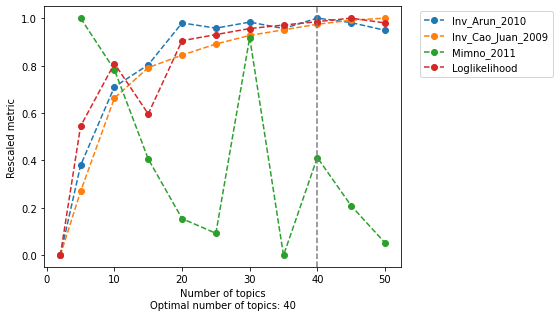

Broad_2


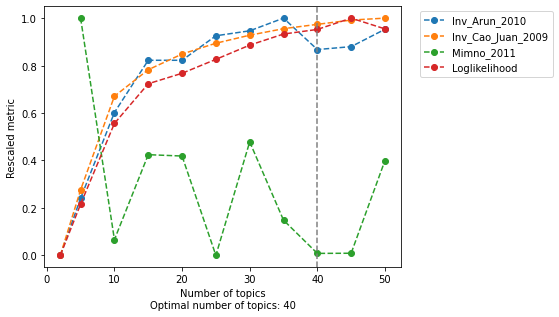

Broad_mito_1


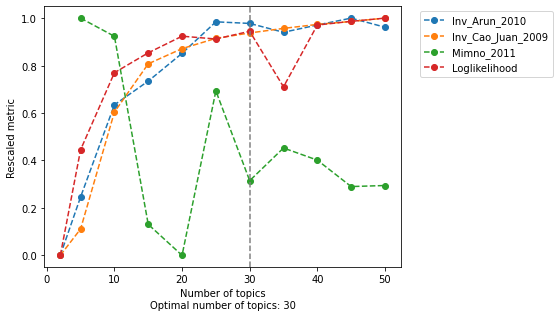

Broad_mito_2


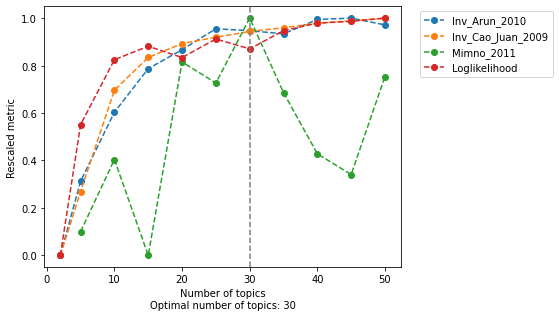

CNAG_1


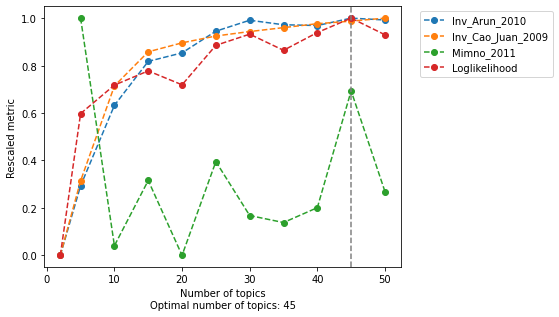

CNAG_2


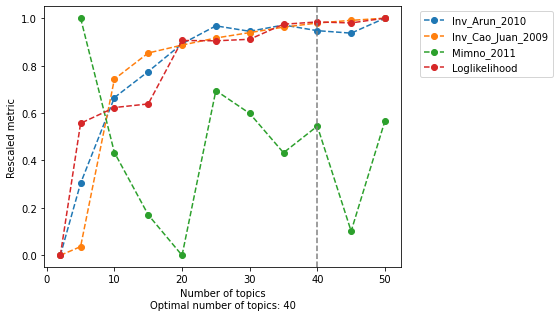

s3atac


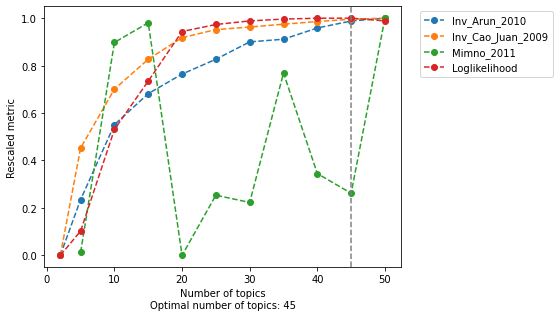

Sanger_1


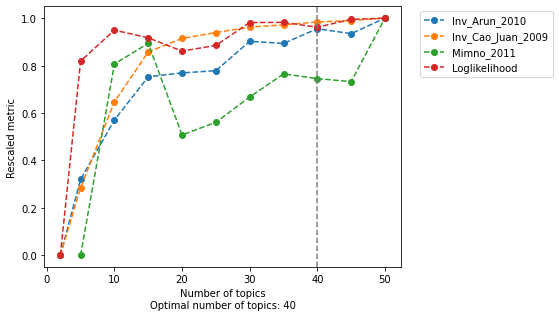

Sanger_2


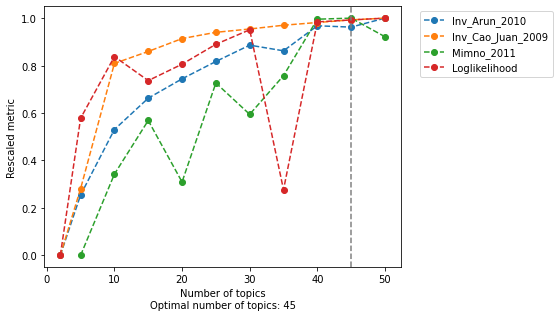

Stanford_1


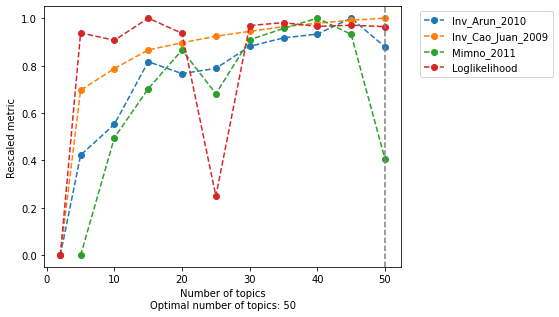

Stanford_2


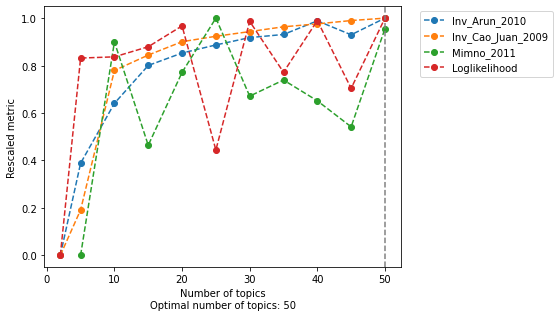

VIB_1


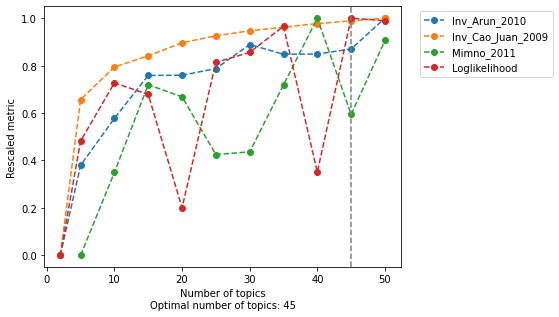

VIB_2


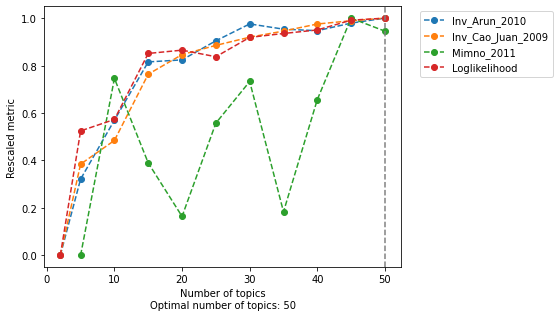

merged


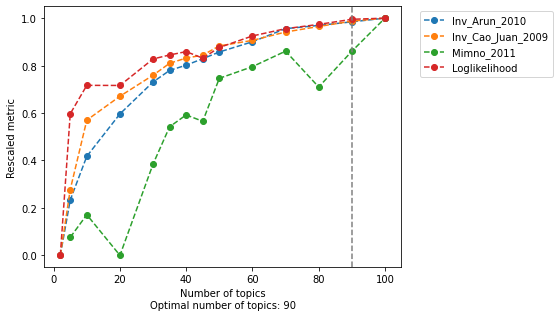

In [18]:
for key in models_dict.keys():
    print(key)
    model=evaluate_models(models_dict[key],
                         select_model=model_selection[key], 
                         return_model=True, 
                         metrics=['Arun_2010','Cao_Juan_2009', 'Minmo_2011', 'loglikelihood'],
                         plot=True,
                         plot_metrics=False
                         )
    cistopic_obj_dict[key].add_LDA_model(model)

## Visualizations

In [19]:
from pycisTopic.clust_vis import (
    find_clusters,
    run_umap,
    run_tsne,
    plot_metadata,
    plot_topic,
    cell_topic_heatmap
)

In [20]:
for key in cistopic_obj_dict.keys():
    find_clusters(cistopic_obj_dict[key],
              target  = 'cell',
              k = 10,
              res = [0.6, 0.8, 1.0],
              prefix = 'pycisTopic_')
    cistopic_obj_dict[key].projections['cell'] = {}
    run_umap(cistopic_obj_dict[key], target = 'cell')
    run_tsne(cistopic_obj_dict[key], target = 'cell')

2021-09-24 20:48:57,464 cisTopic     INFO     Finding neighbours
2021-09-24 20:48:58,024 cisTopic     INFO     Running UMAP
2021-09-24 20:49:16,531 cisTopic     INFO     Running FItSNE
Will use momentum during exaggeration phase
Computing input similarities...
Using perplexity, so normalizing input data (to prevent numerical problems)
Using perplexity, not the manually set kernel width.  K (number of nearest neighbors) and sigma (bandwidth) parameters are going to be ignored.
Using ANNOY for knn search, with parameters: n_trees 50 and search_k 4500
Going to allocate memory. N: 3921, K: 90, N*K = 352890
Building Annoy tree...
Done building tree. Beginning nearest neighbor search... 
parallel (36 threads):
2021-09-24 20:49:31,951 cisTopic     INFO     Finding neighbours
2021-09-24 20:49:32,472 cisTopic     INFO     Running UMAP==>] 99% 0.045s
2021-09-24 20:49:46,303 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input si

Broad_1


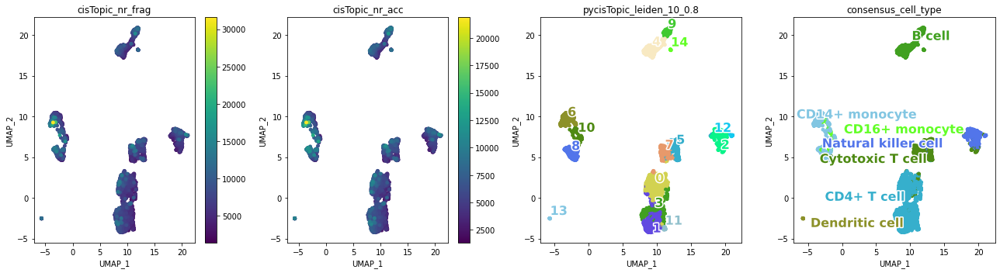

Broad_2


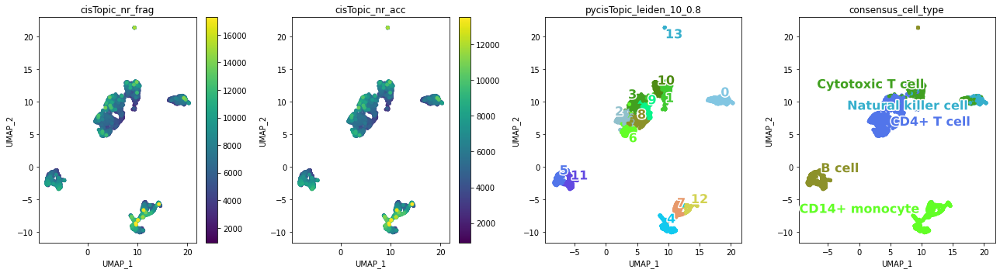

Broad_mito_1


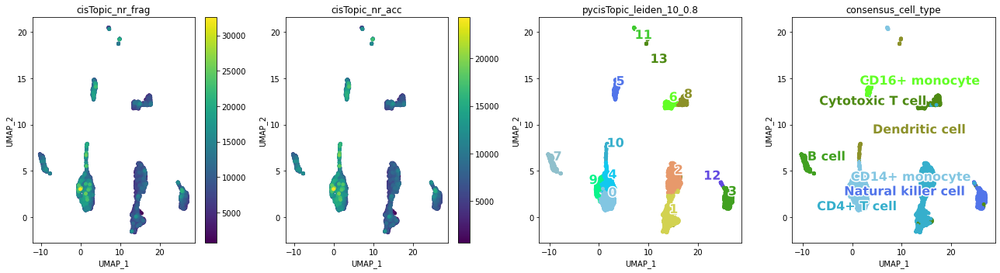

Broad_mito_2


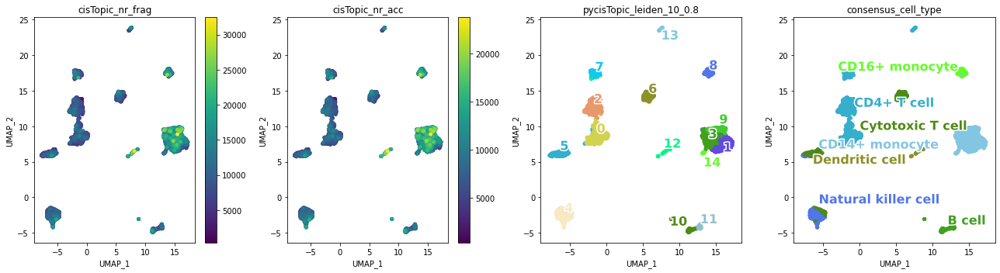

CNAG_1


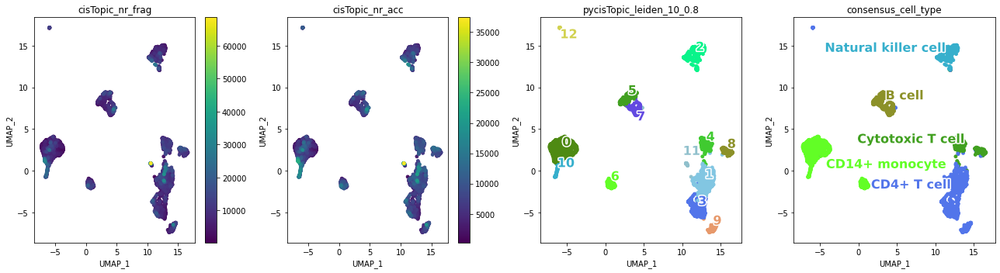

CNAG_2


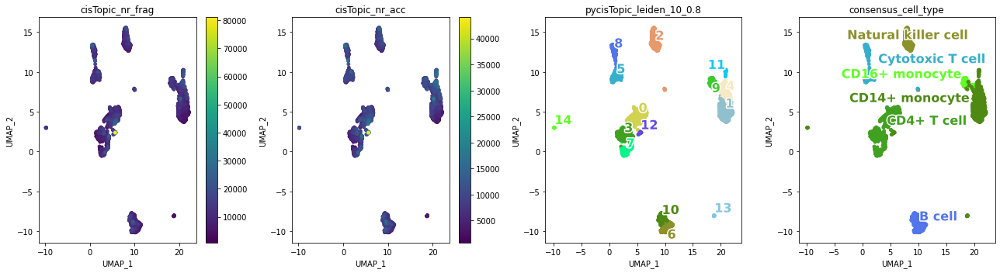

s3atac


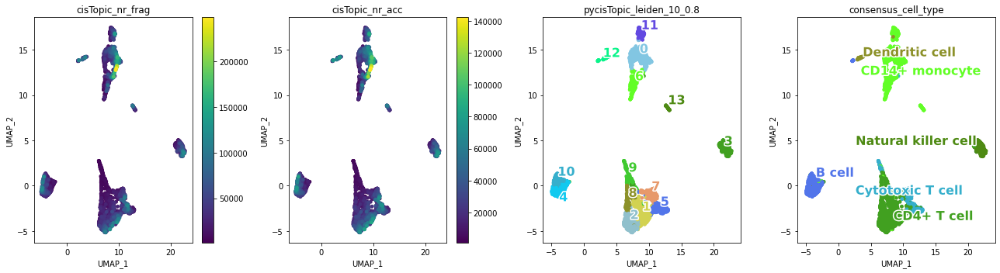

Sanger_1


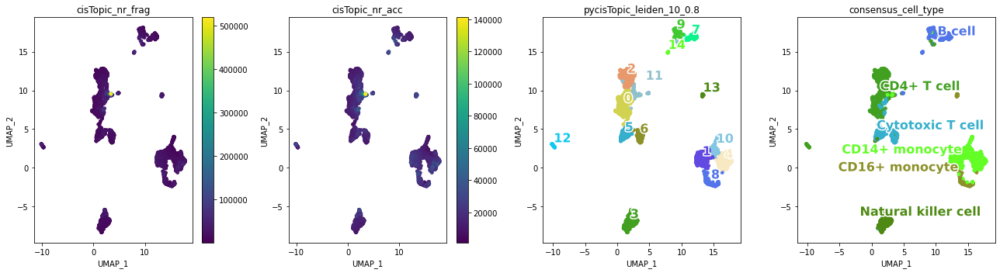

Sanger_2


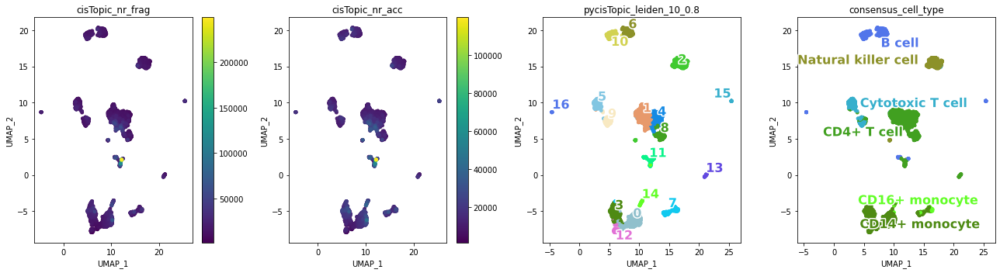

Stanford_1


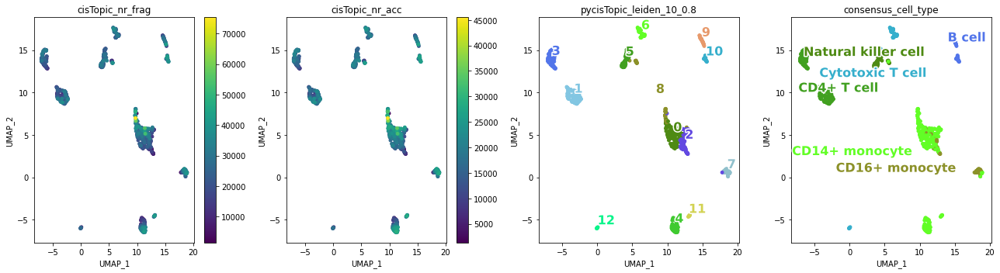

Stanford_2


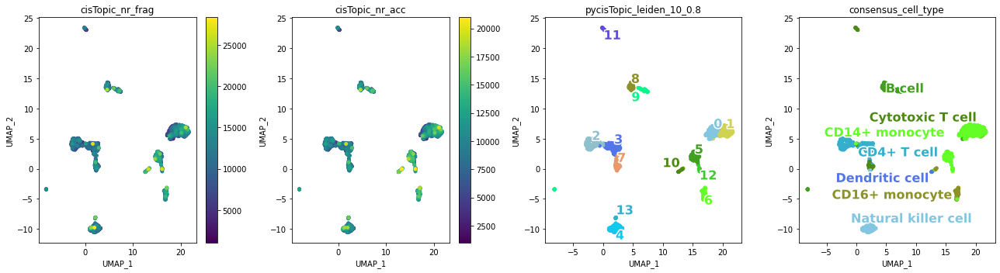

VIB_1


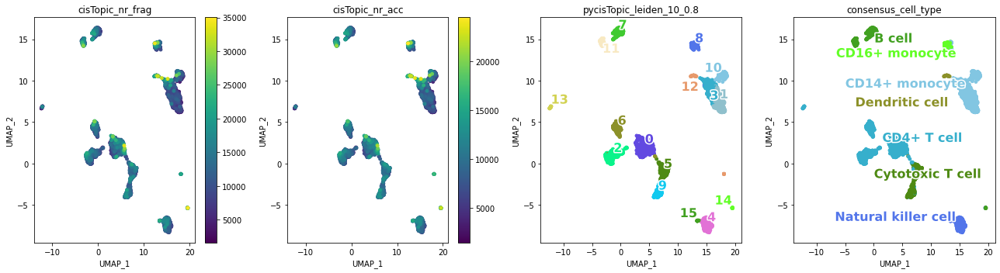

VIB_2


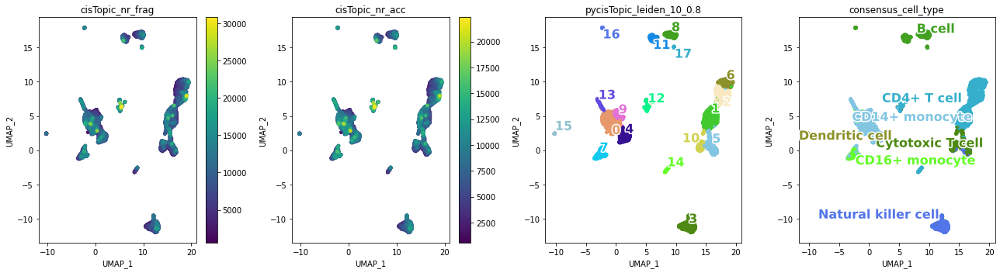

merged


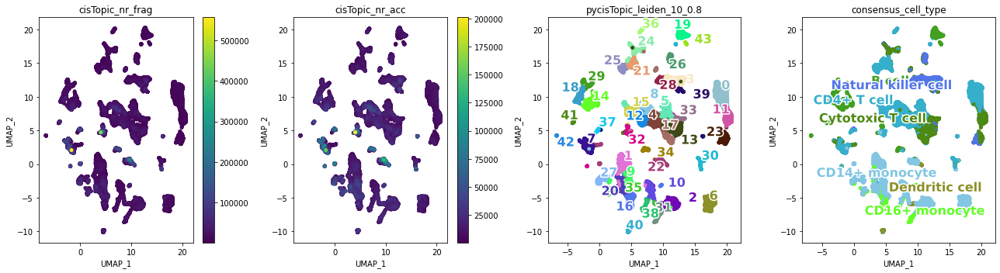

In [21]:
for key in cistopic_obj_dict.keys():
    print(key)
    plot_metadata(cistopic_obj_dict[key],
                  reduction_name='UMAP',
#                   variables=['Unique_nr_frag', 'TSS_enrichment', 'Dupl_rate', 'FRIP',
#                              'Doublet_scores_fragments', 'fmx_sample', 'pycisTopic_leiden_10_0.6', 'seurat_cell_type'],
                  variables=['cisTopic_nr_frag', 'cisTopic_nr_acc',
                             'pycisTopic_leiden_10_0.8', 'consensus_cell_type'],
                  target='cell',
                  num_columns=4,
                  text_size=16,
                  dot_size=15,
                  figsize=(18,5),
                 )

Broad_1


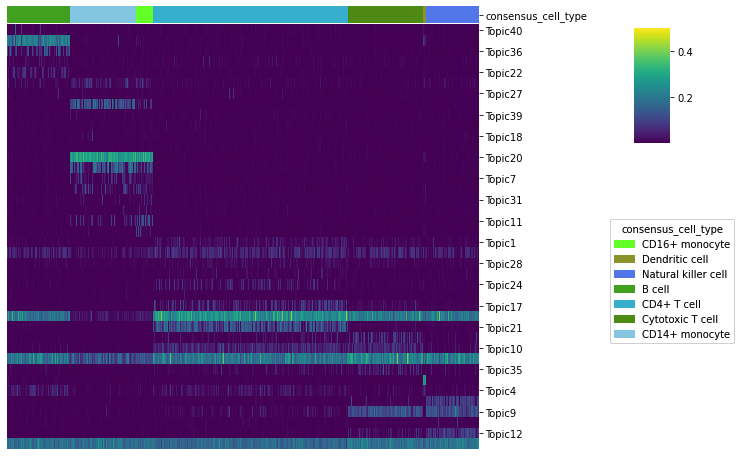

Broad_2


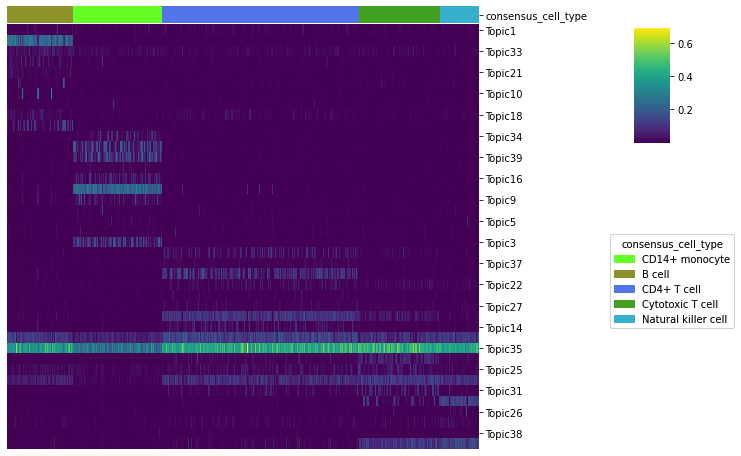

Broad_mito_1


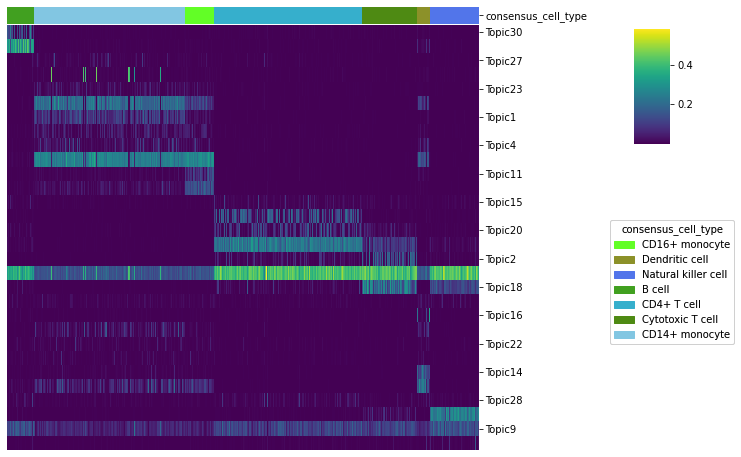

Broad_mito_2


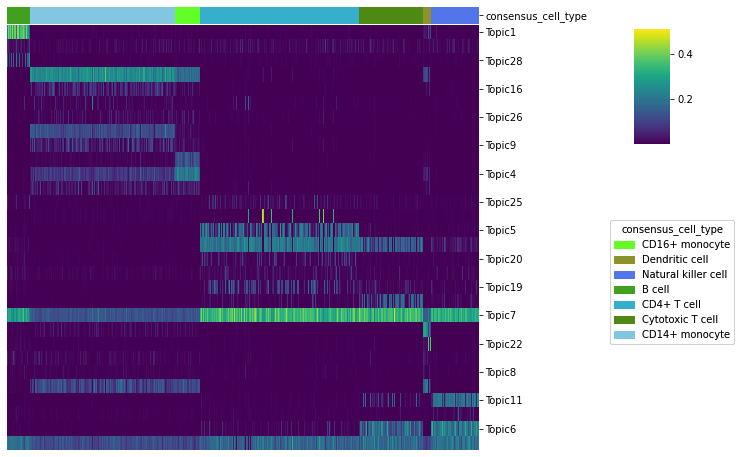

CNAG_1


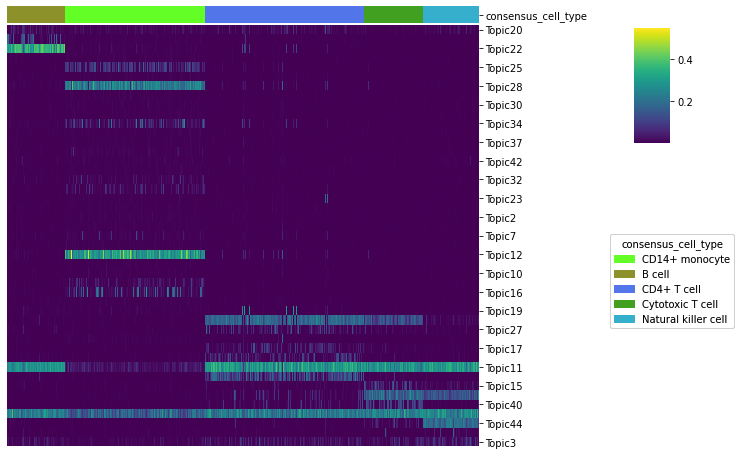

CNAG_2


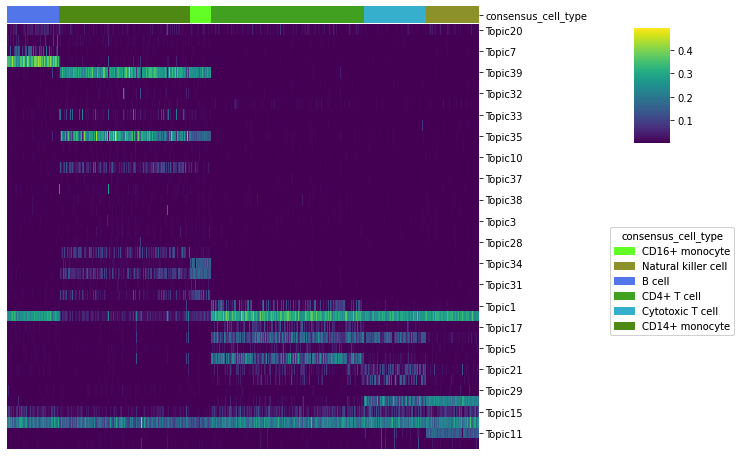

s3atac


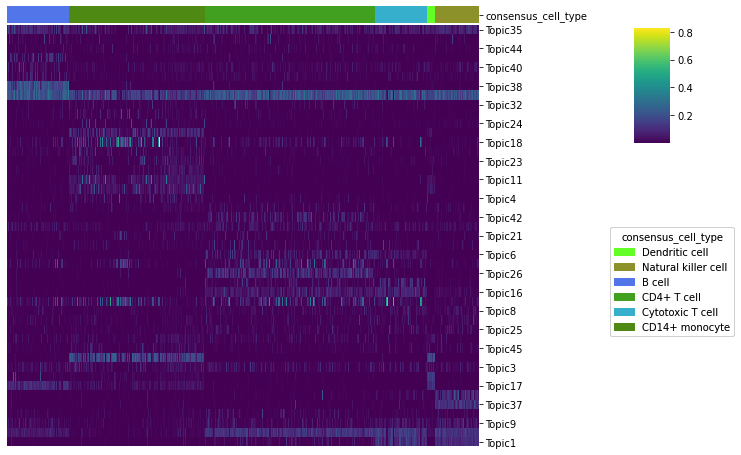

Sanger_1


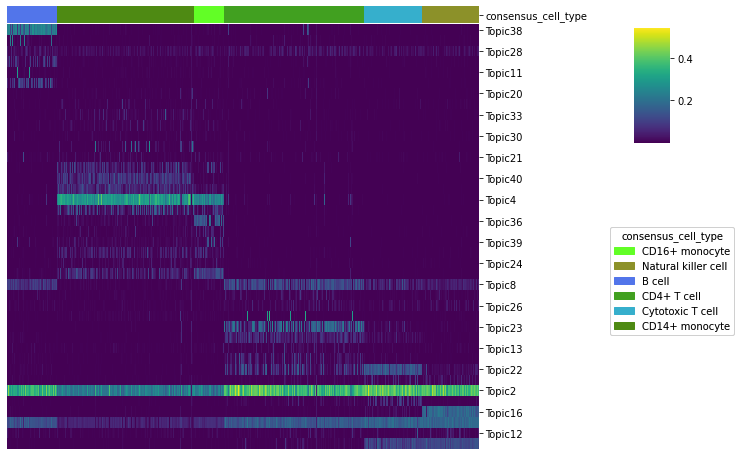

Sanger_2


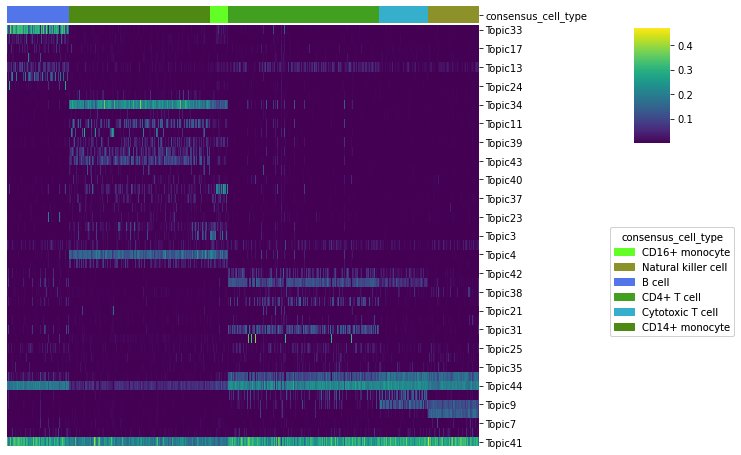

Stanford_1


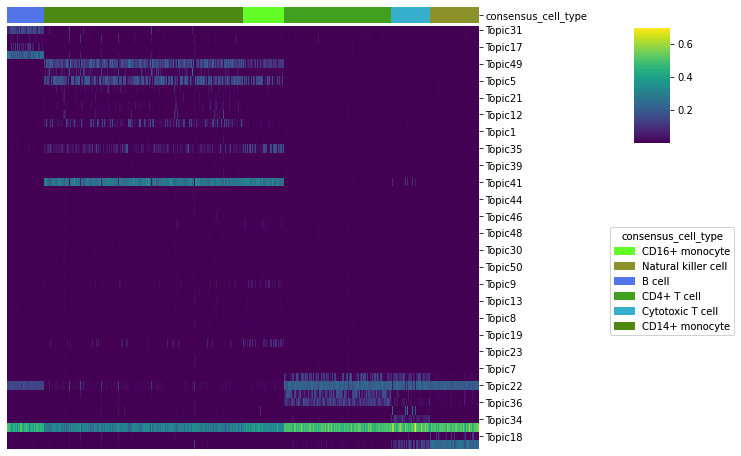

Stanford_2


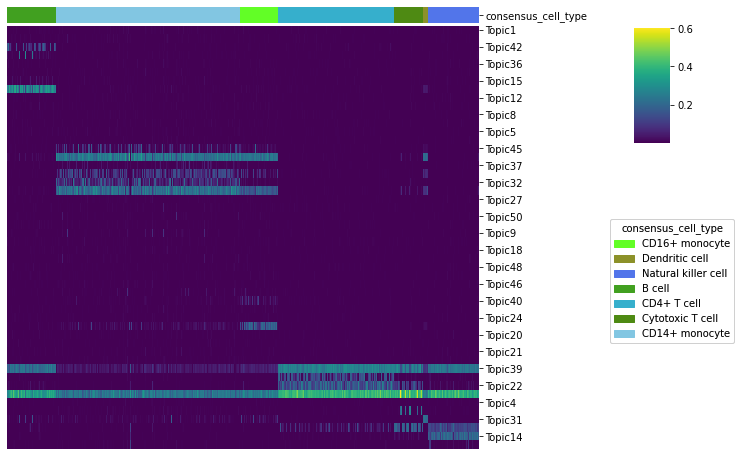

VIB_1


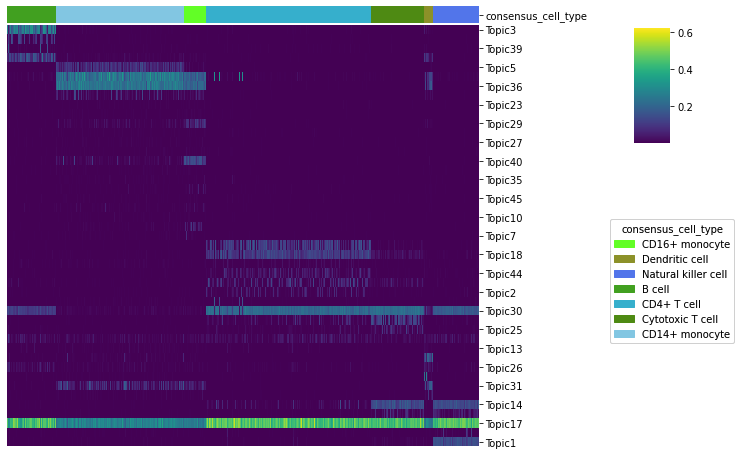

VIB_2


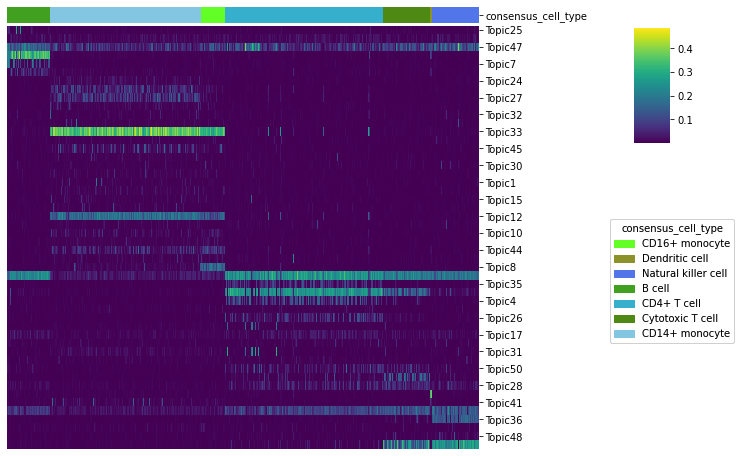

merged


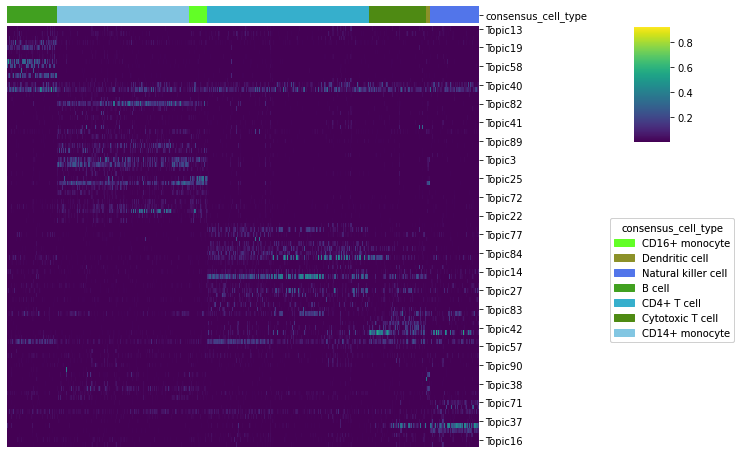

In [22]:
for key in cistopic_obj_dict.keys():
    print(key)
    cell_topic_heatmap(cistopic_obj_dict[key],
                     variables = ['consensus_cell_type'],
                     scale = False,
                     legend_loc_x = 1.05,
                     legend_loc_y = -1.2,
                     legend_dist_y = -1,
                     figsize=(10,8),
                     )

## Batch effect correction with Harmony

In [23]:
from pycisTopic.clust_vis import harmony

In [24]:
harmony(cistopic_obj_dict['merged'],
        'sample_id',
        random_state=555,
        max_iter_harmony=20
       )

2021-09-24 20:57:45,560 - harmonypy - INFO - Iteration 1 of 20


2021-09-24 20:57:45,560 harmonypy    INFO     Iteration 1 of 20


2021-09-24 20:57:56,876 - harmonypy - INFO - Iteration 2 of 20


2021-09-24 20:57:56,876 harmonypy    INFO     Iteration 2 of 20


2021-09-24 20:58:08,436 - harmonypy - INFO - Iteration 3 of 20


2021-09-24 20:58:08,436 harmonypy    INFO     Iteration 3 of 20


2021-09-24 20:58:19,748 - harmonypy - INFO - Iteration 4 of 20


2021-09-24 20:58:19,748 harmonypy    INFO     Iteration 4 of 20


2021-09-24 20:58:31,118 - harmonypy - INFO - Iteration 5 of 20


2021-09-24 20:58:31,118 harmonypy    INFO     Iteration 5 of 20


2021-09-24 20:58:42,382 - harmonypy - INFO - Iteration 6 of 20


2021-09-24 20:58:42,382 harmonypy    INFO     Iteration 6 of 20


2021-09-24 20:58:53,773 - harmonypy - INFO - Iteration 7 of 20


2021-09-24 20:58:53,773 harmonypy    INFO     Iteration 7 of 20


2021-09-24 20:59:05,113 - harmonypy - INFO - Iteration 8 of 20


2021-09-24 20:59:05,113 harmonypy    INFO     Iteration 8 of 20


2021-09-24 20:59:16,495 - harmonypy - INFO - Iteration 9 of 20


2021-09-24 20:59:16,495 harmonypy    INFO     Iteration 9 of 20


2021-09-24 20:59:23,111 - harmonypy - INFO - Iteration 10 of 20


2021-09-24 20:59:23,111 harmonypy    INFO     Iteration 10 of 20


2021-09-24 20:59:27,402 - harmonypy - INFO - Iteration 11 of 20


2021-09-24 20:59:27,402 harmonypy    INFO     Iteration 11 of 20


2021-09-24 20:59:31,734 - harmonypy - INFO - Iteration 12 of 20


2021-09-24 20:59:31,734 harmonypy    INFO     Iteration 12 of 20


2021-09-24 20:59:36,030 - harmonypy - INFO - Iteration 13 of 20


2021-09-24 20:59:36,030 harmonypy    INFO     Iteration 13 of 20


2021-09-24 20:59:40,478 - harmonypy - INFO - Iteration 14 of 20


2021-09-24 20:59:40,478 harmonypy    INFO     Iteration 14 of 20


2021-09-24 20:59:44,691 - harmonypy - INFO - Iteration 15 of 20


2021-09-24 20:59:44,691 harmonypy    INFO     Iteration 15 of 20


2021-09-24 20:59:49,015 - harmonypy - INFO - Iteration 16 of 20


2021-09-24 20:59:49,015 harmonypy    INFO     Iteration 16 of 20


2021-09-24 20:59:53,302 - harmonypy - INFO - Iteration 17 of 20


2021-09-24 20:59:53,302 harmonypy    INFO     Iteration 17 of 20


2021-09-24 20:59:57,565 - harmonypy - INFO - Converged after 17 iterations


2021-09-24 20:59:57,565 harmonypy    INFO     Converged after 17 iterations


In [25]:
run_umap(cistopic_obj_dict['merged'], target = 'cell', reduction_name='UMAP_harmony', harmony=True)
run_tsne(cistopic_obj_dict['merged'], target = 'cell', reduction_name='tSNE_harmony', harmony=True)

2021-09-24 20:59:57,856 cisTopic     INFO     Running UMAP
2021-09-24 21:00:40,507 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.003029)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.90 seconds), cost 4.138664
Iteration 100 (50 iterations in 0.93 seconds), cost 3.483177
Iteration 150 (50 iterations in 0.92 seconds), cost 3.306282
Iteration 200 (50 iterations in 0.92 seconds), cost 3.182528
Iteration 250 (50 iterations in 0.92 seconds), cost 3.091499
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.93 seconds), cost 2.812090
Iteration 350 (50 iterations in 0.93 seconds), cost 2.328550
Iteration 400 (50 iterations in 1.28 seconds), cost 2.065400
Iteration 450 (50 iterations in 2.03 seconds), cost 1.901178
Iteration 500 (50 iterations in 2.45 seconds), cost 1.781626
Iteration 550 (50 iterations in 3.27 seconds), cost 1.721032

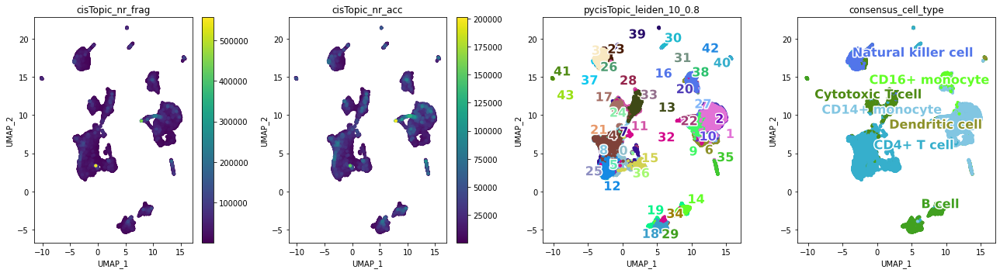

In [26]:
plot_metadata(cistopic_obj_dict['merged'],
              reduction_name='UMAP_harmony',
#               variables=['Unique_nr_frag', 'TSS_enrichment', 'Dupl_rate', 'FRIP',
#                              'Doublet_scores_fragments', 'fmx_sample', 'pycisTopic_leiden_10_0.6', 'seurat_cell_type', 'sample_id'],
              variables=['cisTopic_nr_frag', 'cisTopic_nr_acc',
                             'pycisTopic_leiden_10_0.8', 'consensus_cell_type'],
              target='cell',
              num_columns=4,
              text_size=16,
              dot_size=10,
              figsize=(18,5),
             )

UMAP without batch effect correction


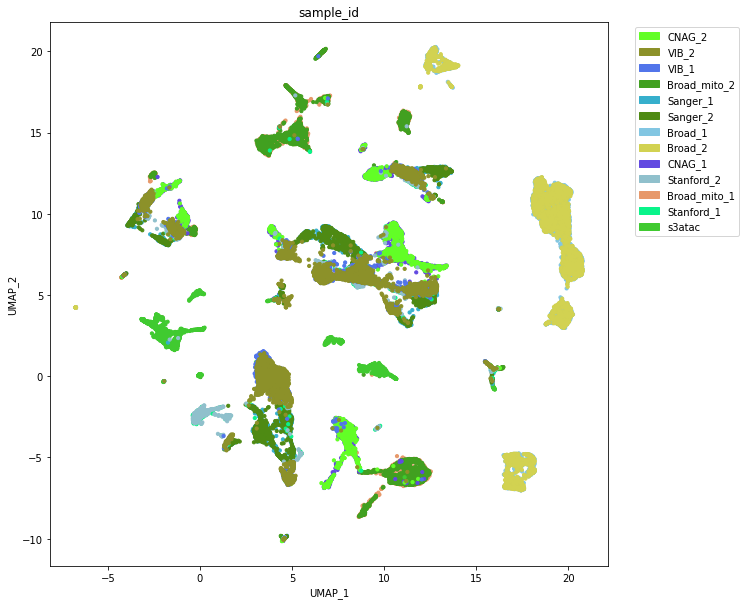

In [27]:
print("UMAP without batch effect correction")
plot_metadata(cistopic_obj_dict['merged'],
              reduction_name='UMAP',
              variables=['sample_id'],
              target='cell',
              show_legend=True,
              show_label=False,
              num_columns=1,
              text_size=16,
              dot_size=10,
              figsize=(10,10),
             )

UMAP with batch effect correction


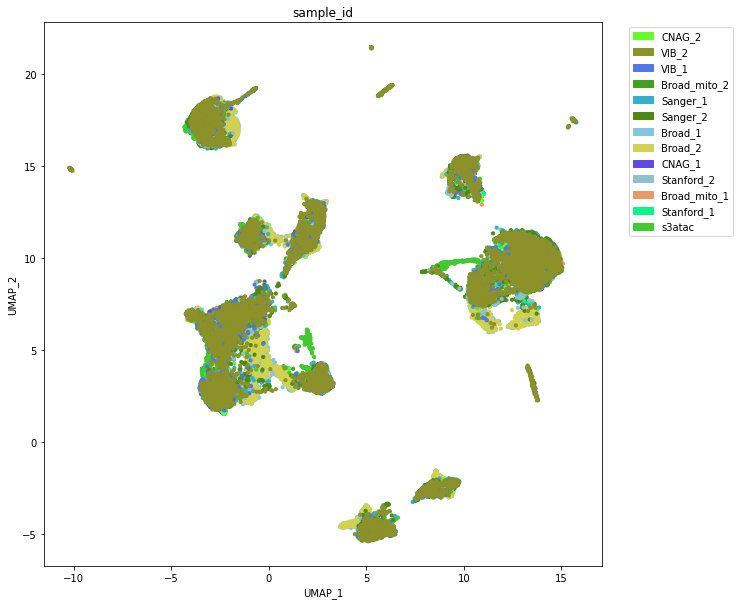

In [28]:
print("UMAP with batch effect correction")
plot_metadata(cistopic_obj_dict['merged'],
              reduction_name='UMAP_harmony',
              variables=['sample_id'],
              target='cell',
              show_legend=True,
              show_label=False,
              num_columns=1,
              text_size=16,
              dot_size=10,
              figsize=(10,10),
             )

### Integration evaluation

In [29]:
from harmonypy.lisi import compute_lisi
import seaborn as sns
import math

In [30]:
lisi = {
    'premerge': pd.DataFrame(
            compute_lisi(
                cistopic_obj_dict['merged'].projections['cell']['UMAP'].to_numpy(),
                metadata = cistopic_obj_dict['merged'].cell_data,
                label_colnames = ['sample_id']
            ),
            index=cistopic_obj_dict['merged'].cell_names,
            columns=['lisi']
        ),
    'postmerge': pd.DataFrame(
            compute_lisi(
                cistopic_obj_dict['merged'].projections['cell']['UMAP_harmony'].to_numpy(),
                metadata = cistopic_obj_dict['merged'].cell_data,
                label_colnames = ['sample_id']
            ),
            index=cistopic_obj_dict['merged'].cell_names,
            columns=['lisi']
        ),
}
lisi['premerge']['group'] = 'Pre-merge'
lisi['premerge']['sample_id'] = [ x.split('-')[1] for x in lisi['premerge'].index.to_list() ]
lisi['premerge']['Sample'] = [ sample_map[x] for x in lisi['premerge']['sample_id'] ]
lisi['postmerge']['group'] = 'Post-merge'
lisi['postmerge']['sample_id'] = [ x.split('-')[1] for x in lisi['postmerge'].index.to_list() ]
lisi['postmerge']['Sample'] = [ sample_map[x] for x in lisi['postmerge']['sample_id'] ]

In [31]:
def cilo(x):
    return x.mean() - 1.95 * x.sd() / math.sqrt(x.shape[0])

In [32]:
ldf = pd.concat([
    lisi['premerge'].groupby('sample_id').mean(),
    lisi['postmerge'].groupby('sample_id').mean(),
],axis=1)
ldf.columns = ['Pre-merge', 'Post-merge']

In [33]:
ldf['Pre-merge CI'] = ''
ldf['Post-merge CI'] = ''

def get_formatted_ci(x, i):
    ix = x['sample_id'] == i
    s = x[ix]['lisi'].std()
    m = x[ix]['lisi'].mean()
    
    return (#str(round(m,3)) + 
            ' (' +
        str(round(m - 1.96 * s / math.sqrt(len(ix)),3)) +
        ' - ' +
        str(round(m + 1.96 * s / math.sqrt(len(ix)),3)) +
        ')')

for i in ldf.index:
    ldf.loc[i,'Pre-merge CI'] = get_formatted_ci(lisi['premerge'], i)
    ldf.loc[i,'Post-merge CI'] = get_formatted_ci(lisi['postmerge'], i)

ldf['Sample'] = sample_annot['Sample']
ldf[['Sample', 'Pre-merge', 'Pre-merge CI', 'Post-merge', 'Post-merge CI']]

,Sample,Pre-merge,Pre-merge CI,Post-merge,Post-merge CI
sample_id,,,,,
Broad_1,Harvard_1,1.905860,(1.904 - 1.907),2.799975,(2.784 - 2.816)
Broad_2,Harvard_2,1.907412,(1.906 - 1.909),2.787319,(2.772 - 2.802)
Broad_mito_1,Broad_1,1.932514,(1.93 - 1.935),5.473370,(5.46 - 5.487)
Broad_mito_2,Broad_2,1.945036,(1.942 - 1.948),5.467206,(5.454 - 5.48)
CNAG_1,CNAG_1,1.992660,(1.989 - 1.997),5.509353,(5.495 - 5.524)
CNAG_2,CNAG_2,1.989605,(1.986 - 1.993),5.529225,(5.515 - 5.543)
Sanger_1,Sanger_1,1.985505,(1.982 - 1.989),5.138741,(5.123 - 5.155)
Sanger_2,Sanger_2,1.985618,(1.982 - 1.989),5.012458,(4.996 - 5.028)
Stanford_1,Stanford_1,2.211364,(2.203 - 2.219),5.521515,(5.506 - 5.537)


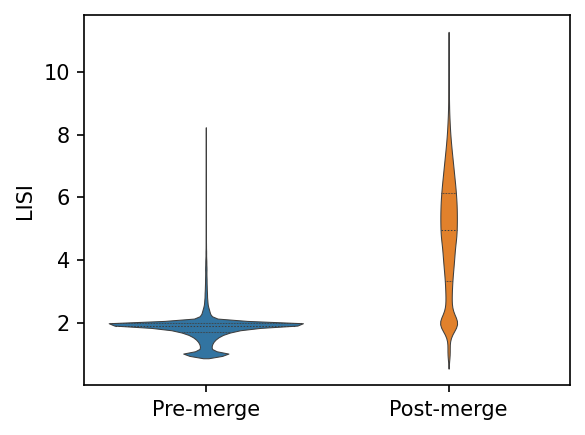

In [34]:
tp = pd.concat([
    lisi['premerge'],
    lisi['postmerge']
])

fig, ax = plt.subplots(1,1, figsize=(4,3), dpi=150)

g = sns.violinplot(data=tp, x='group', y='lisi',
                   dodge=True,
                   linewidth=0.5,
                   inner='quartiles',
                   ax=ax, kind='kde',
                   )
ax.set_ylabel('LISI')
ax.set_xlabel('')
plt.tight_layout()

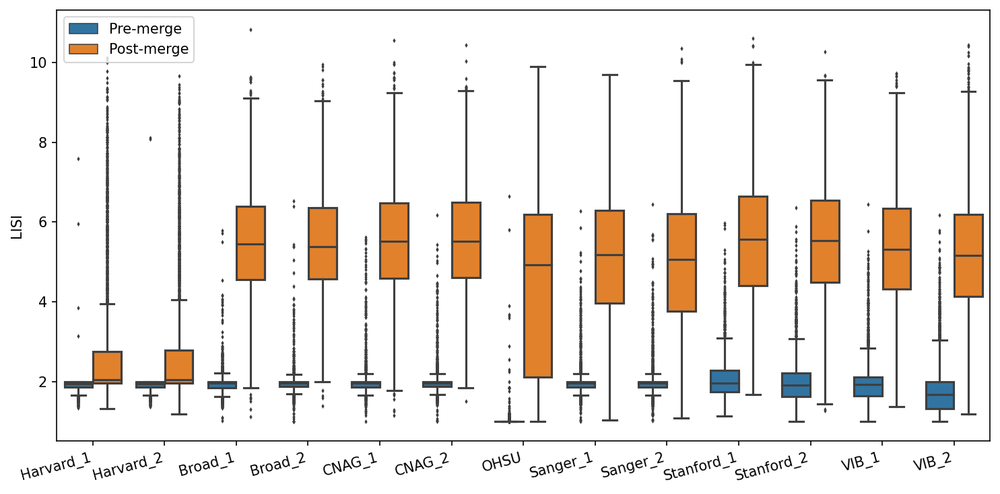

In [35]:
tp = pd.concat([
    lisi['premerge'],
    lisi['postmerge']
])

fig, ax = plt.subplots(1,1, figsize=(10,5), dpi=150)

g = sns.boxplot(data=tp, x='Sample', y='lisi',
                   hue='group',
                   dodge=True,
                   #linewidth=0.1,
                   fliersize=1,
                   #inner='quartiles',
                   ax=ax,# kind='kde',
                   #width=0.9
                   )

ax.set_xlabel('')
ax.set_ylabel('LISI')
ax.legend(loc=2)
g.set_xticklabels(g.get_xticklabels(), rotation=15, ha='right', fontsize=10)
plt.tight_layout()

In [36]:
lisi['premerge'].to_csv(
    os.path.join(f_final_dir, 'LISI_premerge_sampleId.tsv'),
    sep='\t'
    )
lisi['postmerge'].to_csv(
    os.path.join(f_final_dir, 'LISI_postmerge_sampleId.tsv'),
    sep='\t'
    )

## Save/load cisTopic objects

In [37]:
f_out = os.path.join(wdir, f_cto_dir, 'fulldata_all_with_models__cistopic_obj.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        cistopic_obj_dict = pickle.load(f)
else:
    with open(f_out, 'wb') as f:
        pickle.dump(cistopic_obj_dict, f)

Loading /staging/leuven/stg_00002/lcb/cflerin/analysis/pbmc_atac/analysis2/data_freeze_Jun2021/atac_qc_multiplet_merged/jupyter/cistopic_objs__consensus_peaks/fulldata_all_with_models__cistopic_obj.pkl


## Topic binarization & QC

In [38]:
from pycisTopic.topic_binarization import binarize_topics

### Binarize the topic-region distributions

Broad_1


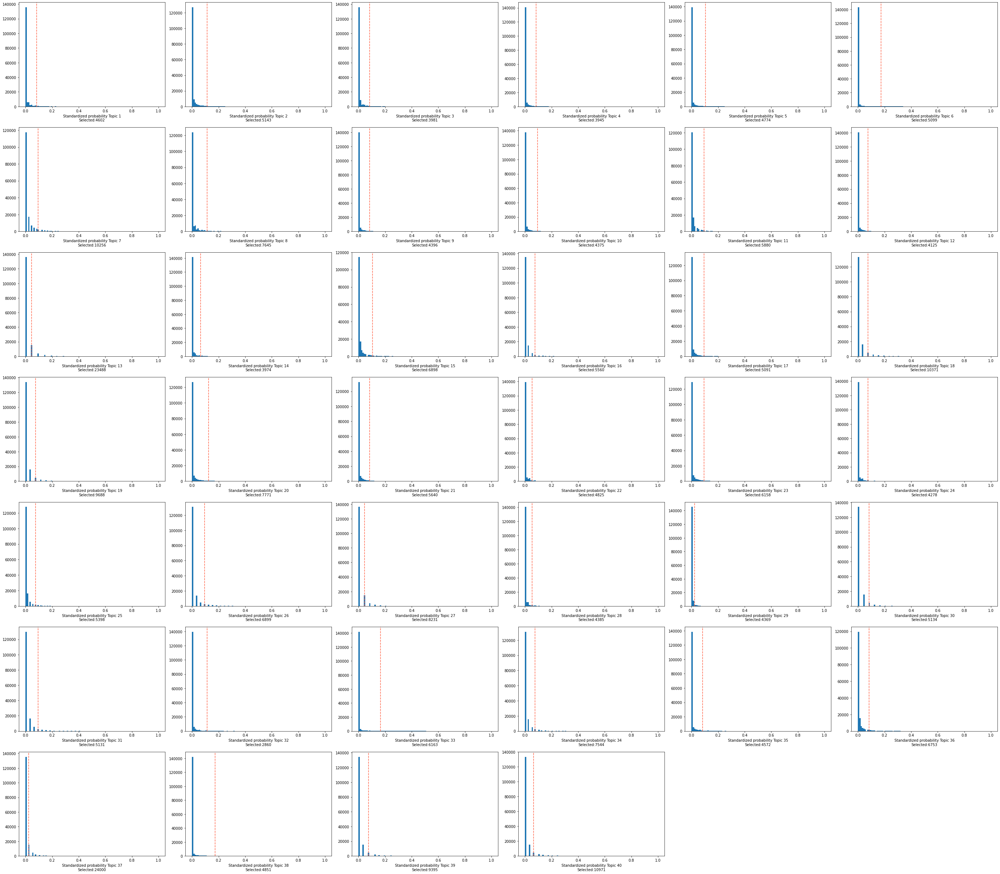

Broad_2


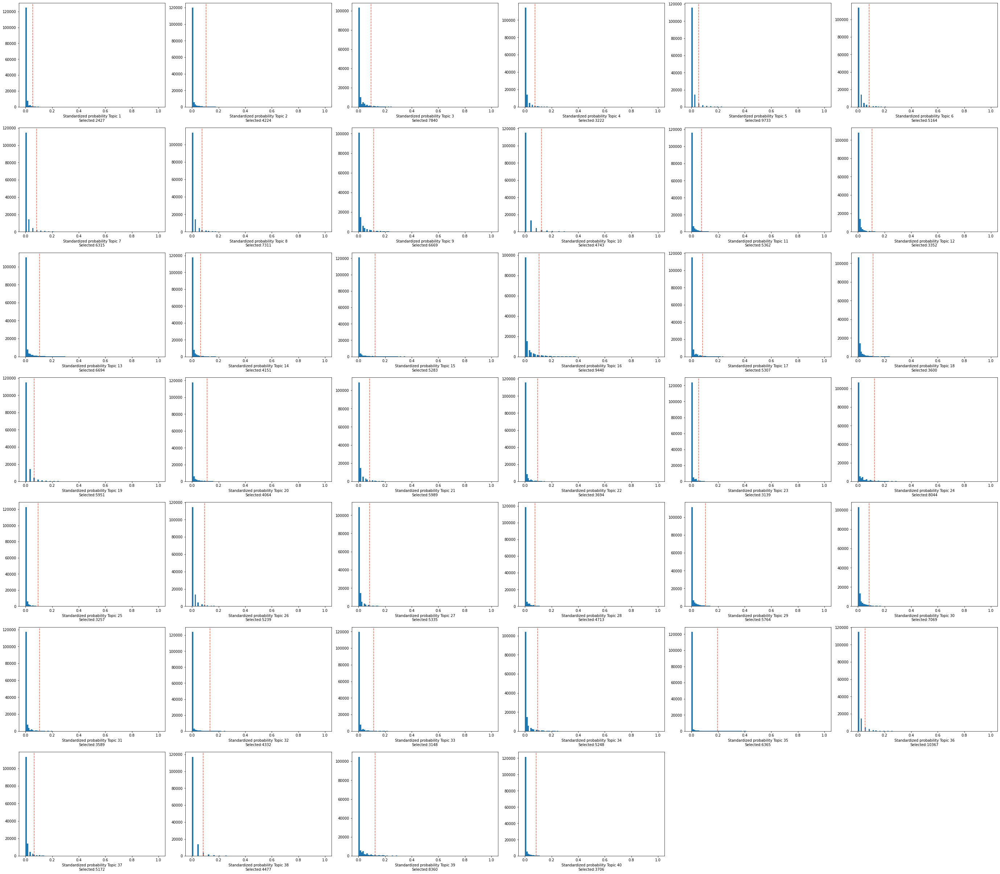

Broad_mito_1


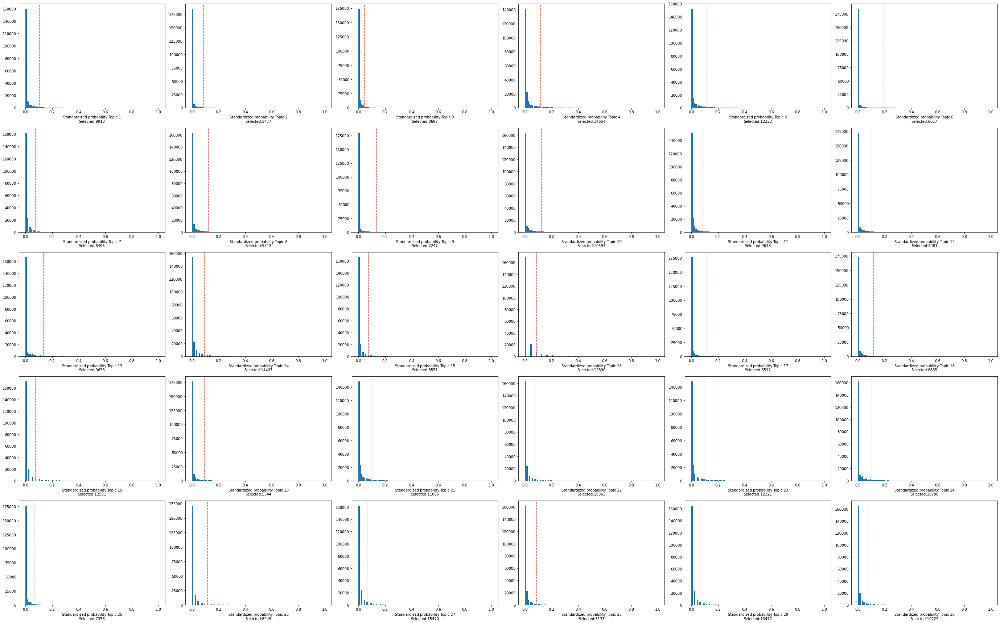

Broad_mito_2


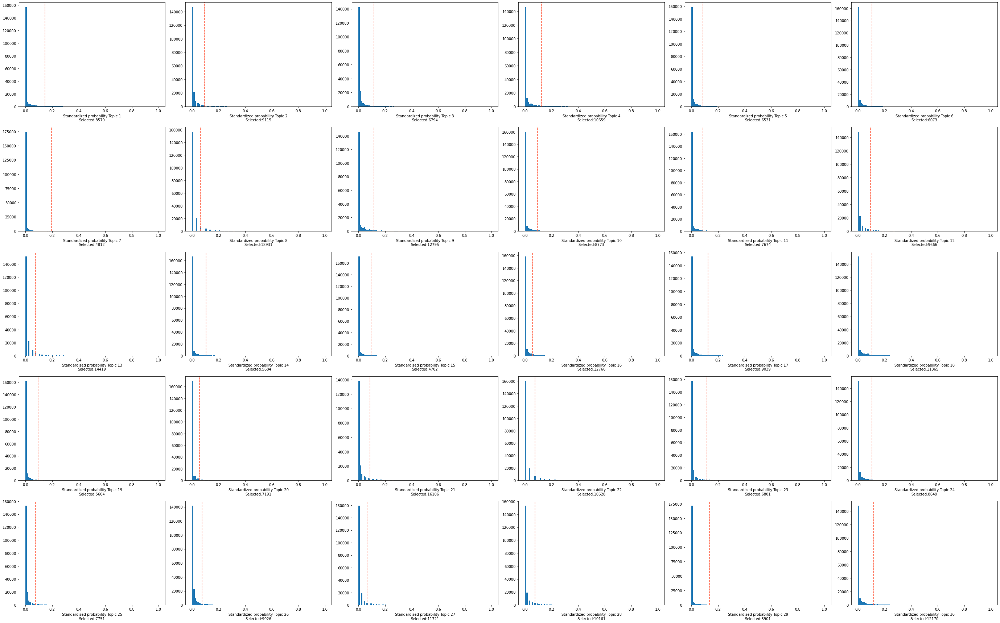

CNAG_1


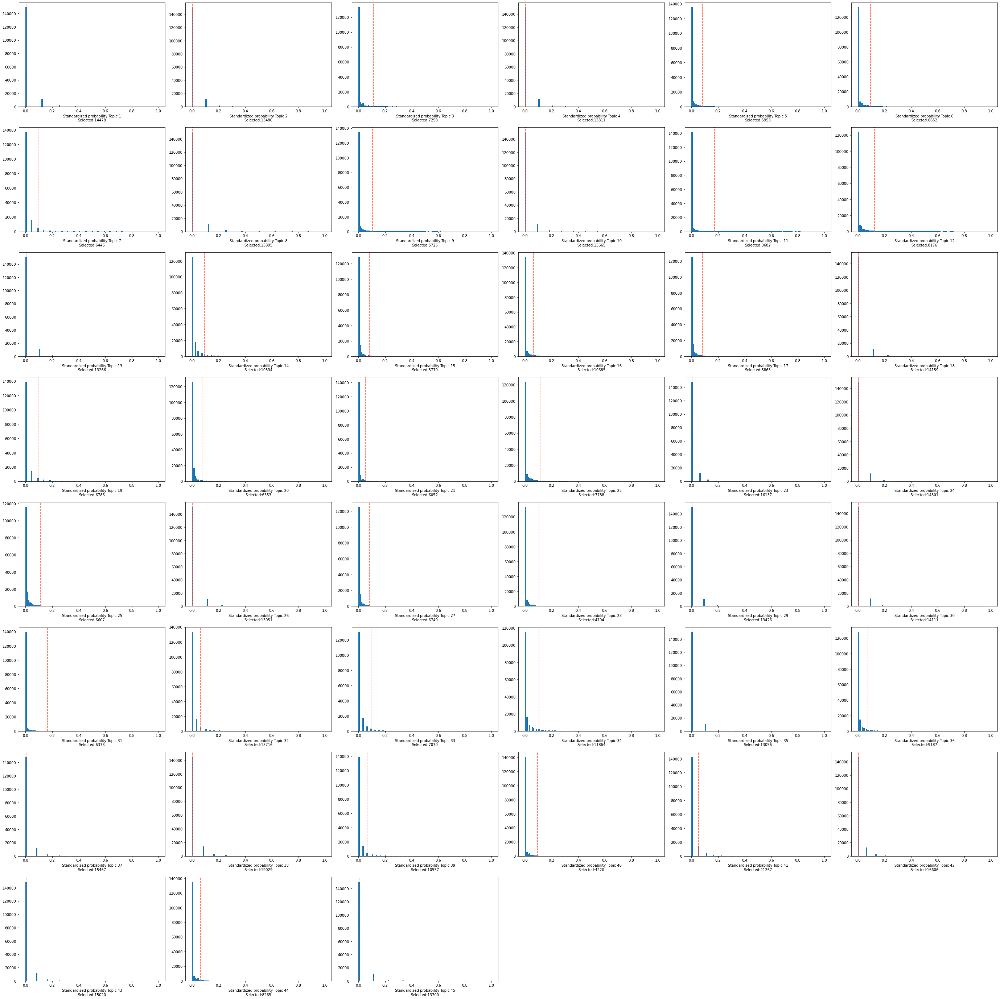

CNAG_2


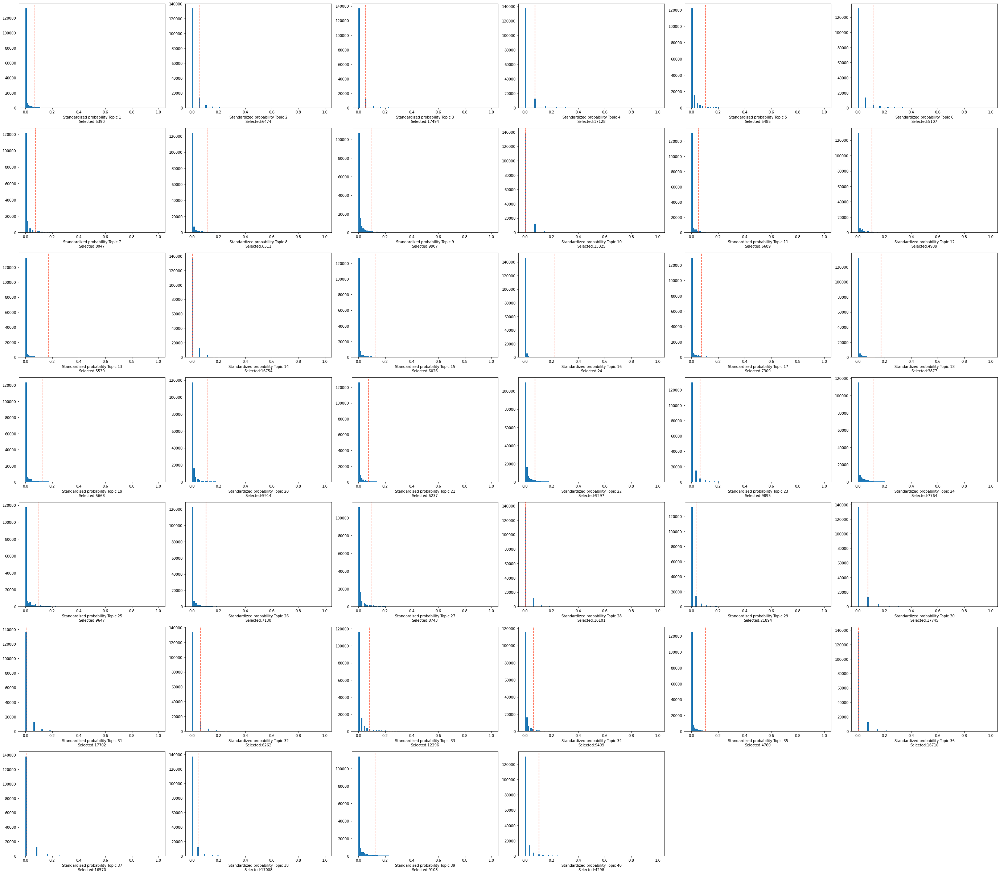

s3atac


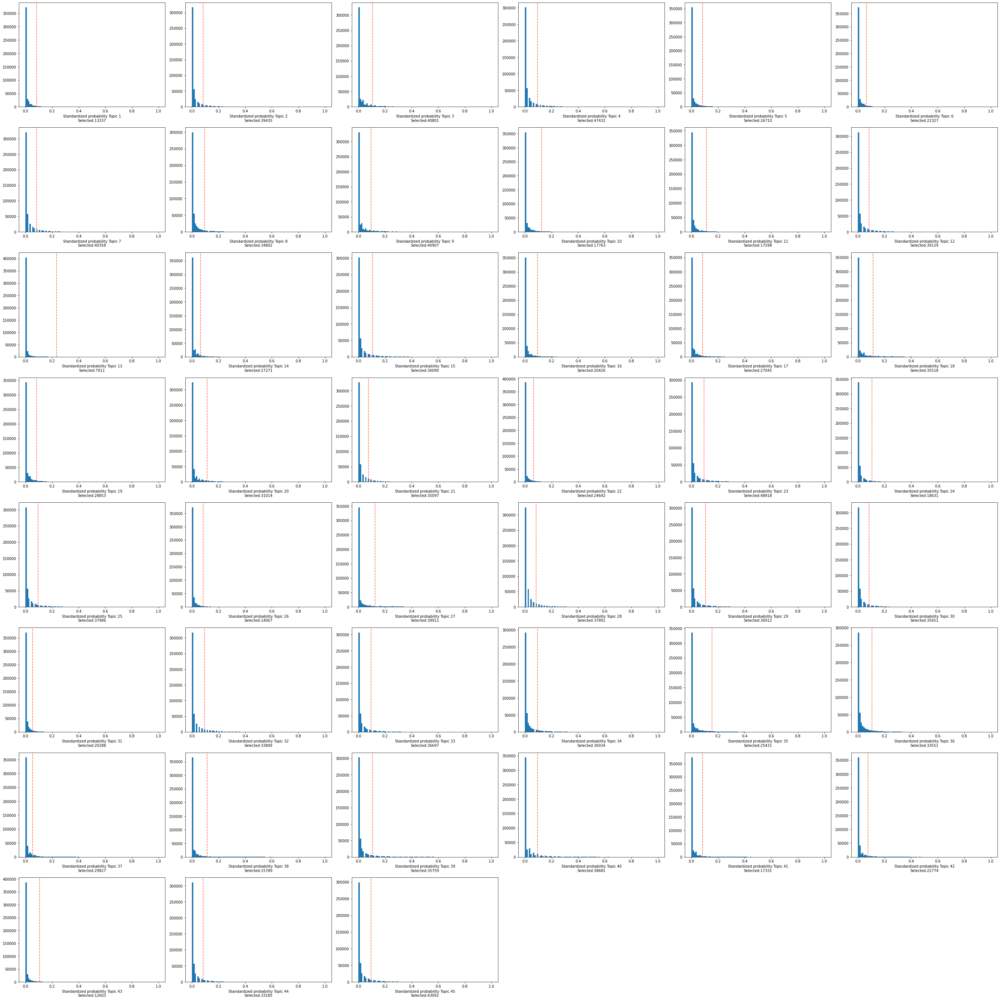

Sanger_1


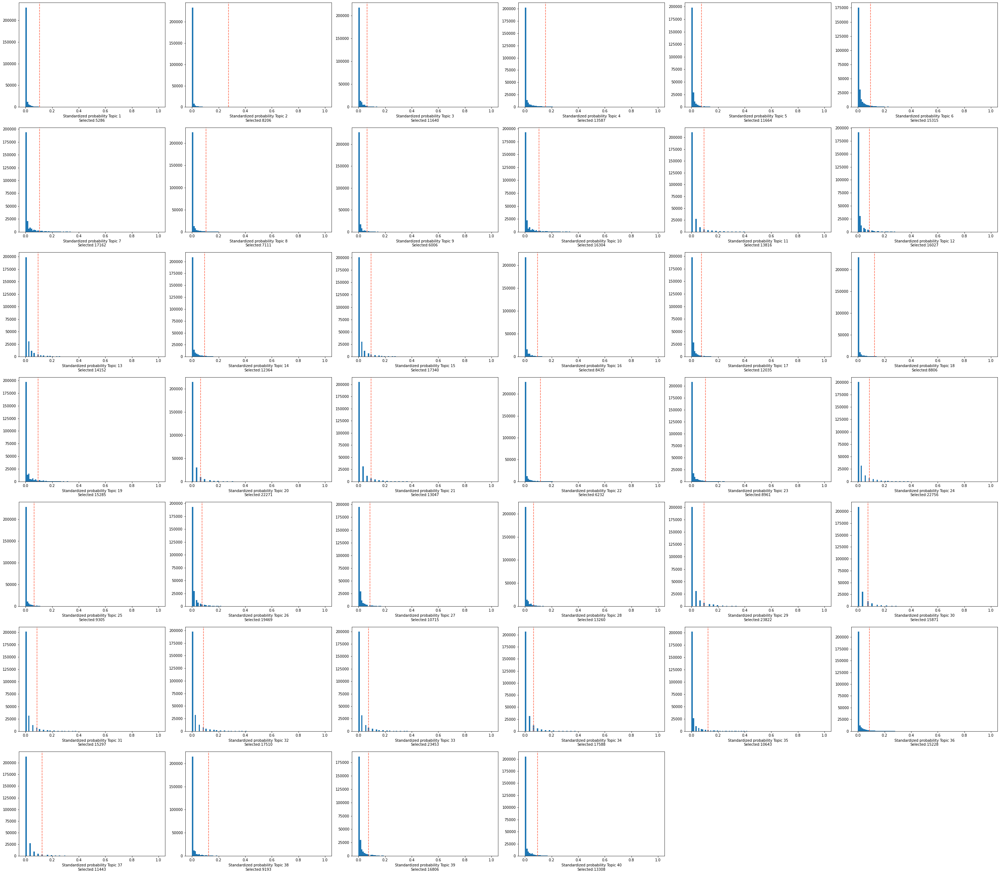

Sanger_2


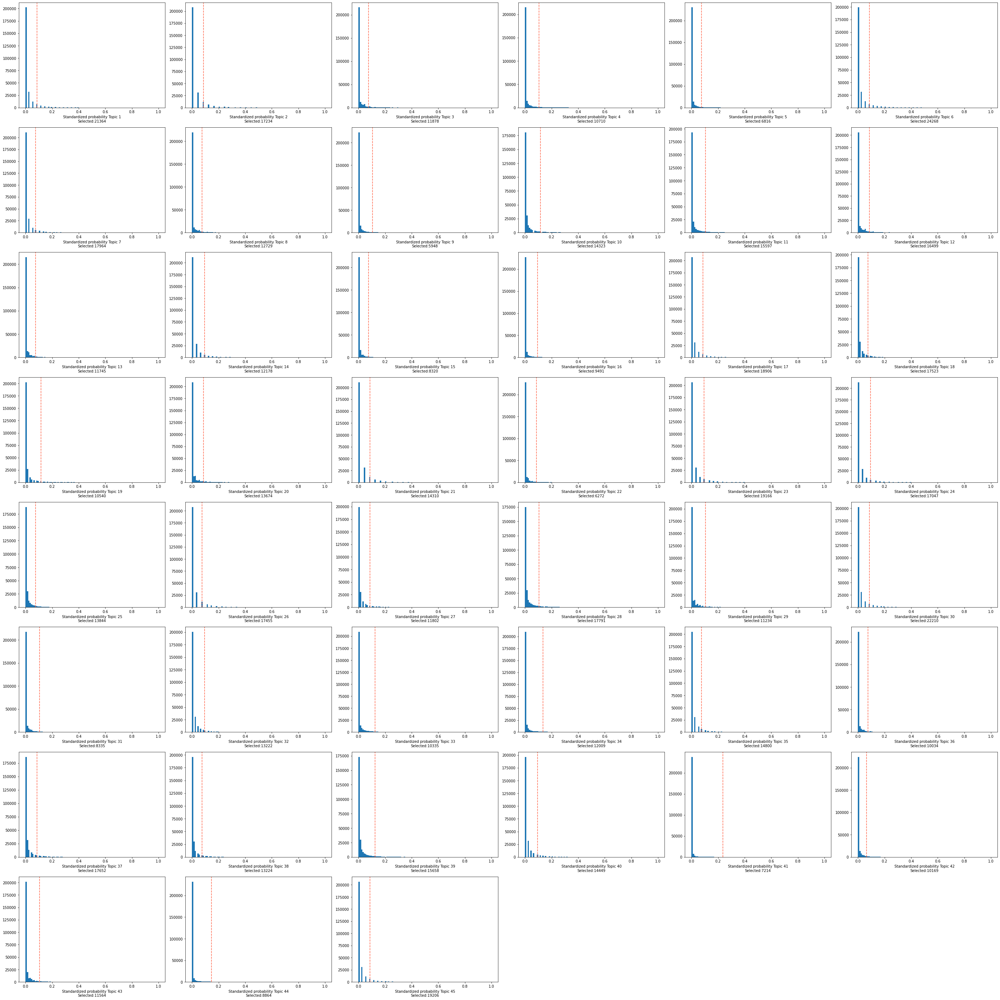

Stanford_1


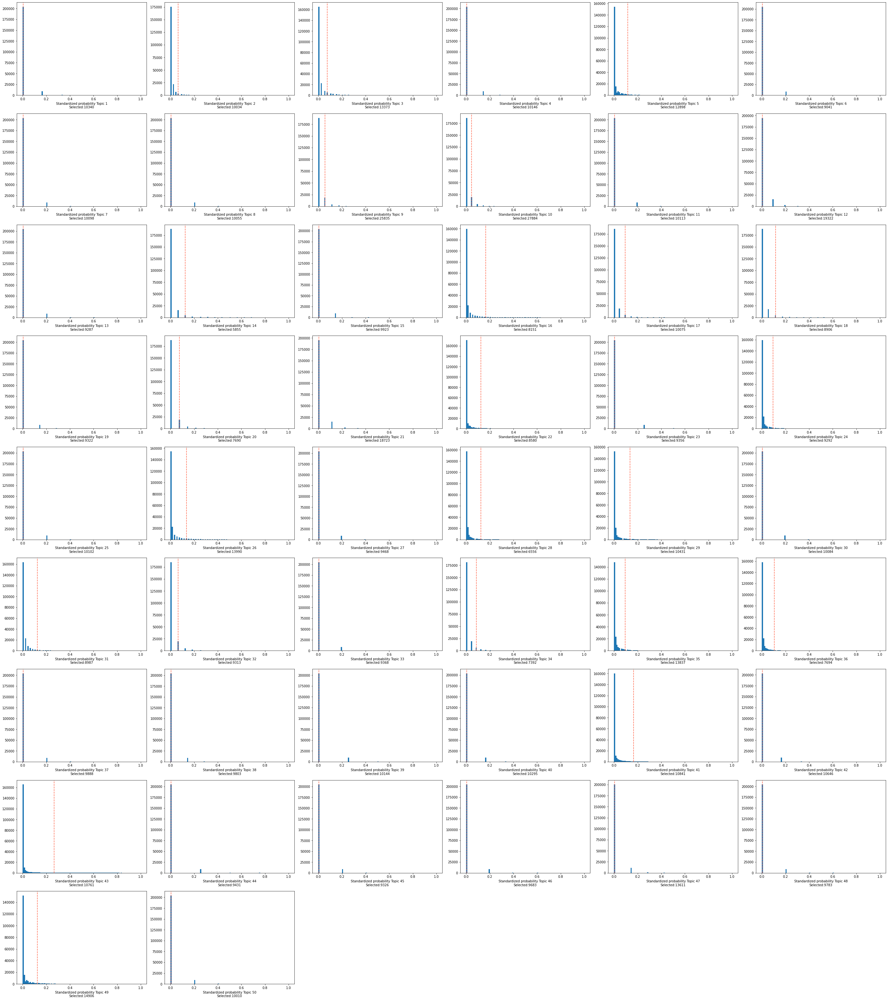

Stanford_2


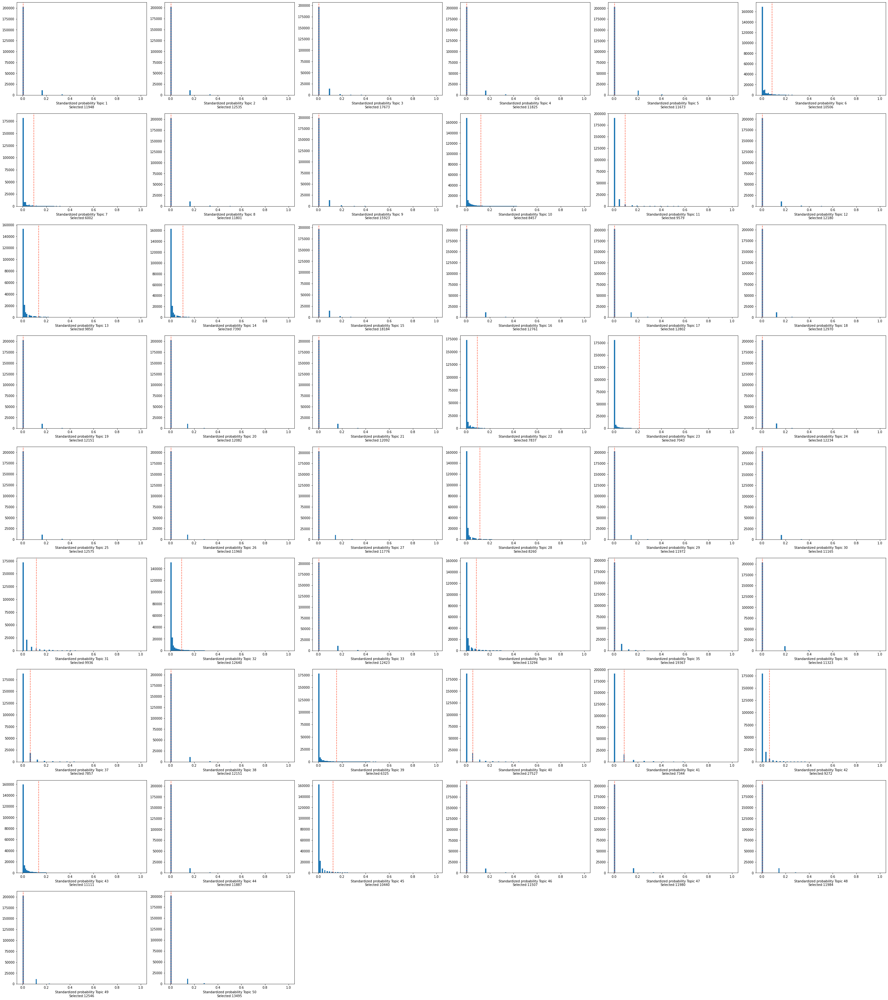

VIB_1


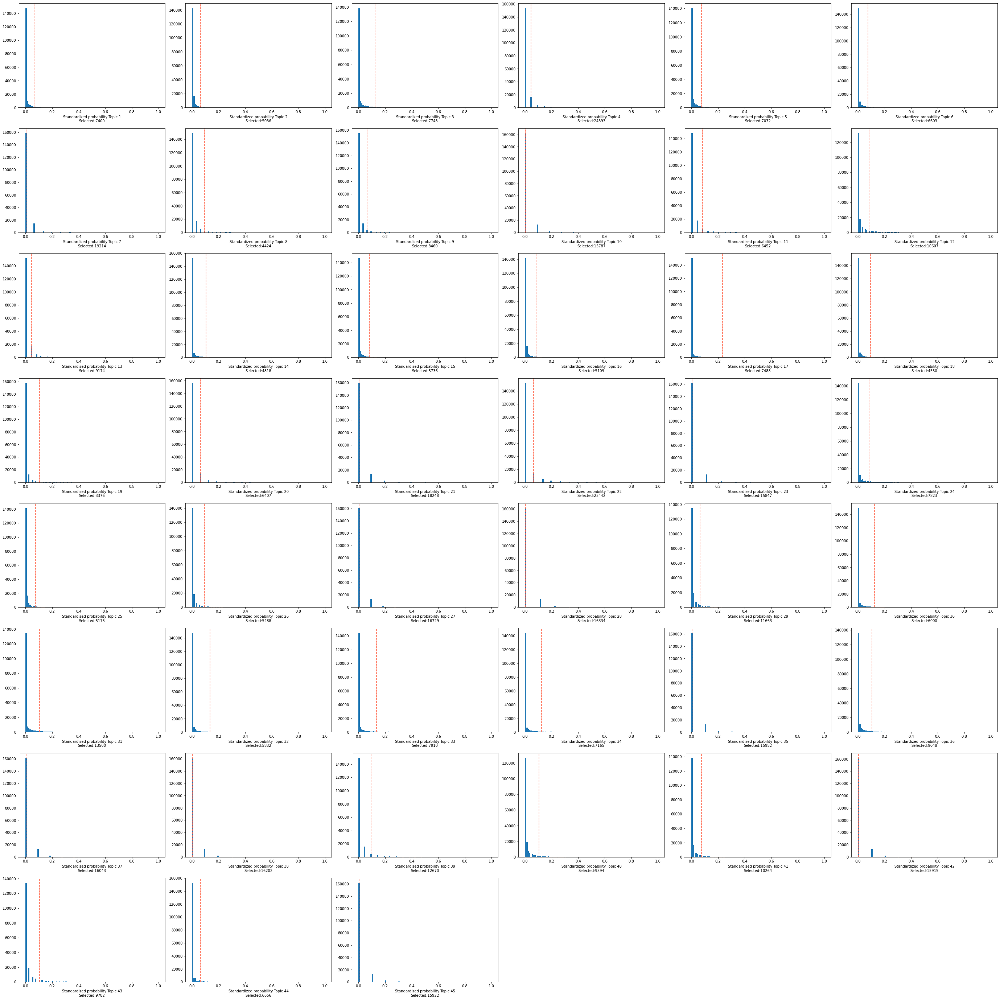

VIB_2


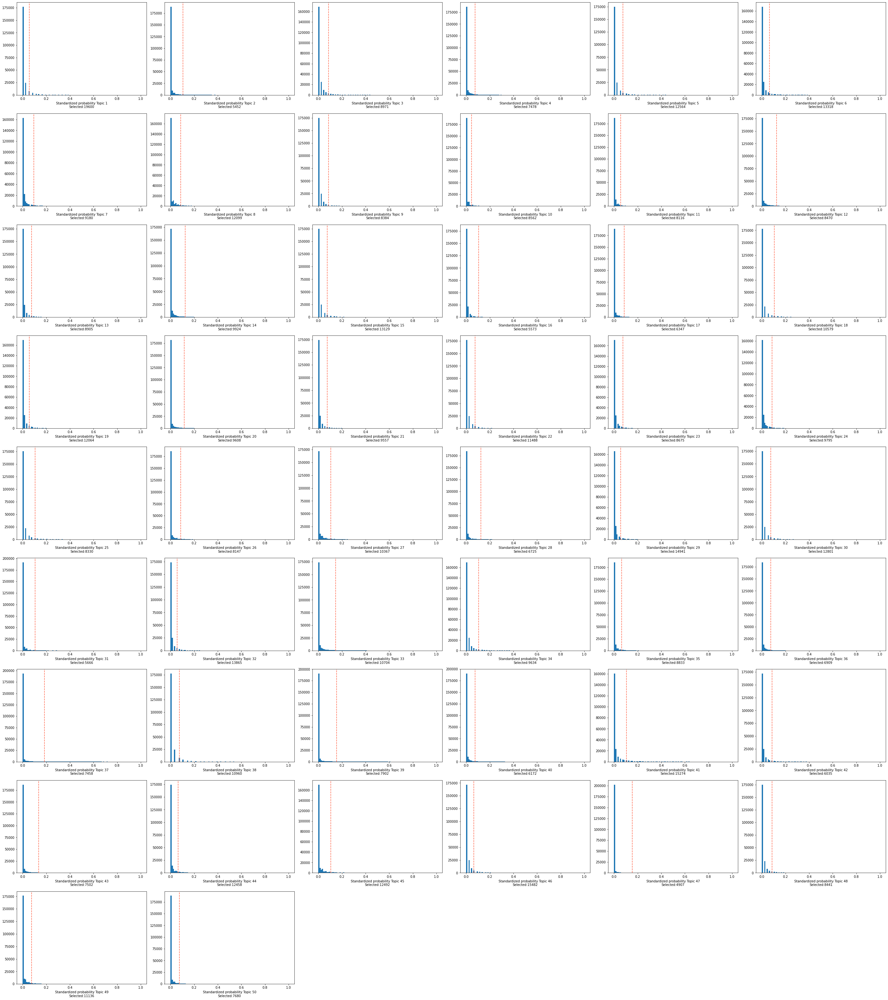

merged


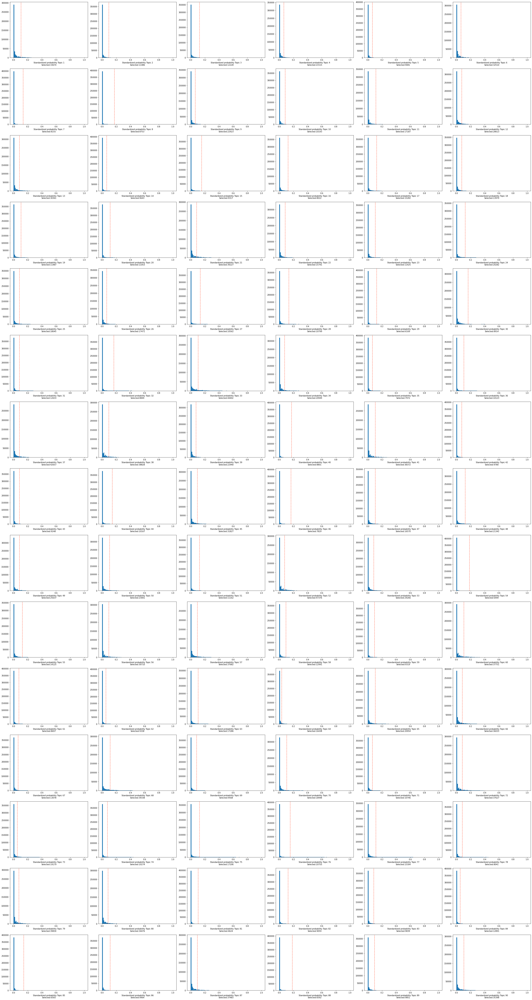

In [39]:
region_bin_topics_dict = {}
for key in cistopic_obj_dict.keys():
    print(key)
    region_bin_topics_dict[key] = binarize_topics(
        cistopic_obj_dict[key],
        method='otsu',
        ntop=3000,
        plot=True,
        num_columns=6,
    )

### Binarize the cell-topic distribions

Broad_1


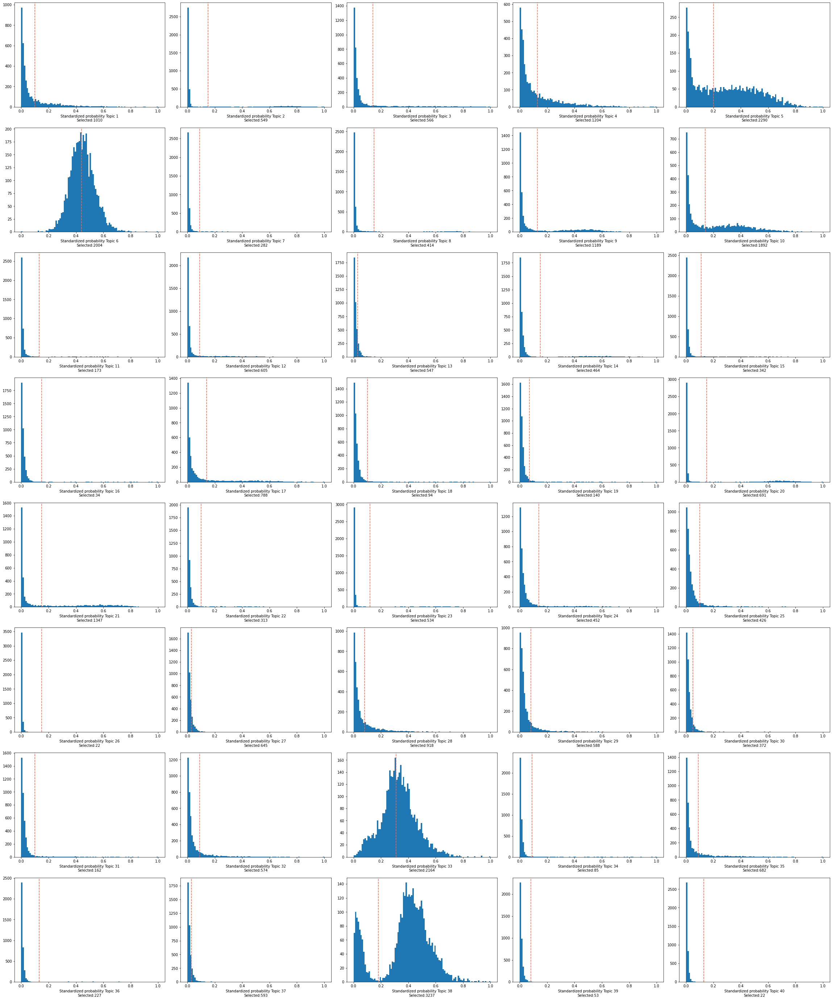

Broad_2


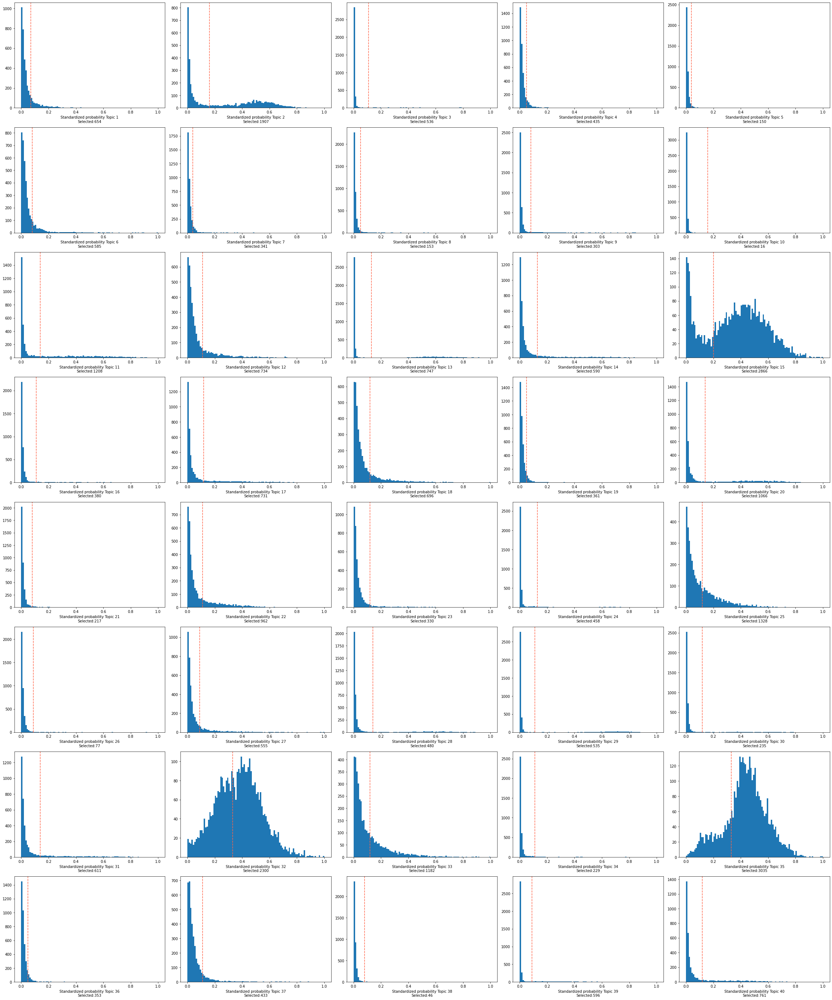

Broad_mito_1


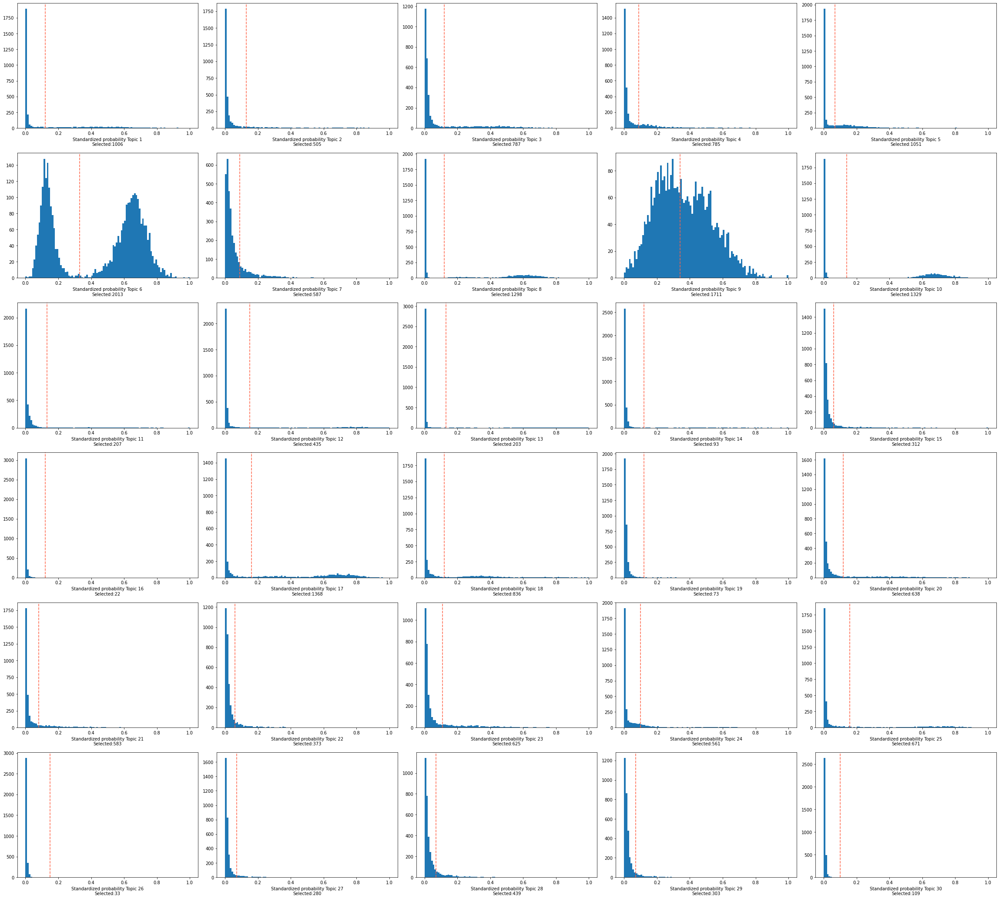

Broad_mito_2


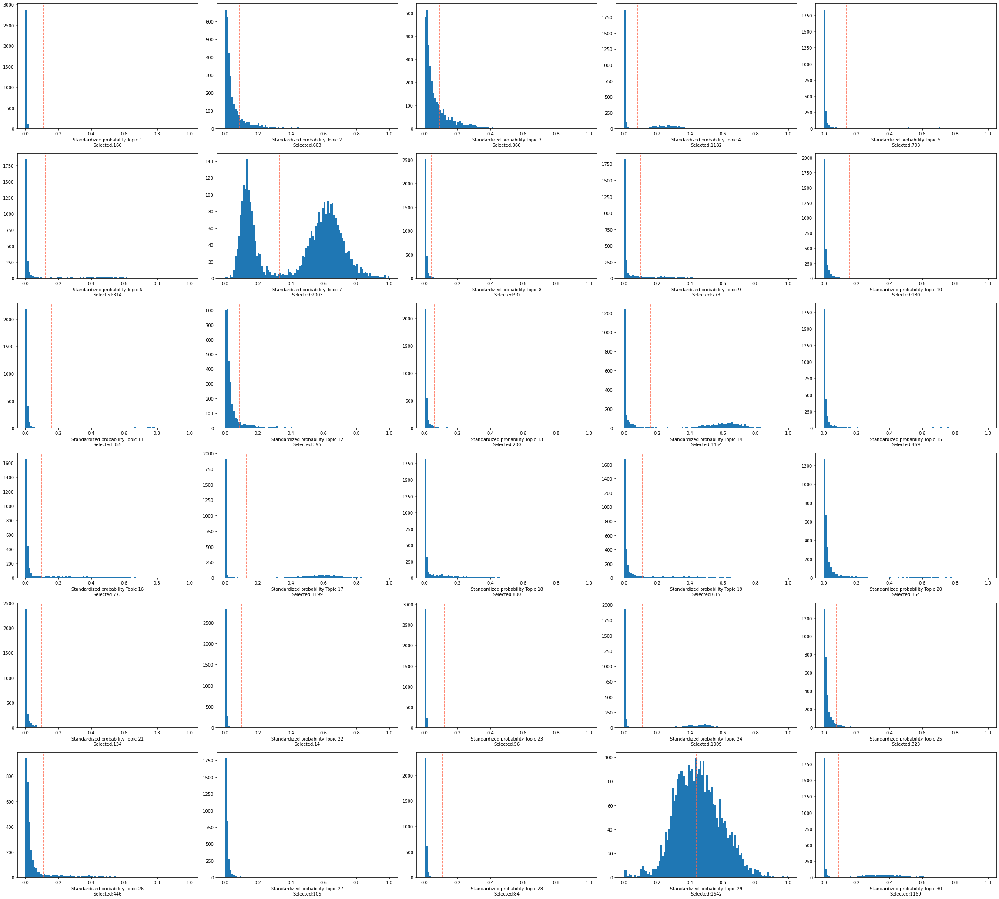

CNAG_1


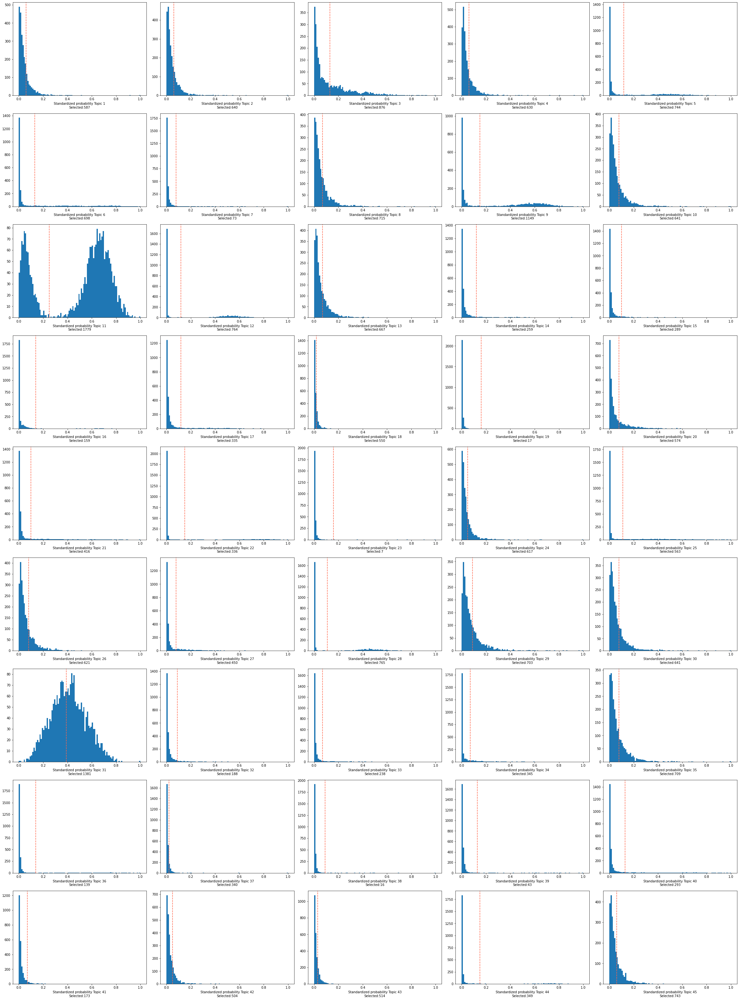

CNAG_2


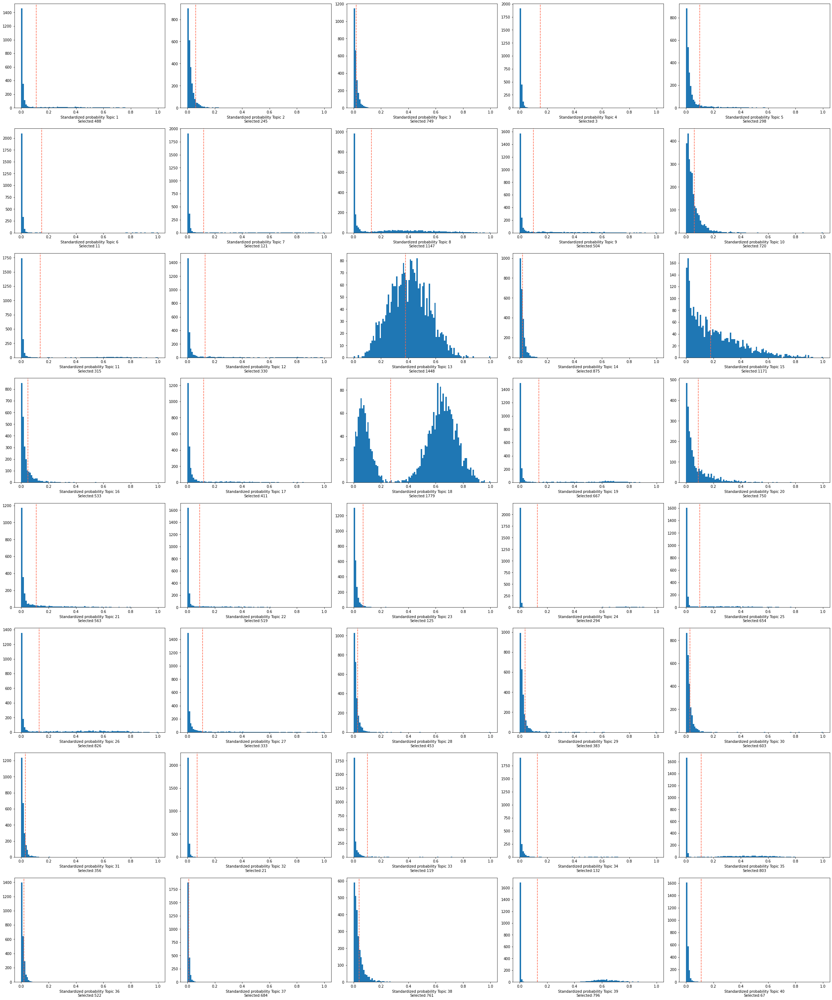

s3atac


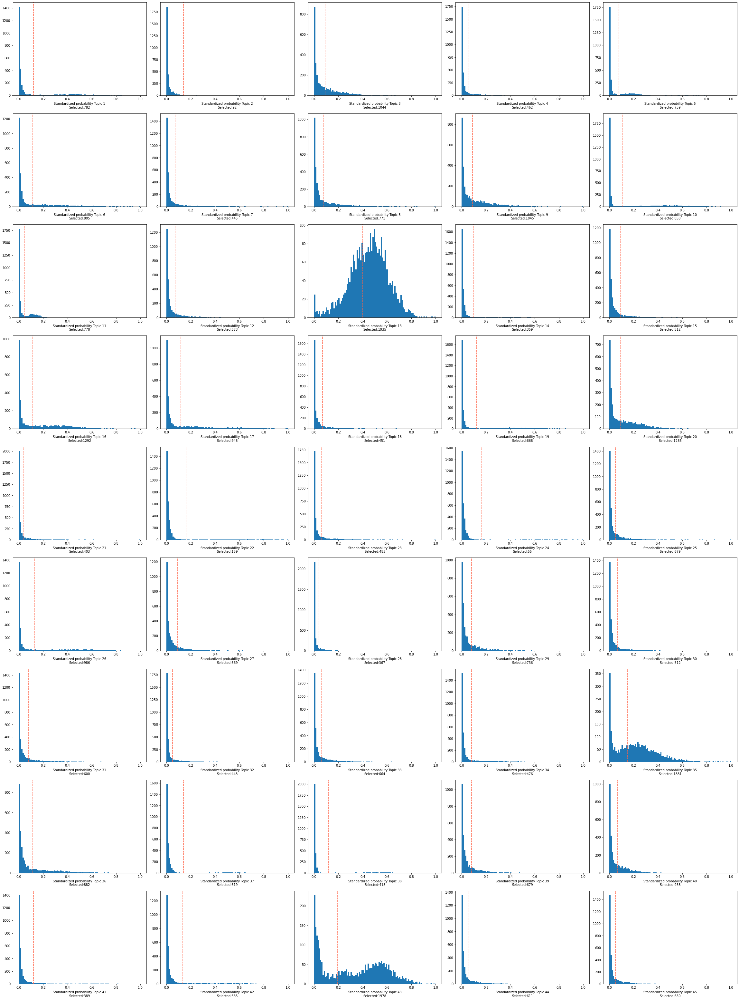

Sanger_1


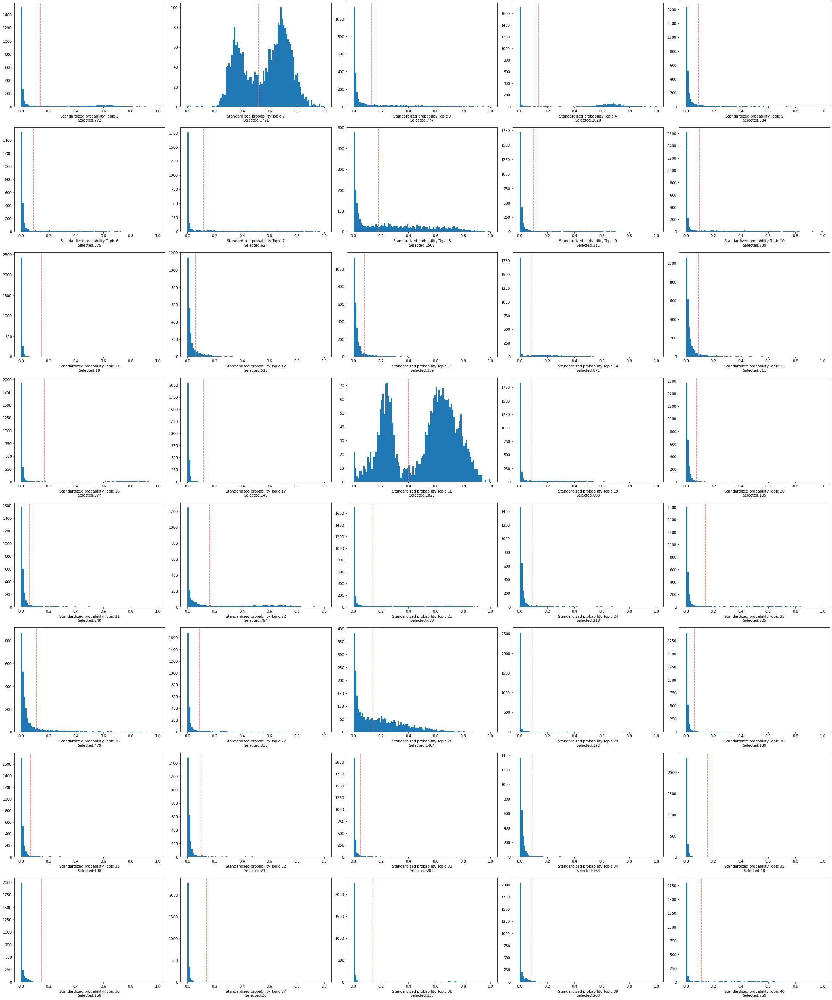

Sanger_2


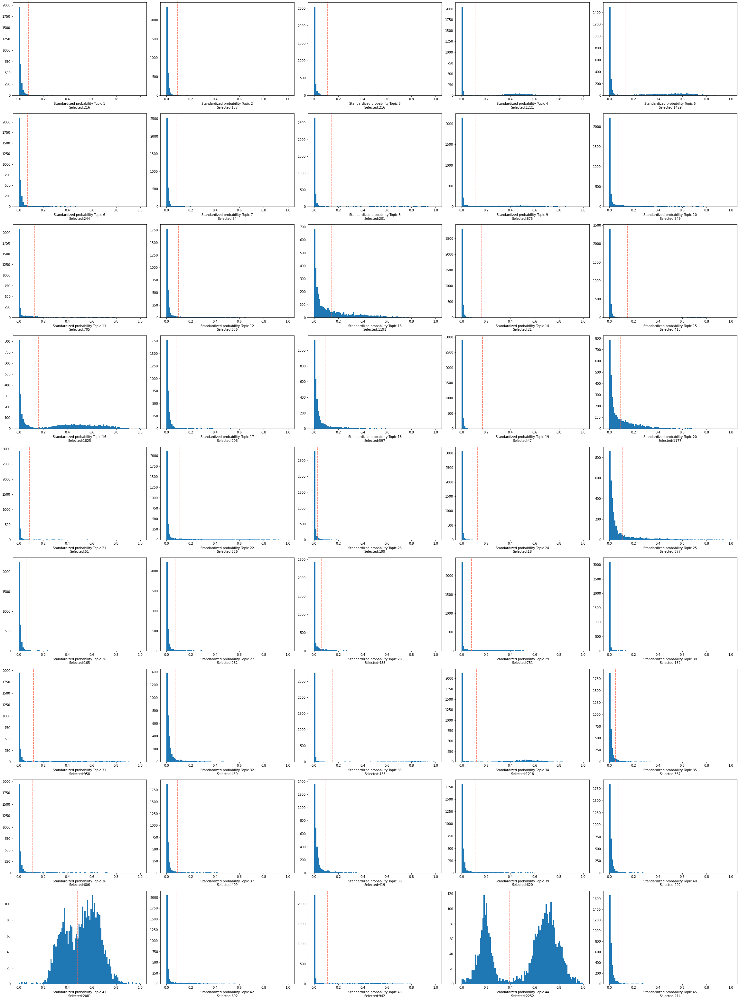

Stanford_1


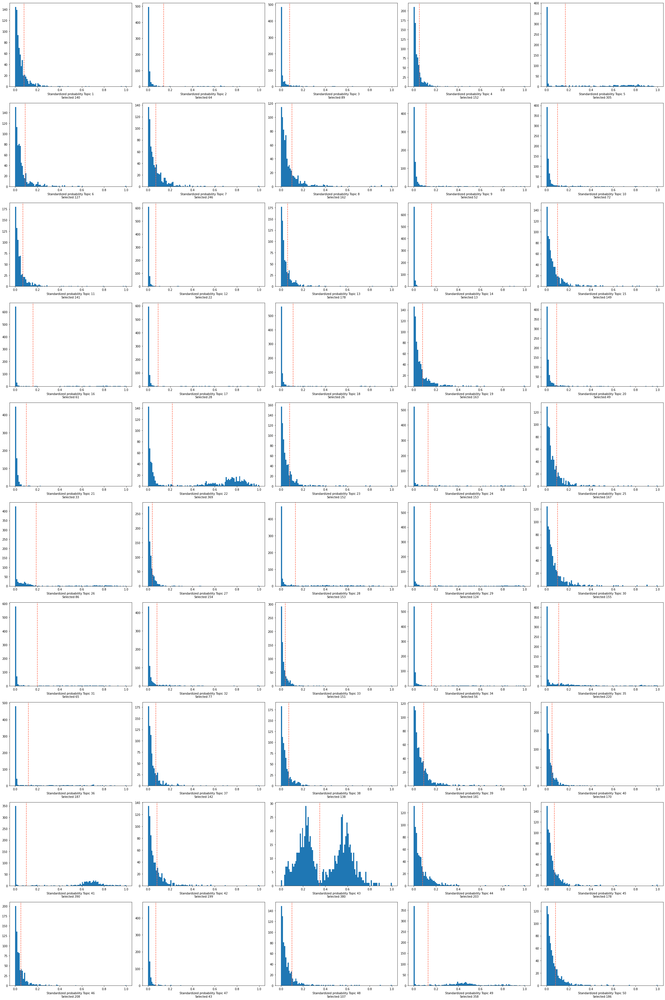

Stanford_2


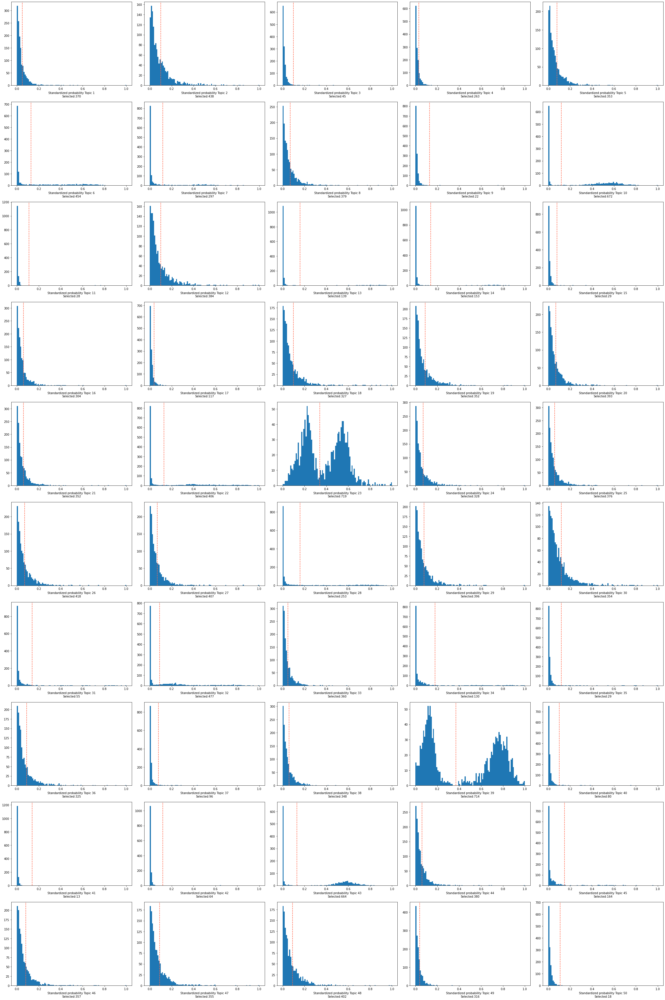

VIB_1


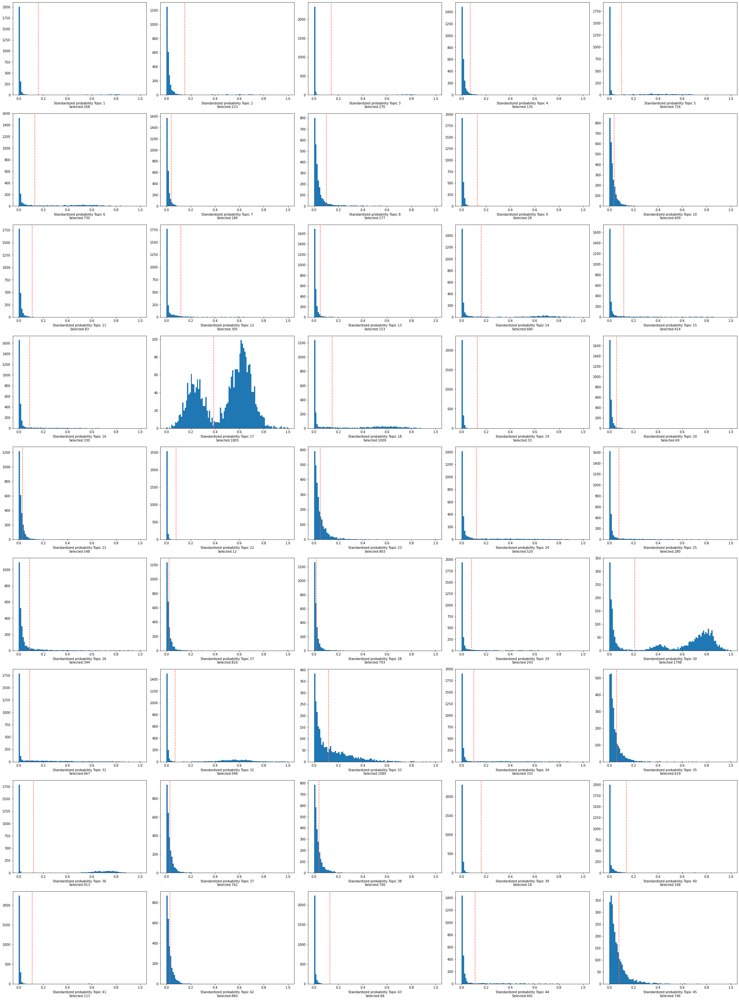

VIB_2


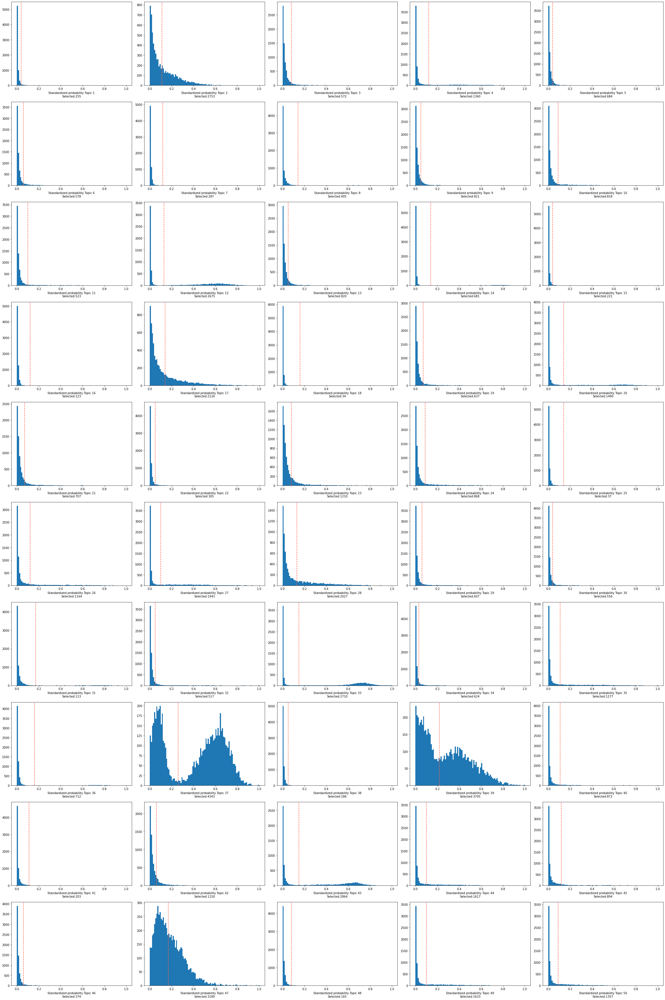

merged


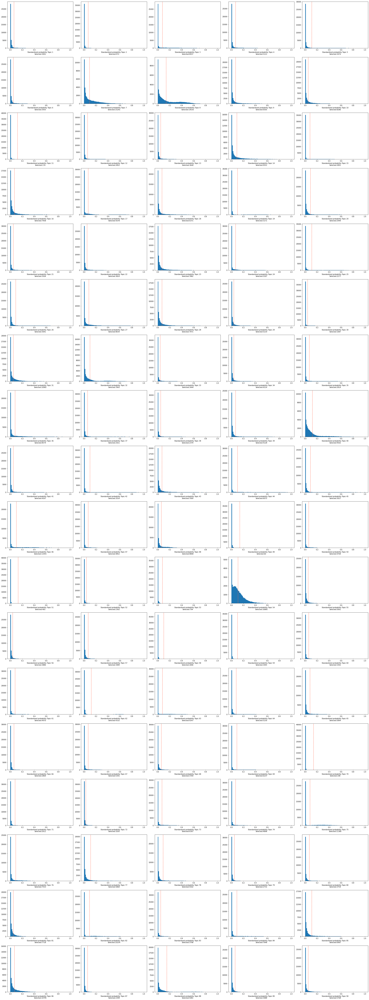

In [40]:
binarized_cell_topic_dict = {}
for key in cistopic_obj_dict.keys():
    print(key)
    binarized_cell_topic = binarize_topics(
        cistopic_obj_dict[key],
        target='cell',
        method='li',
        plot=True,
        num_columns=5,
        nbins=100
    )
    binarized_cell_topic_dict[key] = binarized_cell_topic.copy()

### Refine the binarization thresholds

In [41]:
# predifined_thr={'Topic12':0.7, 'Topic13':0.4, 'Topic27':0.5}
# binarized_cell_topic = binarize_topics(
#     cistopic_obj_dict['CNAG_1'],
#     target='cell',
#     method='li',
#     plot=True,
#     num_columns=5,
#     nbins=100,
#     predifined_thr=predifined_thr
# )

### Compute the topic quality control metrics

In [42]:
from pycisTopic.topic_qc import compute_topic_metrics, plot_topic_qc
from pycisTopic.utils import fig2img
import matplotlib.pyplot as plt

Broad_1


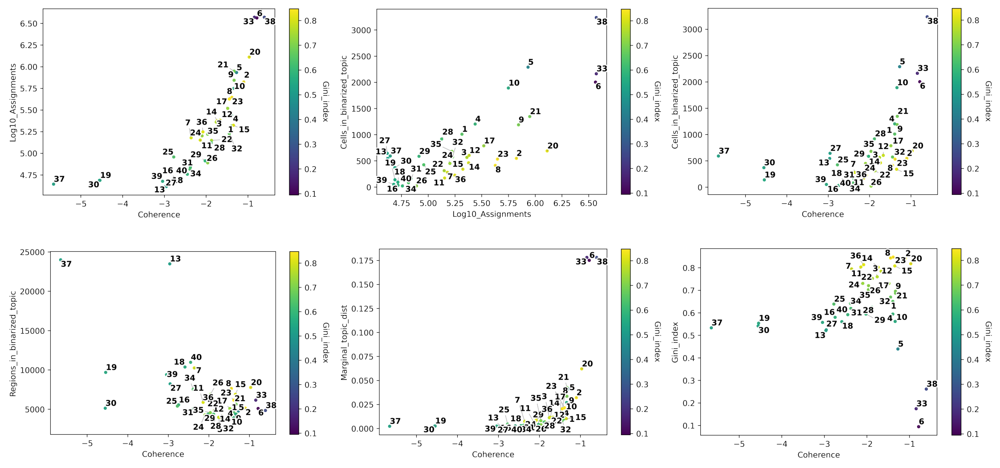

Broad_2


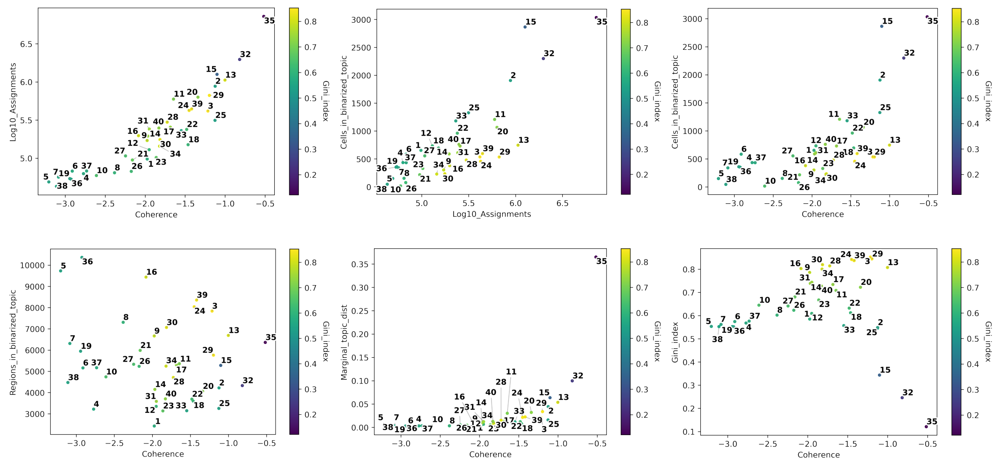

Broad_mito_1


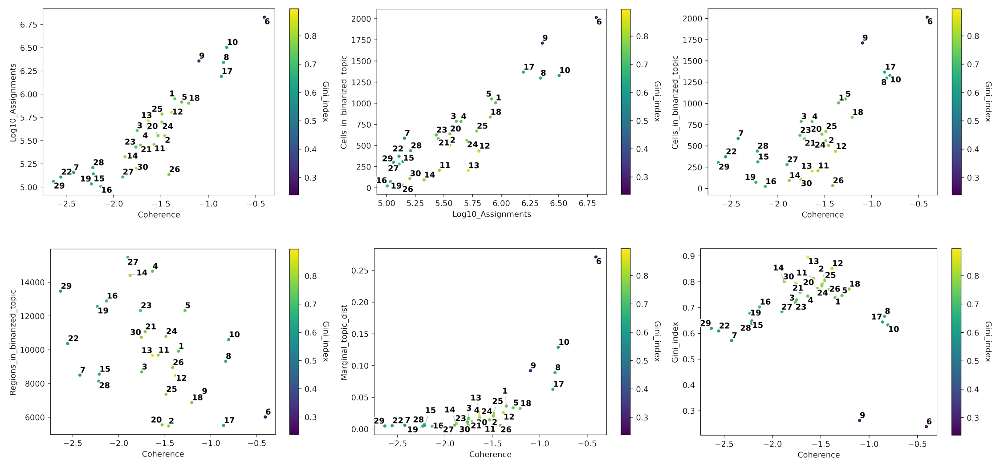

Broad_mito_2


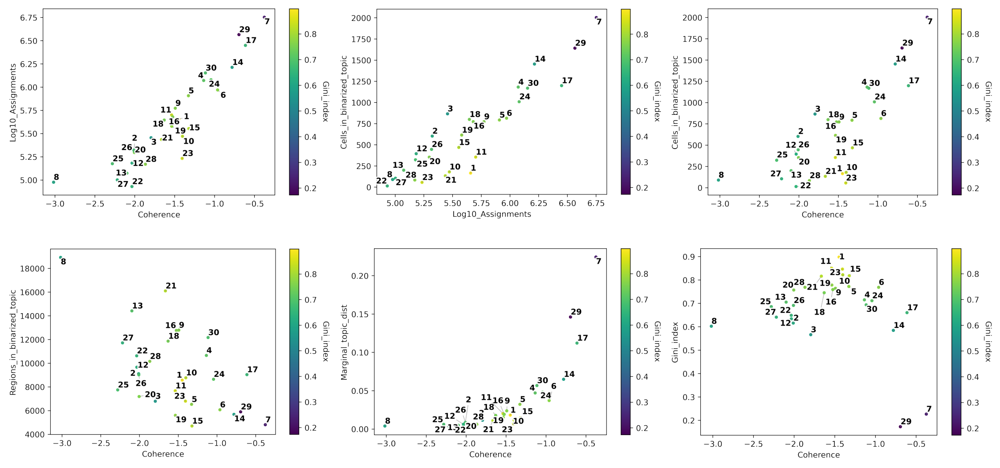

CNAG_1


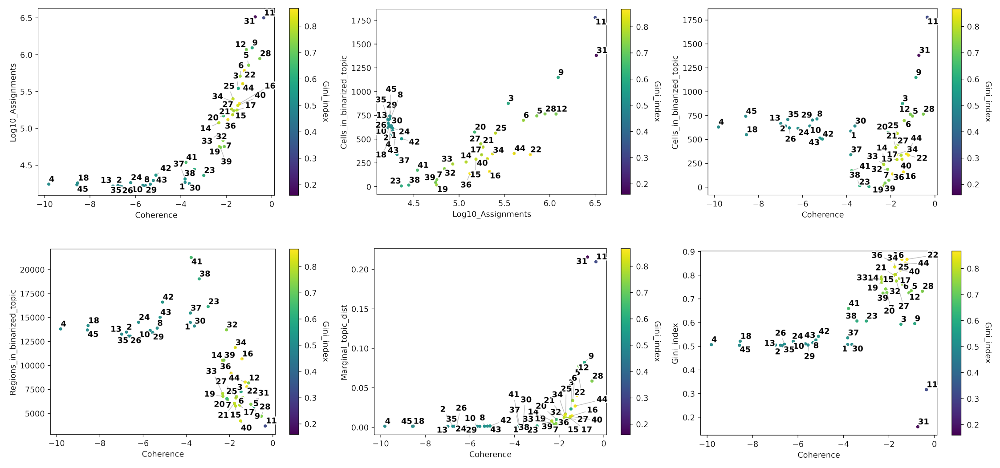

CNAG_2


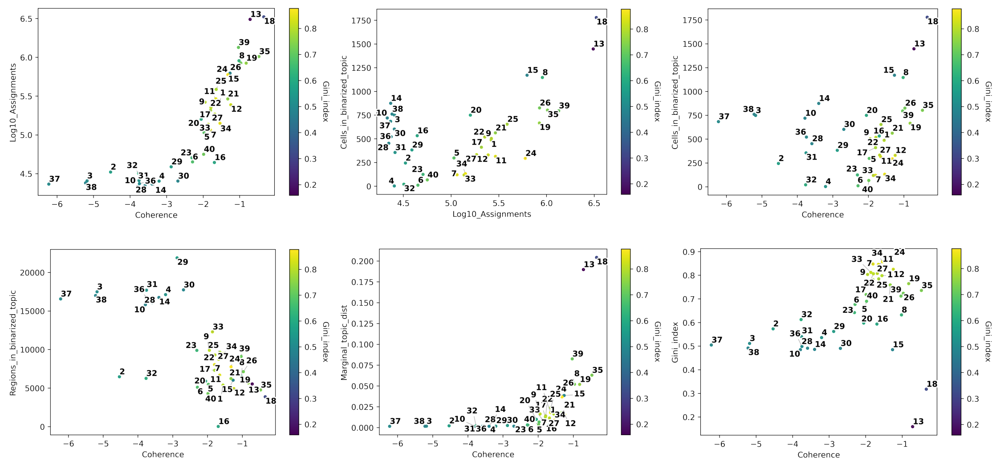

s3atac


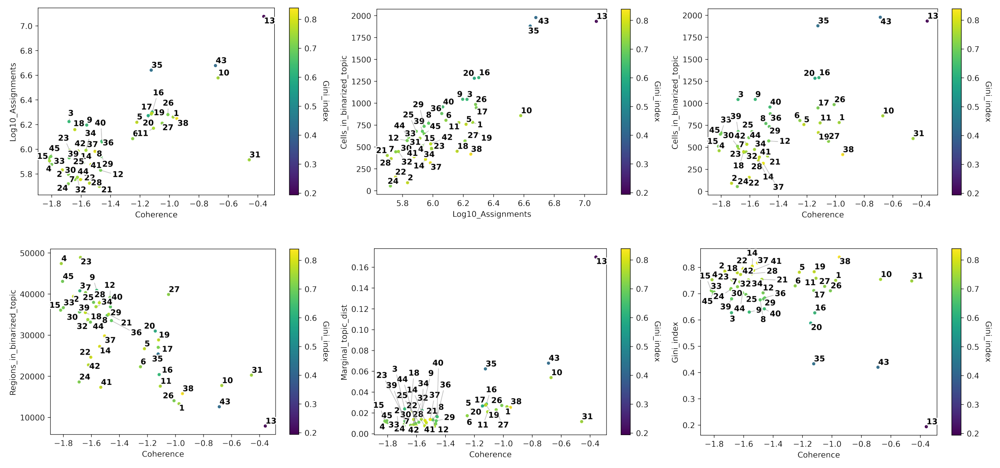

Sanger_1


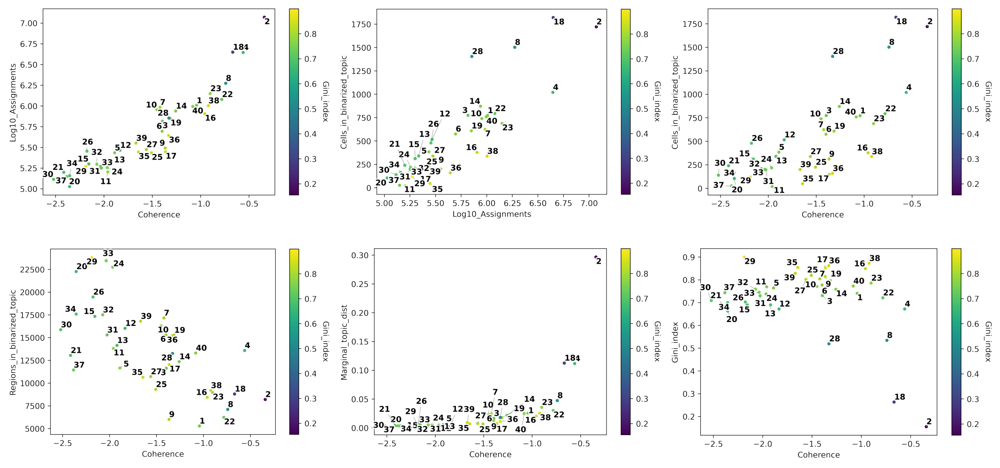

Sanger_2


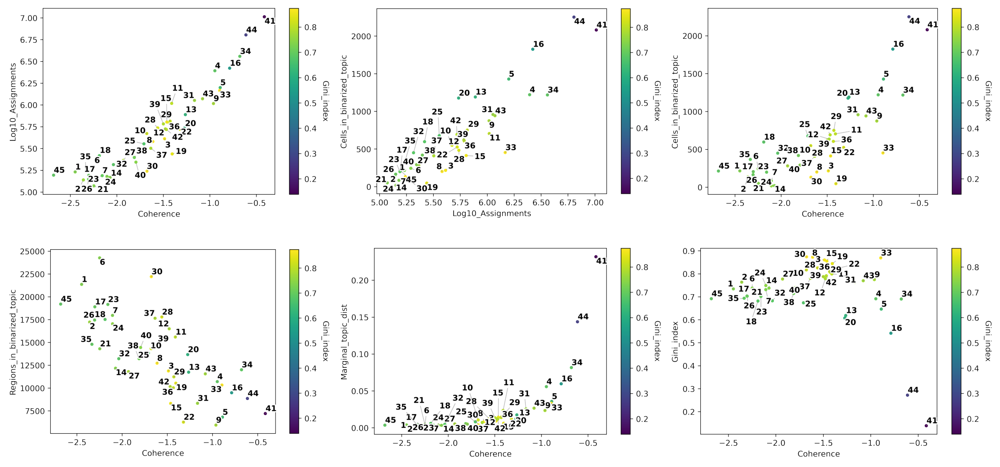

Stanford_1


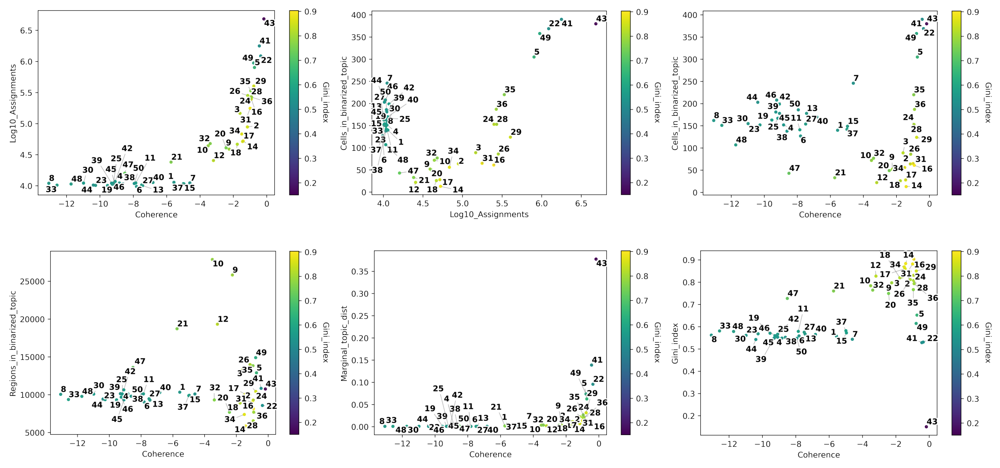

Stanford_2


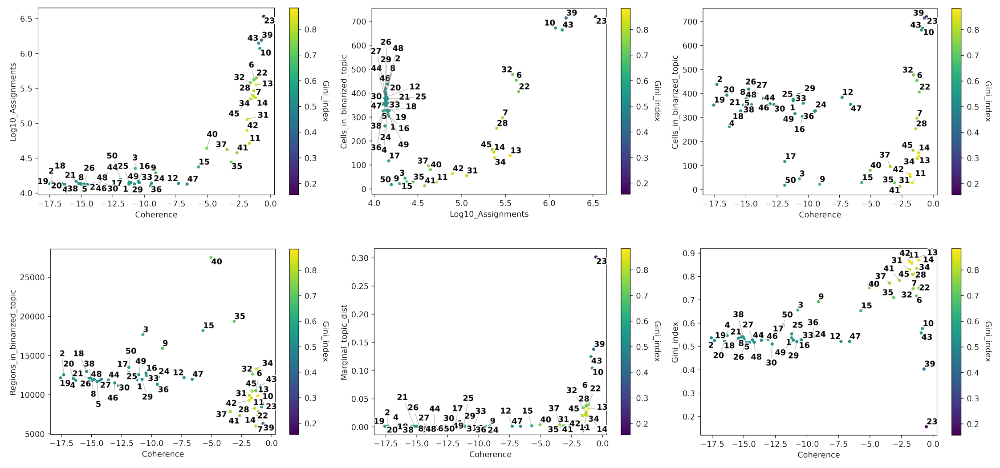

VIB_1


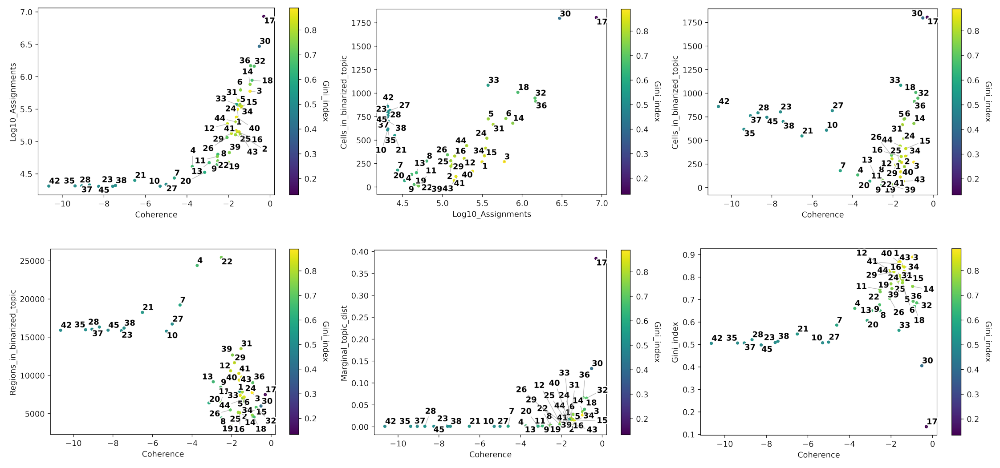

VIB_2


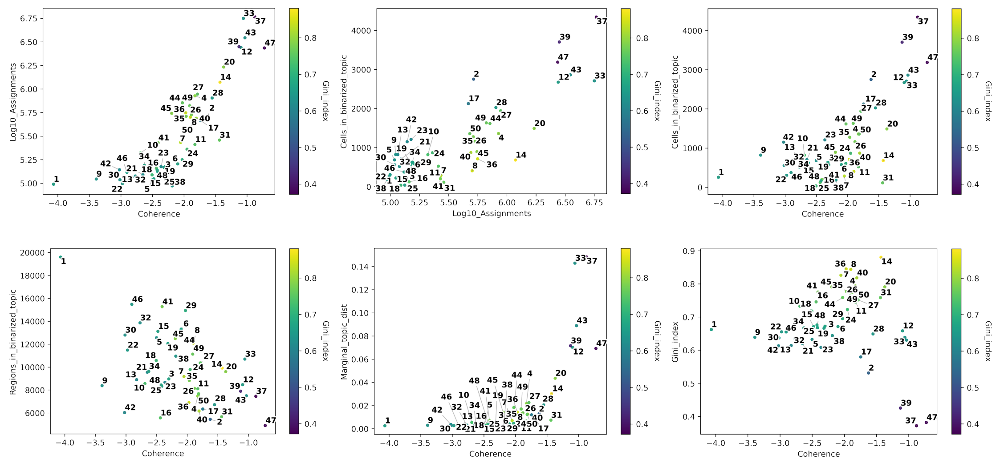

merged


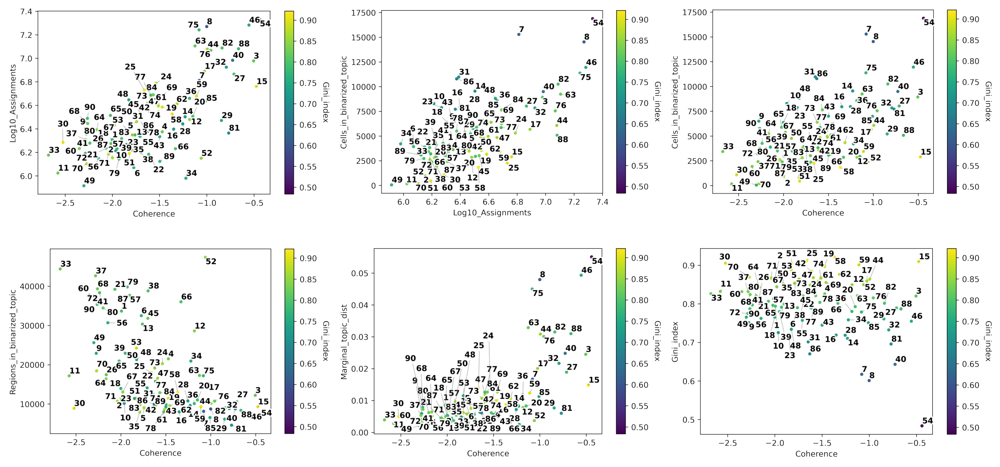

In [43]:
topic_qc_metrics_dict = {}
for key in cistopic_obj_dict.keys():
    print(key)
    topic_qc_metrics = compute_topic_metrics(
        cistopic_obj_dict[key]
    )

    fig_dict={}
    fig_dict['CoherenceVSAssignments']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Log10_Assignments', var_color='Gini_index', plot=False, return_fig=True)
    fig_dict['AssignmentsVSCells_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Log10_Assignments', var_y='Cells_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
    fig_dict['CoherenceVSCells_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Cells_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
    fig_dict['CoherenceVSRegions_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Regions_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
    fig_dict['CoherenceVSMarginal_dist']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Marginal_topic_dist', var_color='Gini_index', plot=False, return_fig=True)
    fig_dict['CoherenceVSGini_index']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Gini_index', var_color='Gini_index', plot=False, return_fig=True)

    fig=plt.figure(figsize=(40, 43))
    i = 1
    for fig_ in fig_dict.keys():
        plt.subplot(2, 3, i)
        img = fig2img(fig_dict[fig_]) #To convert figures to png to plot together, see .utils.py. This converts the figure to png.
        plt.imshow(img)
        plt.axis('off')
        i += 1
    plt.subplots_adjust(wspace=0, hspace=-0.70)
    #plt.tight_layout()
    plt.show()
    
    topic_qc_metrics_dict[key] = topic_qc_metrics.copy()

### Annotate topics

In [44]:
from pycisTopic.topic_qc import topic_annotation

In [45]:
for key in cistopic_obj_dict.keys():
    print(key)
    topic_annot = topic_annotation(
        cistopic_obj_dict[key],
        annot_var='consensus_cell_type',
        binarized_cell_topic=binarized_cell_topic_dict[key],
        general_topic_thr = 0.2
    )
    topic_qc_metrics_dict[key] = pd.concat(
        [ 
            topic_annot[['consensus_cell_type', 'Ratio_cells_in_topic', 'Ratio_group_in_population']],
            topic_qc_metrics_dict[key]
        ],
        axis=1
    )

Broad_1
Broad_2
Broad_mito_1
Broad_mito_2
CNAG_1
CNAG_2
s3atac
Sanger_1
Sanger_2
Stanford_1
Stanford_2
VIB_1
VIB_2
merged


## Differentially Accessible Regions (DARs)

In [46]:
from pycisTopic.diff_features import (
    impute_accessibility,
    normalize_scores,
    find_highly_variable_features,
    find_diff_features
)
from pycisTopic.clust_vis import plot_imputed_features
import numpy as np
import copy

Broad_1
2021-09-24 21:35:14,896 cisTopic     INFO     Imputing drop-outs
2021-09-24 21:35:15,500 cisTopic     INFO     Removing small values
2021-09-24 21:35:17,773 cisTopic     INFO     Converting to sparse matrix
2021-09-24 21:35:31,088 cisTopic     INFO     Scaling
2021-09-24 21:35:31,509 cisTopic     INFO     Keep non zero rows
2021-09-24 21:35:32,864 cisTopic     INFO     Create CistopicImputedFeatures object
2021-09-24 21:35:32,865 cisTopic     INFO     Done!
2021-09-24 21:35:32,866 cisTopic     INFO     Normalizing imputed data
2021-09-24 21:35:43,825 cisTopic     INFO     Done!
2021-09-24 21:35:43,830 cisTopic     INFO     Calculating mean and variance


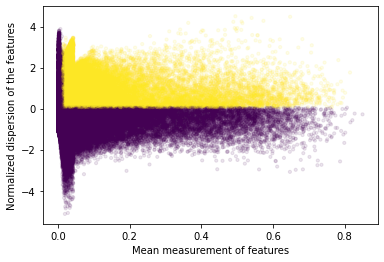

2021-09-24 21:36:08,429 cisTopic     INFO     Done!
Found 34708 variable regions


2021-09-24 21:36:12,343	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=25879) 2021-09-24 21:36:16,382 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=25877) 2021-09-24 21:36:16,376 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=25880) 2021-09-24 21:36:16,388 cisTopic     INFO     Computing p-value for B cell
(pid=25878) 2021-09-24 21:36:16,369 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=25881) 2021-09-24 21:36:16,382 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=25879) 2021-09-24 21:37:03,976 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=25877) 2021-09-24 21:37:04,415 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=25880) 2021-09-24 21:37:04,596 cisTopic     INFO     Computing log2FC for B cell
(pid=25881) 2021-09-24 21:37:04,520 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=25878) 2021-09-24 21:37:04,690 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=25879) 2021-09-24 21:37:38,678 cisTopic     INFO     CD16+ monocyte 

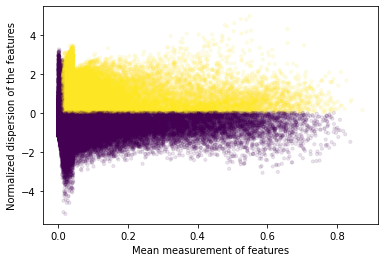

2021-09-24 21:39:50,198 cisTopic     INFO     Done!
Found 34845 variable regions


2021-09-24 21:39:53,635	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=26839) 2021-09-24 21:39:57,460 cisTopic     INFO     Computing p-value for B cell
(pid=26838) 2021-09-24 21:39:57,526 cisTopic     INFO     Computing p-value for Natural killer cell
(pid=26840) 2021-09-24 21:39:57,491 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=26841) 2021-09-24 21:39:57,516 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=26842) 2021-09-24 21:39:57,491 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=26840) 2021-09-24 21:40:44,857 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=26842) 2021-09-24 21:40:44,996 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=26838) 2021-09-24 21:40:45,178 cisTopic     INFO     Computing log2FC for Natural killer cell
(pid=26841) 2021-09-24 21:40:45,943 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=26839) 2021-09-24 21:40:46,373 cisTopic     INFO     Computing log2FC for B cell
(pid=26840) 2021-09-24 21:41:19,594 cisTopic     INFO     CD4+ 

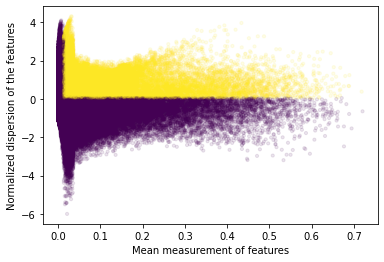

2021-09-24 21:42:23,894 cisTopic     INFO     Done!
Found 63654 variable regions


2021-09-24 21:42:27,833	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=27622) 2021-09-24 21:42:31,593 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=27618) 2021-09-24 21:42:31,644 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=27621) 2021-09-24 21:42:31,635 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=27620) 2021-09-24 21:42:31,634 cisTopic     INFO     Computing p-value for B cell
(pid=27619) 2021-09-24 21:42:31,681 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=27620) 2021-09-24 21:43:49,532 cisTopic     INFO     Computing log2FC for B cell
(pid=27622) 2021-09-24 21:43:49,601 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=27618) 2021-09-24 21:43:50,397 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=27619) 2021-09-24 21:43:50,852 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=27621) 2021-09-24 21:43:50,984 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=27620) 2021-09-24 21:44:46,723 cisTopic     INFO     B cell done!
(p

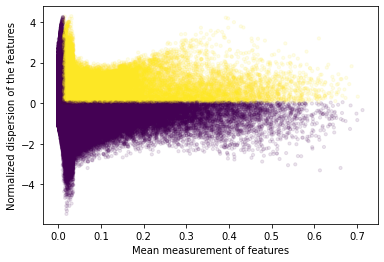

2021-09-24 21:48:01,227 cisTopic     INFO     Done!
Found 62887 variable regions


2021-09-24 21:48:05,211	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=28884) 2021-09-24 21:48:08,186 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=28882) 2021-09-24 21:48:08,186 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=28881) 2021-09-24 21:48:08,195 cisTopic     INFO     Computing p-value for B cell
(pid=28880) 2021-09-24 21:48:08,207 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=28883) 2021-09-24 21:48:08,211 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=28884) 2021-09-24 21:49:23,119 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=28880) 2021-09-24 21:49:23,707 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=28883) 2021-09-24 21:49:23,830 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=28881) 2021-09-24 21:49:23,999 cisTopic     INFO     Computing log2FC for B cell
(pid=28882) 2021-09-24 21:49:24,096 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=28884) 2021-09-24 21:50:18,429 cisTopic     INFO     Cytotoxic T cel

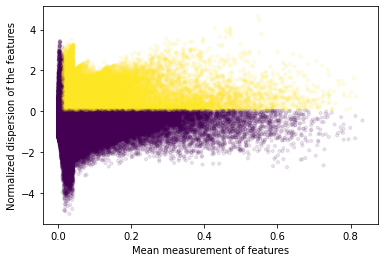

2021-09-24 21:53:10,085 cisTopic     INFO     Done!
Found 57458 variable regions


2021-09-24 21:53:13,652	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=30166) 2021-09-24 21:53:17,510 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=30163) 2021-09-24 21:53:17,481 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=30165) 2021-09-24 21:53:17,483 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=30164) 2021-09-24 21:53:17,454 cisTopic     INFO     Computing p-value for B cell
(pid=30162) 2021-09-24 21:53:17,512 cisTopic     INFO     Computing p-value for Natural killer cell
(pid=30165) 2021-09-24 21:54:17,830 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=30162) 2021-09-24 21:54:17,767 cisTopic     INFO     Computing log2FC for Natural killer cell
(pid=30163) 2021-09-24 21:54:18,584 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=30166) 2021-09-24 21:54:18,730 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=30164) 2021-09-24 21:54:19,824 cisTopic     INFO     Computing log2FC for B cell
(pid=30162) 2021-09-24 21:55:01,428 cisTopic     INFO     Natur

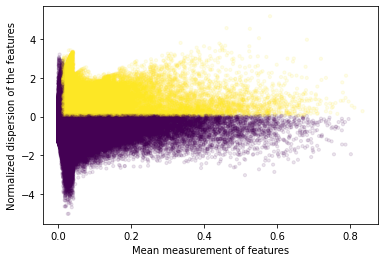

2021-09-24 21:55:43,318 cisTopic     INFO     Done!
Found 56652 variable regions


2021-09-24 21:55:46,824	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=30825) 2021-09-24 21:55:49,897 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=30823) 2021-09-24 21:55:49,912 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=30822) 2021-09-24 21:55:49,836 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=30821) 2021-09-24 21:55:49,897 cisTopic     INFO     Computing p-value for B cell
(pid=30824) 2021-09-24 21:55:49,927 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=30823) 2021-09-24 21:56:48,735 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=30822) 2021-09-24 21:56:49,159 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=30825) 2021-09-24 21:56:49,333 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=30824) 2021-09-24 21:56:49,521 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=30821) 2021-09-24 21:56:49,715 cisTopic     INFO     Computing log2FC for B cell
(pid=30823) 2021-09-24 21:57:32,057 cisTopic     INFO     Cytotoxic T cel

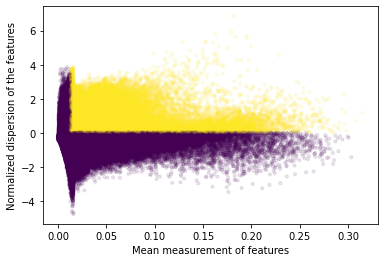

2021-09-24 22:01:34,769 cisTopic     INFO     Done!
Found 102167 variable regions


2021-09-24 22:01:39,448	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=32186) 2021-09-24 22:01:43,285 cisTopic     INFO     Computing p-value for B cell
(pid=32185) 2021-09-24 22:01:43,366 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=32187) 2021-09-24 22:01:43,370 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=32184) 2021-09-24 22:01:43,386 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=32183) 2021-09-24 22:01:43,718 cisTopic     INFO     Computing p-value for Dendritic cell
(pid=32185) 2021-09-24 22:03:43,310 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=32187) 2021-09-24 22:03:44,436 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=32183) 2021-09-24 22:03:44,461 cisTopic     INFO     Computing log2FC for Dendritic cell
(pid=32186) 2021-09-24 22:03:44,485 cisTopic     INFO     Computing log2FC for B cell
(pid=32184) 2021-09-24 22:03:49,127 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=32185) 2021-09-24 22:05:11,144 cisTopic     INFO     CD4+ T cell don

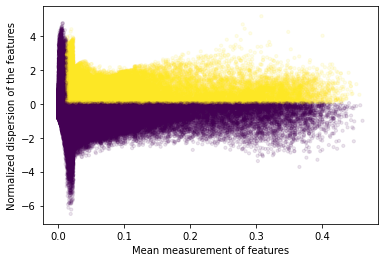

2021-09-24 22:09:46,805 cisTopic     INFO     Done!
Found 64839 variable regions


2021-09-24 22:09:50,924	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=33931) 2021-09-24 22:09:54,738 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=33927) 2021-09-24 22:09:54,742 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=33930) 2021-09-24 22:09:54,823 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=33928) 2021-09-24 22:09:54,791 cisTopic     INFO     Computing p-value for B cell
(pid=33929) 2021-09-24 22:09:54,821 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=33927) 2021-09-24 22:11:06,444 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=33928) 2021-09-24 22:11:06,659 cisTopic     INFO     Computing log2FC for B cell
(pid=33931) 2021-09-24 22:11:07,012 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=33929) 2021-09-24 22:11:07,219 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=33930) 2021-09-24 22:11:07,434 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=33928) 2021-09-24 22:11:59,279 cisTopic     INFO     B cell done!
(p

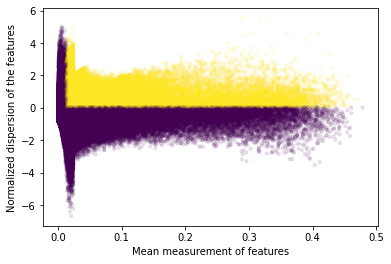

2021-09-24 22:15:25,271 cisTopic     INFO     Done!
Found 64470 variable regions


2021-09-24 22:15:29,721	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=35258) 2021-09-24 22:15:32,801 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=35257) 2021-09-24 22:15:32,833 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=35255) 2021-09-24 22:15:32,832 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=35259) 2021-09-24 22:15:32,732 cisTopic     INFO     Computing p-value for B cell
(pid=35260) 2021-09-24 22:15:32,770 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=35257) 2021-09-24 22:16:52,818 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=35259) 2021-09-24 22:16:52,967 cisTopic     INFO     Computing log2FC for B cell
(pid=35258) 2021-09-24 22:16:54,250 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=35260) 2021-09-24 22:16:54,266 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=35255) 2021-09-24 22:16:54,577 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=35257) 2021-09-24 22:17:51,511 cisTopic     INFO     CD16+ monocyte 

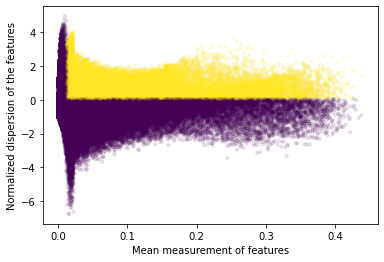

2021-09-24 22:20:31,609 cisTopic     INFO     Done!
Found 68439 variable regions


2021-09-24 22:20:35,047	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=36482) 2021-09-24 22:20:38,927 cisTopic     INFO     Computing p-value for B cell
(pid=36470) 2021-09-24 22:20:38,958 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=36481) 2021-09-24 22:20:38,949 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=36480) 2021-09-24 22:20:38,980 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=36483) 2021-09-24 22:20:38,969 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=36482) 2021-09-24 22:21:22,115 cisTopic     INFO     Computing log2FC for B cell
(pid=36470) 2021-09-24 22:21:22,160 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=36483) 2021-09-24 22:21:22,321 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=36481) 2021-09-24 22:21:22,603 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=36480) 2021-09-24 22:21:23,145 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=36482) 2021-09-24 22:21:53,597 cisTopic     INFO     B cell done!
(p

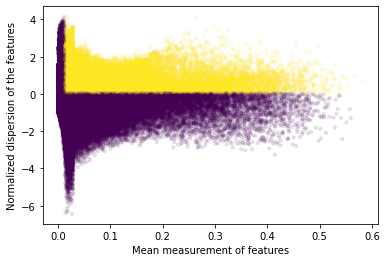

2021-09-24 22:23:40,452 cisTopic     INFO     Done!
Found 66777 variable regions


2021-09-24 22:23:43,998	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=875) 2021-09-24 22:23:46,981 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=872) 2021-09-24 22:23:46,969 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=873) 2021-09-24 22:23:46,972 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=874) 2021-09-24 22:23:47,032 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=869) 2021-09-24 22:23:47,032 cisTopic     INFO     Computing p-value for B cell
(pid=873) 2021-09-24 22:24:38,759 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=872) 2021-09-24 22:24:38,948 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=875) 2021-09-24 22:24:39,039 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=874) 2021-09-24 22:24:39,020 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=869) 2021-09-24 22:24:39,020 cisTopic     INFO     Computing log2FC for B cell
(pid=873) 2021-09-24 22:25:16,782 cisTopic     INFO     CD16+ monocyte done!
(pid=872) 2021-0

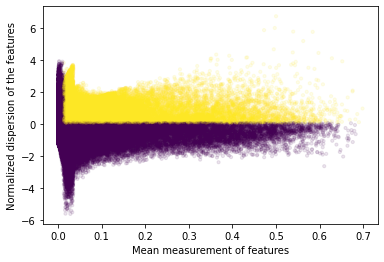

2021-09-24 22:27:31,337 cisTopic     INFO     Done!
Found 52471 variable regions


2021-09-24 22:27:35,045	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=1890) 2021-09-24 22:27:38,896 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=1888) 2021-09-24 22:27:38,962 cisTopic     INFO     Computing p-value for B cell
(pid=1891) 2021-09-24 22:27:38,880 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=1892) 2021-09-24 22:27:38,954 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=1889) 2021-09-24 22:27:38,982 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=1890) 2021-09-24 22:28:35,184 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=1891) 2021-09-24 22:28:35,675 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=1888) 2021-09-24 22:28:36,080 cisTopic     INFO     Computing log2FC for B cell
(pid=1889) 2021-09-24 22:28:36,809 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=1892) 2021-09-24 22:28:39,396 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=1890) 2021-09-24 22:29:16,411 cisTopic     INFO     CD16+ monocyte done!
(pid=

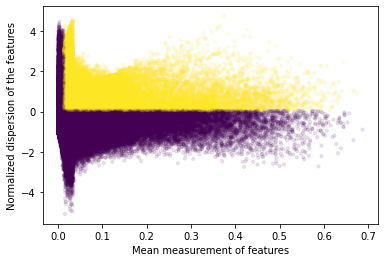

2021-09-24 22:33:08,683 cisTopic     INFO     Done!
Found 59849 variable regions


2021-09-24 22:33:14,281	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=3305) 2021-09-24 22:33:18,170 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=3306) 2021-09-24 22:33:18,222 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=3303) 2021-09-24 22:33:18,267 cisTopic     INFO     Computing p-value for B cell
(pid=3304) 2021-09-24 22:33:18,392 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=3307) 2021-09-24 22:33:18,809 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=3306) 2021-09-24 22:35:24,209 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=3303) 2021-09-24 22:35:24,285 cisTopic     INFO     Computing log2FC for B cell
(pid=3305) 2021-09-24 22:35:25,932 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=3304) 2021-09-24 22:35:26,878 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=3307) 2021-09-24 22:35:28,181 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=3306) 2021-09-24 22:36:57,786 cisTopic     INFO     CD16+ monocyte done!
(pid=

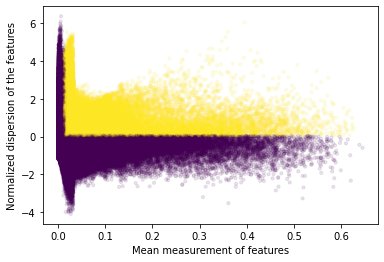

2021-09-24 23:02:14,879 cisTopic     INFO     Done!
Found 59479 variable regions


2021-09-24 23:02:42,112	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=8611) 2021-09-24 23:02:46,863 cisTopic     INFO     Computing p-value for B cell
(pid=8614) 2021-09-24 23:02:49,108 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=8613) 2021-09-24 23:02:51,693 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=8615) 2021-09-24 23:02:54,233 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=8612) 2021-09-24 23:02:56,707 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=8611) 2021-09-24 23:14:08,541 cisTopic     INFO     Computing log2FC for B cell
(pid=8614) 2021-09-24 23:14:10,853 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=8613) 2021-09-24 23:14:11,534 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=8612) 2021-09-24 23:14:16,477 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=8615) 2021-09-24 23:14:23,139 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=8611) 2021-09-24 23:22:37,428 cisTopic     INFO     B cell done!
(pid=8611) 20

In [47]:
imputed_acc_obj_dict = {}
markers_dict_dict = {}

for key in cistopic_obj_dict.keys():
    print(key)
    imputed_acc_obj = impute_accessibility(
        cistopic_obj_dict[key],
        selected_cells=None,
        selected_regions=None,
        scale_factor=10**6
    )
    normalized_imputed_acc_obj = normalize_scores(
        imputed_acc_obj,
        scale_factor=10**4
    )
    variable_regions = find_highly_variable_features(
        normalized_imputed_acc_obj,
        min_disp = 0.05,
        min_mean = 0.0125, 
        max_mean = 3,
        max_disp = np.inf,
        n_bins=20, 
        n_top_features=None,
        plot=True,
    )
    print(f"Found {len(variable_regions)} variable regions")
    markers_dict= find_diff_features(
        cistopic_obj_dict[key],
        imputed_acc_obj,
        variable='consensus_cell_type',
        var_features=variable_regions,
        contrasts=None,
        adjpval_thr=0.05,
        log2fc_thr=np.log2(1.5),
        n_cpu=5,
    )
    imputed_acc_obj_dict[key] = copy.copy(imputed_acc_obj)
    markers_dict_dict[key] = markers_dict.copy()

Broad_1
B cell: 8146
CD14+ monocyte: 15534
CD16+ monocyte: 14957
CD4+ T cell: 6150
Cytotoxic T cell: 4468
Dendritic cell: 7686
Natural killer cell: 5999


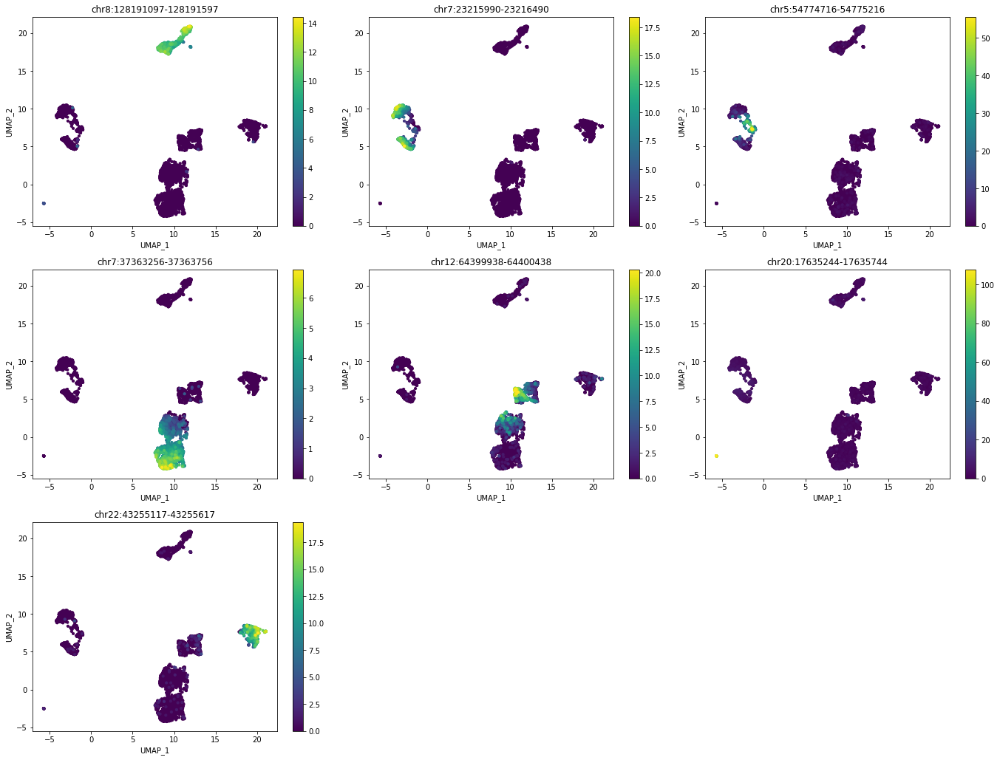

Broad_2
B cell: 8093
CD14+ monocyte: 16681
CD4+ T cell: 5824
Cytotoxic T cell: 5247
Natural killer cell: 5722


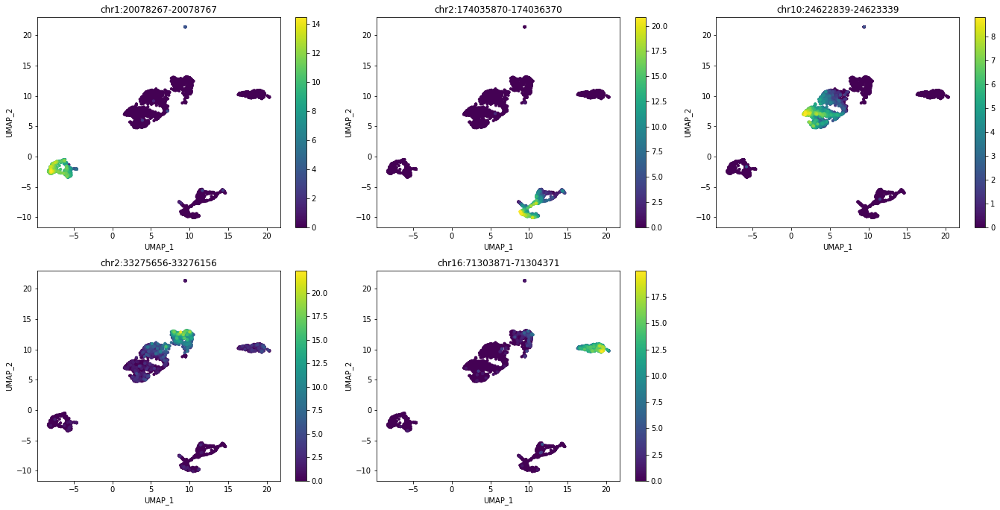

Broad_mito_1
B cell: 11085
CD14+ monocyte: 35392
CD16+ monocyte: 28642
CD4+ T cell: 15415
Cytotoxic T cell: 12297
Dendritic cell: 20343
Natural killer cell: 10361


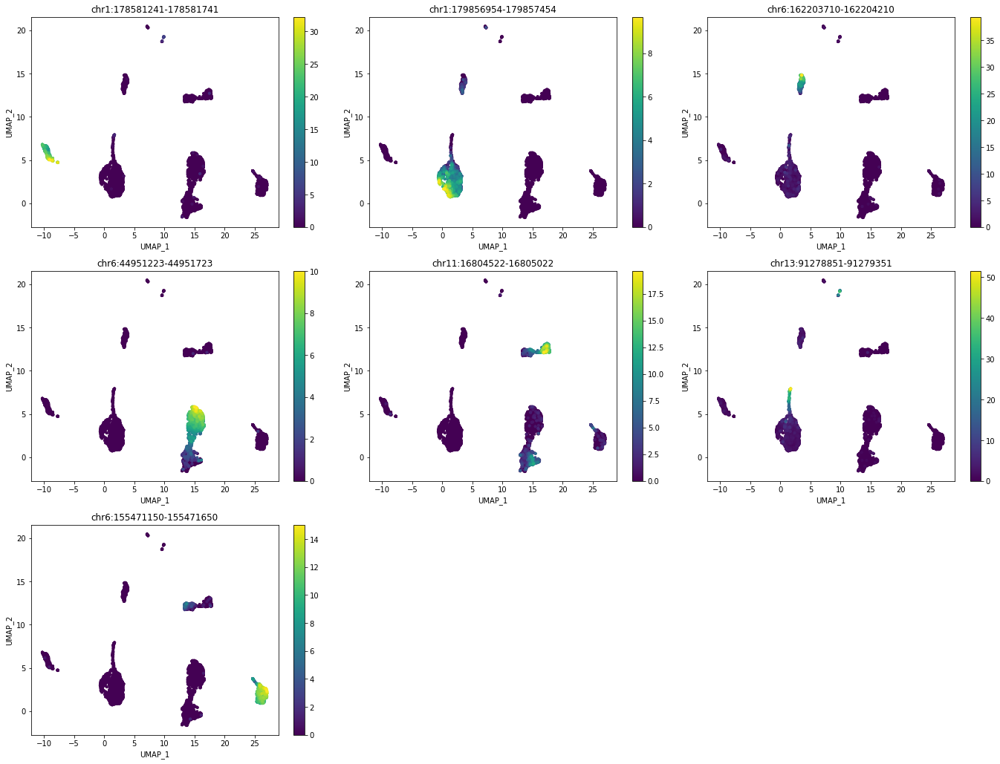

Broad_mito_2
B cell: 10499
CD14+ monocyte: 35307
CD16+ monocyte: 29911
CD4+ T cell: 14783
Cytotoxic T cell: 12299
Dendritic cell: 21556
Natural killer cell: 10647


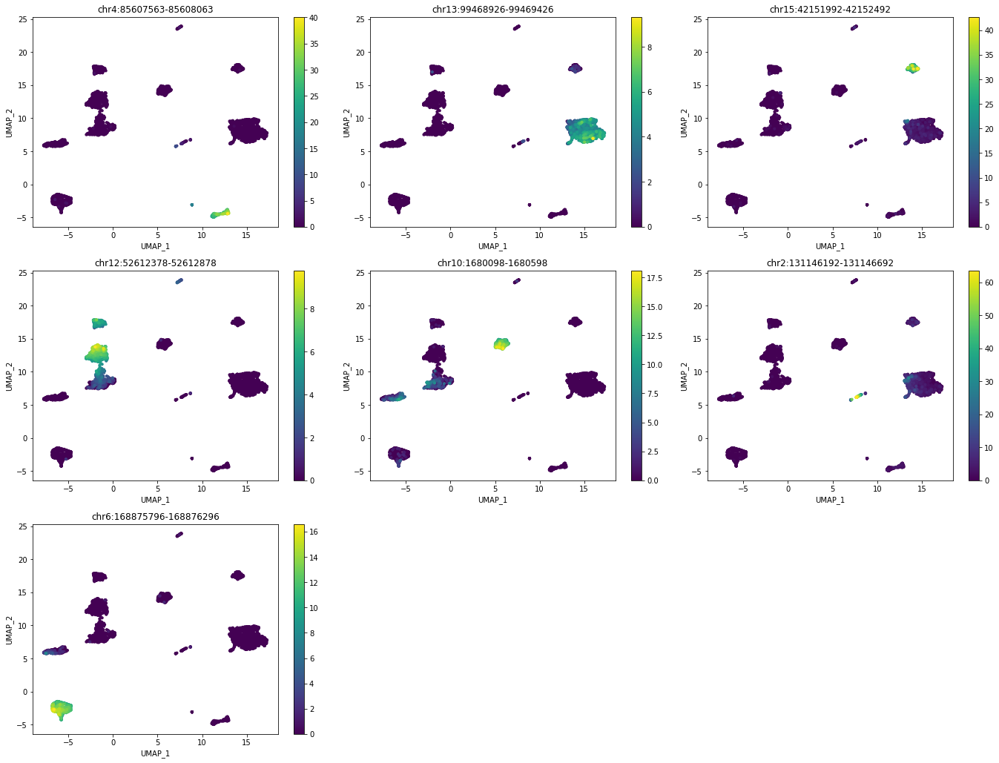

CNAG_1
B cell: 12514
CD14+ monocyte: 28480
CD4+ T cell: 12497
Cytotoxic T cell: 11306
Natural killer cell: 9828


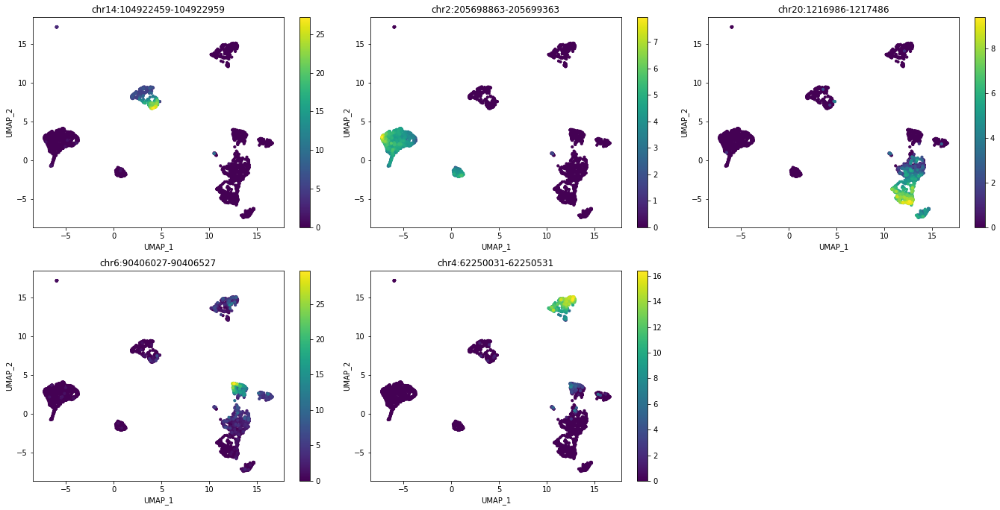

CNAG_2
B cell: 11599
CD14+ monocyte: 28487
CD16+ monocyte: 26694
CD4+ T cell: 12433
Cytotoxic T cell: 11369
Natural killer cell: 9464


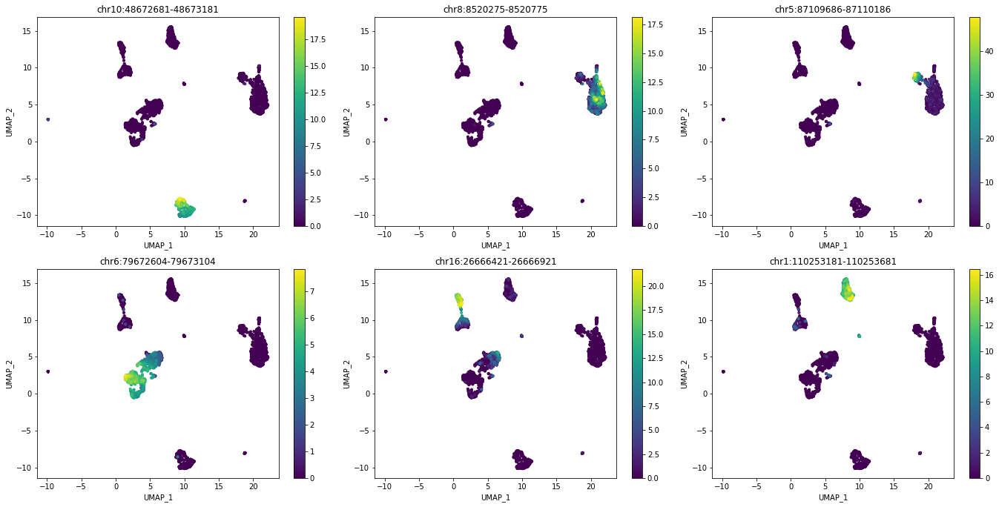

s3atac
B cell: 16166
CD14+ monocyte: 39008
CD4+ T cell: 22457
Cytotoxic T cell: 20575
Dendritic cell: 25916
Natural killer cell: 13402


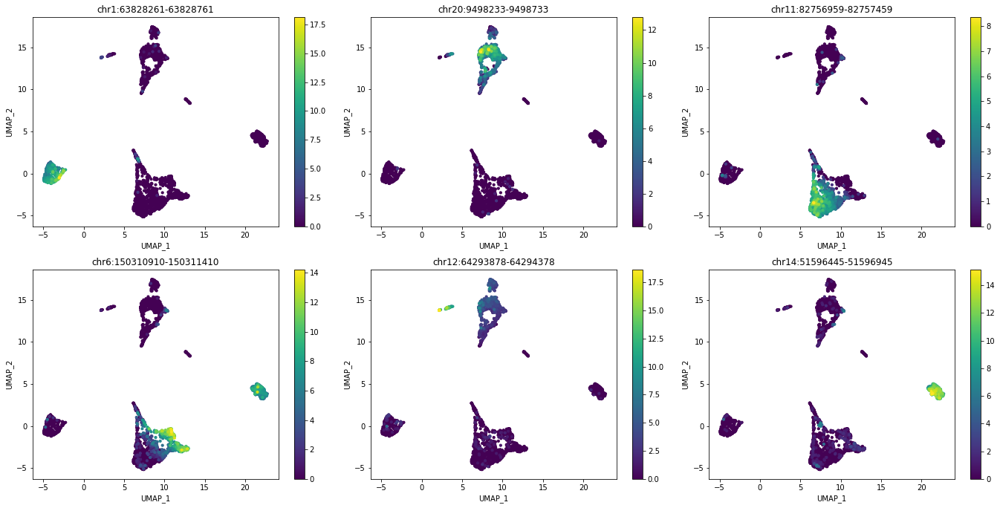

Sanger_1
B cell: 11847
CD14+ monocyte: 33921
CD16+ monocyte: 29592
CD4+ T cell: 13077
Cytotoxic T cell: 11939
Natural killer cell: 10675


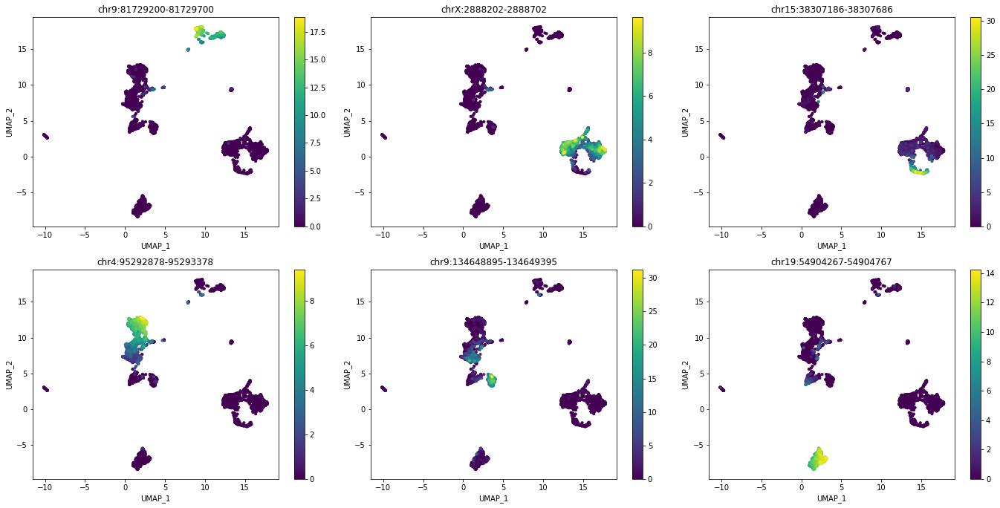

Sanger_2
B cell: 11915
CD14+ monocyte: 33737
CD16+ monocyte: 28443
CD4+ T cell: 13255
Cytotoxic T cell: 11483
Natural killer cell: 10436


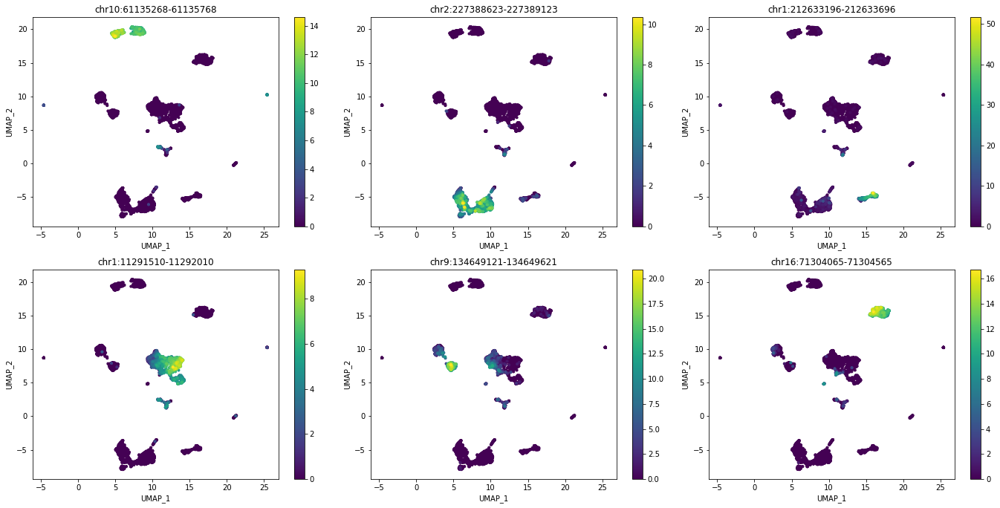

Stanford_1
B cell: 11630
CD14+ monocyte: 36206
CD16+ monocyte: 21525
CD4+ T cell: 18030
Cytotoxic T cell: 14476
Natural killer cell: 13371


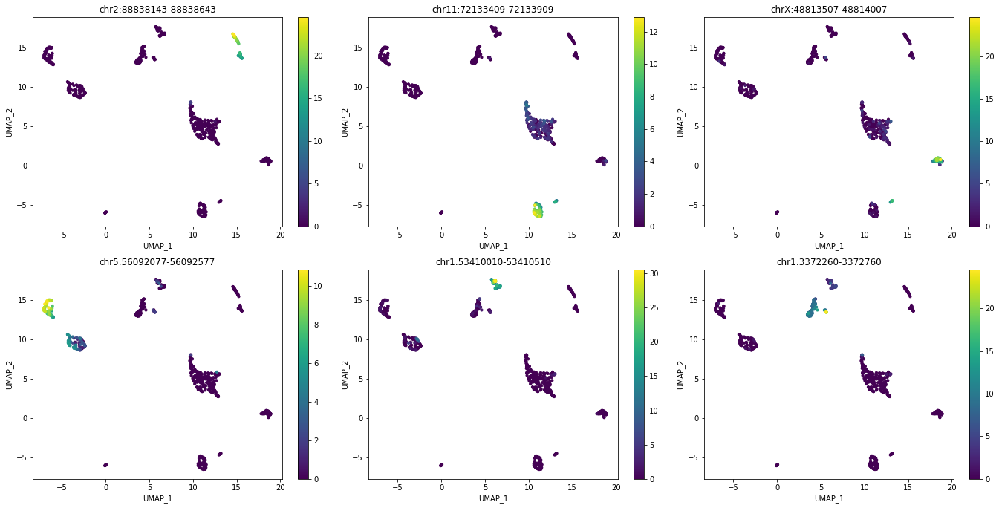

Stanford_2
B cell: 12063
CD14+ monocyte: 34633
CD16+ monocyte: 23946
CD4+ T cell: 17116
Cytotoxic T cell: 10112
Dendritic cell: 11706
Natural killer cell: 11907


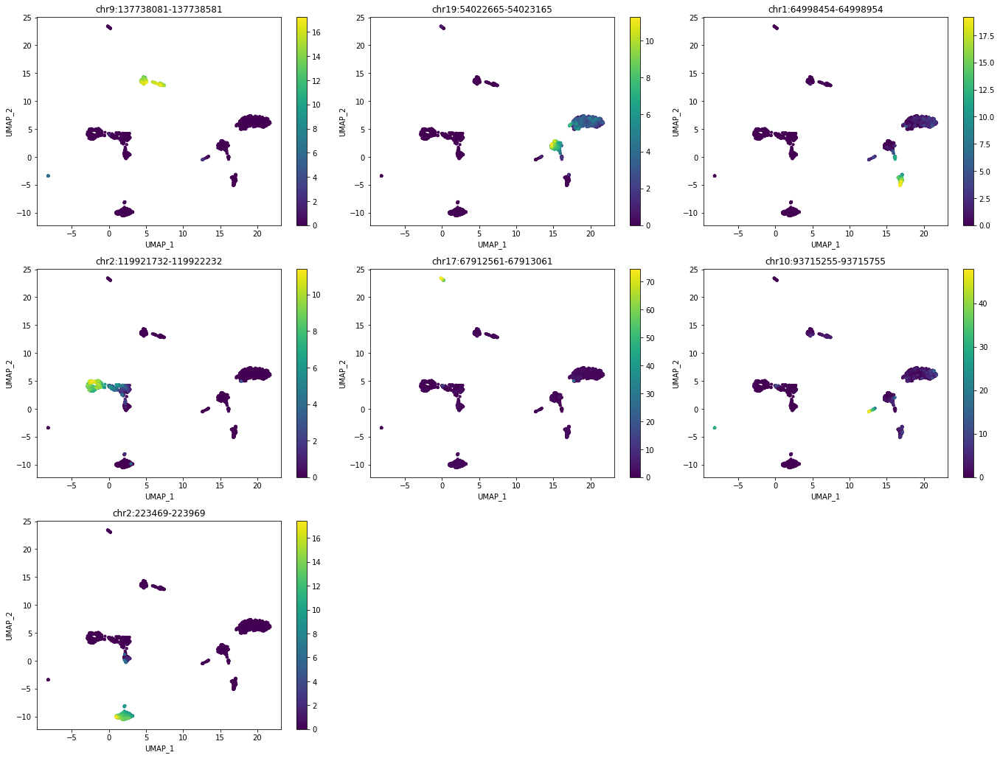

VIB_1
B cell: 10588
CD14+ monocyte: 25643
CD16+ monocyte: 22770
CD4+ T cell: 12125
Cytotoxic T cell: 10278
Dendritic cell: 17658
Natural killer cell: 8811


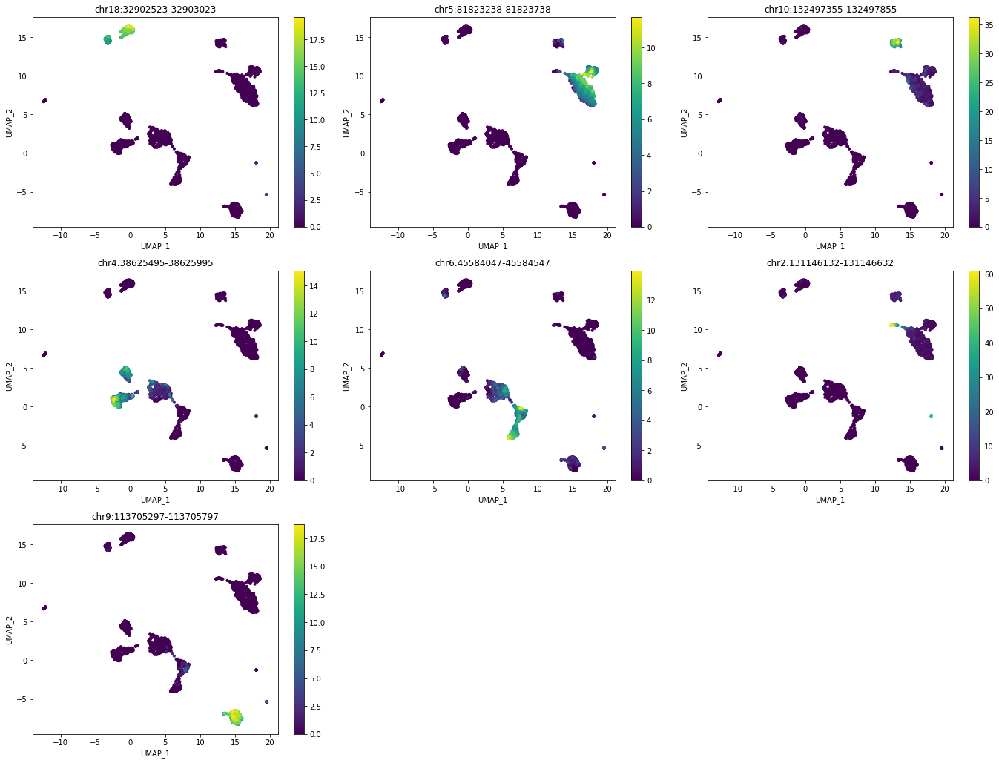

VIB_2
B cell: 10755
CD14+ monocyte: 31740
CD16+ monocyte: 27098
CD4+ T cell: 13536
Cytotoxic T cell: 11694
Dendritic cell: 12630
Natural killer cell: 9790


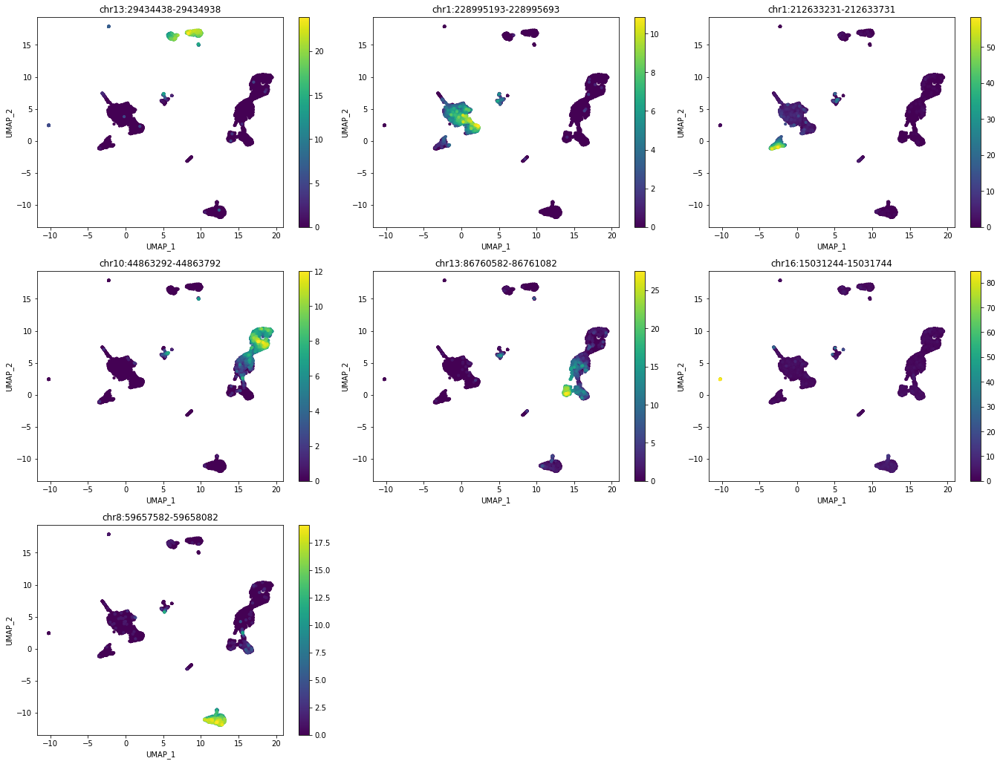

merged
B cell: 10972
CD14+ monocyte: 30675
CD16+ monocyte: 28120
CD4+ T cell: 13442
Cytotoxic T cell: 11464
Dendritic cell: 21187
Natural killer cell: 9998


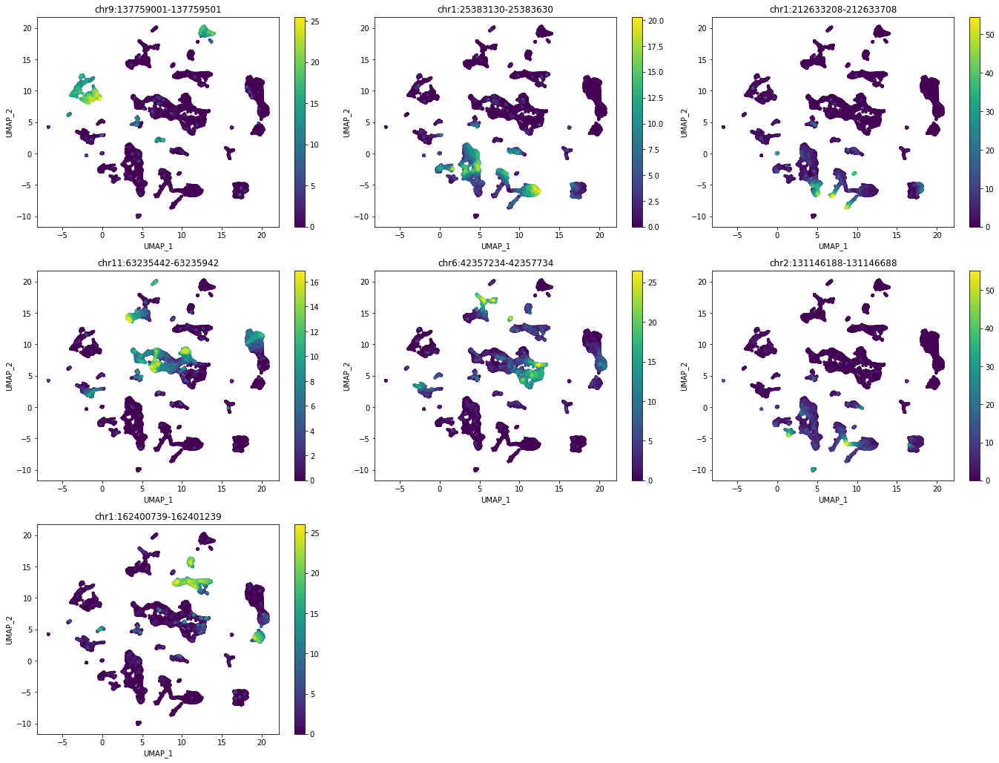

In [48]:
for key in cistopic_obj_dict.keys():
    print(key)
    [ print(x + ': '+ str(len(markers_dict_dict[key][x]))) for x in markers_dict_dict[key].keys() ]
    plot_imputed_features(
        cistopic_obj_dict[key],
        reduction_name='UMAP',
        imputed_data=imputed_acc_obj_dict[key],
        features=[markers_dict_dict[key][x].index.tolist()[0] for x in markers_dict_dict[key].keys()],
        #['B cell', 'CD14+ monocyte', 'CD4+ T cell', 'Cytotoxic T cell', 'Natural killer cell']
        scale=False,
        num_columns=3,
        selected_cells = cistopic_obj_dict[key].projections['cell']['UMAP'].index.tolist(),
    )

#### Save/load

In [49]:
f_out = os.path.join(f_final_dir, 'region_bin_topics.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        region_bin_topics_dict = pickle.load(f)
else:
    with open(f_out, 'wb') as f:
        pickle.dump(region_bin_topics_dict, f)

In [50]:
f_out = os.path.join(f_final_dir, 'binarized_cell_topic.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        binarized_cell_topic_dict = pickle.load(f)
else:
    with open(f_out, 'wb') as f:
        pickle.dump(binarized_cell_topic_dict, f)

In [51]:
f_out = os.path.join(f_final_dir, 'imputed_acc_obj.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        imputed_acc_obj_dict = pickle.load(f)
else:
    with open(f_out, 'wb') as f:
        pickle.dump(imputed_acc_obj_dict, f)

In [52]:
f_out = os.path.join(f_final_dir, 'markers_dict.pkl')
if os.path.isfile(f_out):
    print(f"Loading {f_out}")
    with open(f_out, 'rb') as f:
        markers_dict_dict = pickle.load(f)
else:
    with open(f_out, 'wb') as f:
        pickle.dump(markers_dict_dict, f)

## Gene activity

In [53]:
import pyranges as pr
import requests
import pybiomart as pbm

### Get gene annotations and chromosome sizes

In [54]:
# For human
dataset = pbm.Dataset(name='hsapiens_gene_ensembl',  host='http://www.ensembl.org')
annot = dataset.query(attributes=['chromosome_name', 'start_position', 'end_position', 'strand', 'external_gene_name', 'transcription_start_site', 'transcript_biotype'])
annot['Chromosome/scaffold name'] = 'chr' + annot['Chromosome/scaffold name'].astype(str)
annot.columns=['Chromosome', 'Start', 'End', 'Strand', 'Gene','Transcription_Start_Site', 'Transcript_type']
annot = annot[annot.Transcript_type == 'protein_coding']
annot.Strand[annot.Strand == 1] = '+'
annot.Strand[annot.Strand == -1] = '-'
pr_annotation = pr.PyRanges(annot.dropna(axis = 0))
pr_annotation

,Chromosome,Start,End,Strand,Gene,Transcription_Start_Site,Transcript_type
0,chr1,1471765,1497848,+,ATAD3B,1471765,protein_coding
1,chr1,1471765,1497848,+,ATAD3B,1471784,protein_coding
2,chr1,6624866,6635586,+,THAP3,6624866,protein_coding
3,chr1,6624866,6635586,+,THAP3,6625181,protein_coding
4,chr1,6624866,6635586,+,THAP3,6625192,protein_coding
...,...,...,...,...,...,...,...
84416,chrY,13234577,13480673,-,UTY,13479991,protein_coding
84417,chrY,13234577,13480673,-,UTY,13479665,protein_coding
84418,chrY,13234577,13480673,-,UTY,13480670,protein_coding
84419,chrY,13234577,13480673,-,UTY,13479978,protein_coding


In [55]:
# get chromosome sizes (hg38)
target_url = 'http://hgdownload.cse.ucsc.edu/goldenPath/hg38/bigZips/hg38.chrom.sizes'
chromsizes = pd.read_csv(target_url, sep='\t', header=None)
chromsizes.columns = ['Chromosome', 'End']
chromsizes['Start'] = [0]*chromsizes.shape[0]
chromsizes = chromsizes.loc[:,['Chromosome', 'Start', 'End']]
chromsizes = pr.PyRanges(chromsizes)
chromsizes

,Chromosome,Start,End
0,chr1,0,248956422
1,chr1_GL383518v1_alt,0,182439
2,chr1_GL383519v1_alt,0,110268
3,chr1_GL383520v2_alt,0,366580
4,chr1_KI270706v1_random,0,175055
...,...,...,...
450,chrX_KI270880v1_alt,0,284869
451,chrX_KI270881v1_alt,0,144206
452,chrX_KI270913v1_alt,0,274009
453,chrY,0,57227415


### Infer gene activity

In [56]:
from pycisTopic.gene_activity import get_gene_activity
from pycisTopic.diff_features import find_diff_features

In [57]:
gene_act_dict = {}

for key in cistopic_obj_dict.keys():
    print(key)
    gene_act, weights = get_gene_activity(
        imputed_acc_obj_dict[key], # Region-cell probabilities
        pr_annotation, # Gene annotation
        chromsizes, # Chromosome size
        use_gene_boundaries=True, # Whether to use the whole search space or stop when encountering another gene
        upstream=[1000, 100000], # Search space upstream. The minimum means that even if there is a gene right next to it 
                                 #these bp will be taken (1kbp here)
        downstream=[1000,100000], # Search space downstream
        distance_weight=True, # Whether to add a distance weight (an exponential function, the weight will decrease with distance)
        decay_rate=1, # Exponent for the distance exponential funciton (the higher the faster will be the decrease)
        extend_gene_body_upstream=10000, # Number of bp upstream immune to the distance weight (their value will be maximum for 
                                         #this weight)
        extend_gene_body_downstream=500, # Number of bp downstream immune to the distance weight
        gene_size_weight=False, # Whether to add a weights based on the length of the gene
        gene_size_scale_factor='median', # Dividend to calculate the gene size weigth. Default is the median value of all genes
                                         #in the genome
        remove_promoters=False, # Whether to remove promoters when computing gene activity scores
        average_scores=True, # Whether to divide by the total number of region assigned to a gene when calculating the gene 
                             # activity score
        scale_factor=1, # Value to multiply for the final gene activity matrix
        extend_tss=[10,10], # Space to consider a promoter
        gini_weight = True, # Whether to add a gini index weigth. The more unique the region is, the higher this weight will be
        return_weights= True, # Whether to return the final weights
        project='Gene_activity') # Project name for the gene activity object
    gene_act_dict[key] = copy.copy(gene_act)


Broad_1
2021-09-24 23:56:04,733 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-24 23:56:15,407 cisTopic     INFO     Calculating distances
2021-09-24 23:56:48,246 cisTopic     INFO     Calculating distance weigths
2021-09-24 23:56:49,065 cisTopic     INFO     Distance weights done
2021-09-24 23:56:49,066 cisTopic     INFO     Calculating gini weights
2021-09-24 23:57:34,280 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:01:23,567 cisTopic     INFO     Creating imputed features object
Broad_2
2021-09-25 00:01:29,144 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:01:39,784 cisTopic     INFO     Calculating distances
2021-09-25 00:02:09,618 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:02:10,421 cisTopic     INFO     Distance weights done
2021-09-25 00:02:10,424 cisTopic     INFO     Calculating gini weights
2021-09-25 00:02:51,570 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:06:11,927 cisTopic     INFO     Creating imputed features object
Broad_mito_1
2021-09-25 00:06:18,492 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:06:29,530 cisTopic     INFO     Calculating distances
2021-09-25 00:07:06,587 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:07:07,571 cisTopic     INFO     Distance weights done
2021-09-25 00:07:07,573 cisTopic     INFO     Calculating gini weights
2021-09-25 00:08:03,599 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:12:44,699 cisTopic     INFO     Creating imputed features object
Broad_mito_2
2021-09-25 00:12:51,223 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:13:01,664 cisTopic     INFO     Calculating distances
2021-09-25 00:13:37,210 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:13:38,033 cisTopic     INFO     Distance weights done
2021-09-25 00:13:38,034 cisTopic     INFO     Calculating gini weights
2021-09-25 00:14:26,342 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:18:47,135 cisTopic     INFO     Creating imputed features object
CNAG_1
2021-09-25 00:18:52,777 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:19:03,418 cisTopic     INFO     Calculating distances
2021-09-25 00:19:33,862 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:19:34,692 cisTopic     INFO     Distance weights done
2021-09-25 00:19:34,695 cisTopic     INFO     Calculating gini weights
2021-09-25 00:20:12,311 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:24:00,140 cisTopic     INFO     Creating imputed features object
CNAG_2
2021-09-25 00:24:06,287 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:24:17,127 cisTopic     INFO     Calculating distances
2021-09-25 00:24:47,020 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:24:47,857 cisTopic     INFO     Distance weights done
2021-09-25 00:24:47,859 cisTopic     INFO     Calculating gini weights
2021-09-25 00:25:23,308 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:28:58,201 cisTopic     INFO     Creating imputed features object
s3atac
2021-09-25 00:29:07,343 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:29:18,272 cisTopic     INFO     Calculating distances
2021-09-25 00:30:36,550 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:30:37,900 cisTopic     INFO     Distance weights done
2021-09-25 00:30:37,901 cisTopic     INFO     Calculating gini weights
2021-09-25 00:32:27,877 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:42:04,000 cisTopic     INFO     Creating imputed features object
Sanger_1
2021-09-25 00:42:10,378 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:42:21,035 cisTopic     INFO     Calculating distances
2021-09-25 00:43:12,133 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:43:13,160 cisTopic     INFO     Distance weights done
2021-09-25 00:43:13,161 cisTopic     INFO     Calculating gini weights
2021-09-25 00:44:17,855 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:50:30,759 cisTopic     INFO     Creating imputed features object
Sanger_2
2021-09-25 00:50:37,676 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:50:47,994 cisTopic     INFO     Calculating distances
2021-09-25 00:51:40,780 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:51:41,912 cisTopic     INFO     Distance weights done
2021-09-25 00:51:41,914 cisTopic     INFO     Calculating gini weights
2021-09-25 00:52:55,241 cisTopic     INFO     Getting gene activity scores
2021-09-25 00:59:02,679 cisTopic     INFO     Creating imputed features object
Stanford_1
2021-09-25 00:59:07,452 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 00:59:17,946 cisTopic     INFO     Calculating distances
2021-09-25 00:59:56,071 cisTopic     INFO     Calculating distance weigths
2021-09-25 00:59:56,935 cisTopic     INFO     Distance weights done
2021-09-25 00:59:56,936 cisTopic     INFO     Calculating gini weights
2021-09-25 01:00:26,273 cisTopic     INFO     Getting gene activity scores
2021-09-25 01:05:15,412 cisTopic     INFO     Creating imputed features object
Stanford_2
2021-09-25 01:05:22,179 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 01:05:32,597 cisTopic     INFO     Calculating distances
2021-09-25 01:06:12,802 cisTopic     INFO     Calculating distance weigths
2021-09-25 01:06:13,711 cisTopic     INFO     Distance weights done
2021-09-25 01:06:13,712 cisTopic     INFO     Calculating gini weights
2021-09-25 01:06:50,632 cisTopic     INFO     Getting gene activity scores
2021-09-25 01:11:40,834 cisTopic     INFO     Creating imputed features object
VIB_1
2021-09-25 01:11:47,770 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 01:11:58,188 cisTopic     INFO     Calculating distances
2021-09-25 01:12:33,189 cisTopic     INFO     Calculating distance weigths
2021-09-25 01:12:34,087 cisTopic     INFO     Distance weights done
2021-09-25 01:12:34,088 cisTopic     INFO     Calculating gini weights
2021-09-25 01:13:15,759 cisTopic     INFO     Getting gene activity scores
2021-09-25 01:17:23,664 cisTopic     INFO     Creating imputed features object
VIB_2
2021-09-25 01:17:32,185 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 01:17:42,283 cisTopic     INFO     Calculating distances
2021-09-25 01:18:22,365 cisTopic     INFO     Calculating distance weigths
2021-09-25 01:18:23,264 cisTopic     INFO     Distance weights done
2021-09-25 01:18:23,265 cisTopic     INFO     Calculating gini weights
2021-09-25 01:19:58,320 cisTopic     INFO     Getting gene activity scores
2021-09-25 01:25:07,429 cisTopic     INFO     Creating imputed features object
merged
2021-09-25 01:25:55,156 cisTopic     INFO     Calculating gene boundaries


join: Strand data from other will be added as strand data to self.
If this is undesired use the flag apply_strand_suffix=False.
To turn off the warning set apply_strand_suffix to True or False.


2021-09-25 01:26:05,218 cisTopic     INFO     Calculating distances
2021-09-25 01:27:20,843 cisTopic     INFO     Calculating distance weigths
2021-09-25 01:27:22,448 cisTopic     INFO     Distance weights done
2021-09-25 01:27:22,449 cisTopic     INFO     Calculating gini weights
2021-09-25 01:41:32,797 cisTopic     INFO     Getting gene activity scores
2021-09-25 01:52:38,713 cisTopic     INFO     Creating imputed features object


### Infer the Differentially Accessible Genes (DAGs)

In [58]:
from pycisTopic.clust_vis import plot_imputed_features

In [59]:
dag_markers_dict = {}
for key in cistopic_obj_dict.keys():
    print(key)
    dag_markers_dict[key] = find_diff_features(cistopic_obj_dict[key],
                      gene_act_dict[key],
                      variable='consensus_cell_type',
                      var_features=None,
                      contrasts=None,
                      adjpval_thr=0.05,
                      log2fc_thr=np.log2(1.5),
                      n_cpu=5,
                      )

Broad_1


2021-09-25 01:52:48,593	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=1092) 2021-09-25 01:52:52,820 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=1094) 2021-09-25 01:52:52,849 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=1091) 2021-09-25 01:52:52,782 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=1093) 2021-09-25 01:52:52,832 cisTopic     INFO     Computing p-value for B cell
(pid=1095) 2021-09-25 01:52:52,867 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=1091) 2021-09-25 01:53:04,756 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=1094) 2021-09-25 01:53:04,787 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=1095) 2021-09-25 01:53:04,807 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=1093) 2021-09-25 01:53:04,903 cisTopic     INFO     Computing log2FC for B cell
(pid=1092) 2021-09-25 01:53:05,058 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=1094) 2021-09-25 01:53:09,305 cisTopic     INFO     CD4+ T cell done!
(pid=109

2021-09-25 01:53:32,397	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=1623) 2021-09-25 01:53:36,012 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=1621) 2021-09-25 01:53:36,034 cisTopic     INFO     Computing p-value for Natural killer cell
(pid=1625) 2021-09-25 01:53:36,097 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=1624) 2021-09-25 01:53:36,085 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=1622) 2021-09-25 01:53:36,066 cisTopic     INFO     Computing p-value for B cell
(pid=1625) 2021-09-25 01:53:47,605 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=1622) 2021-09-25 01:53:47,623 cisTopic     INFO     Computing log2FC for B cell
(pid=1623) 2021-09-25 01:53:47,683 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=1624) 2021-09-25 01:53:47,900 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=1621) 2021-09-25 01:53:48,259 cisTopic     INFO     Computing log2FC for Natural killer cell
(pid=1625) 2021-09-25 01:53:52,014 cisTopic     INFO     CD14+ monocyte d

2021-09-25 01:53:59,432	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=1943) 2021-09-25 01:54:02,958 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=1946) 2021-09-25 01:54:02,948 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=1942) 2021-09-25 01:54:03,013 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=1945) 2021-09-25 01:54:03,013 cisTopic     INFO     Computing p-value for B cell
(pid=1944) 2021-09-25 01:54:03,029 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=1942) 2021-09-25 01:54:13,779 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=1943) 2021-09-25 01:54:13,885 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=1946) 2021-09-25 01:54:13,894 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=1945) 2021-09-25 01:54:13,913 cisTopic     INFO     Computing log2FC for B cell
(pid=1944) 2021-09-25 01:54:13,969 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=1946) 2021-09-25 01:54:18,029 cisTopic     INFO     CD4+ T cell done!
(pid=194

2021-09-25 01:54:38,870	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=2321) 2021-09-25 01:54:42,931 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=2319) 2021-09-25 01:54:43,040 cisTopic     INFO     Computing p-value for B cell
(pid=2318) 2021-09-25 01:54:43,024 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=2320) 2021-09-25 01:54:43,035 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=2317) 2021-09-25 01:54:43,007 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=2321) 2021-09-25 01:54:53,366 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=2319) 2021-09-25 01:54:53,460 cisTopic     INFO     Computing log2FC for B cell
(pid=2320) 2021-09-25 01:54:53,380 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=2318) 2021-09-25 01:54:53,490 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=2317) 2021-09-25 01:54:53,653 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=2321) 2021-09-25 01:54:57,325 cisTopic     INFO     CD4+ T cell done!
(pid=232

2021-09-25 01:55:18,019	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=2729) 2021-09-25 01:55:21,546 cisTopic     INFO     Computing p-value for B cell
(pid=2727) 2021-09-25 01:55:21,568 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=2730) 2021-09-25 01:55:21,588 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=2728) 2021-09-25 01:55:21,578 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=2726) 2021-09-25 01:55:21,577 cisTopic     INFO     Computing p-value for Natural killer cell
(pid=2726) 2021-09-25 01:55:30,244 cisTopic     INFO     Computing log2FC for Natural killer cell
(pid=2729) 2021-09-25 01:55:30,388 cisTopic     INFO     Computing log2FC for B cell
(pid=2730) 2021-09-25 01:55:30,438 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=2727) 2021-09-25 01:55:30,458 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=2728) 2021-09-25 01:55:30,519 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=2726) 2021-09-25 01:55:33,477 cisTopic     INFO     Natural killer c

2021-09-25 01:55:40,307	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=3026) 2021-09-25 01:55:43,730 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=3028) 2021-09-25 01:55:43,767 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=3027) 2021-09-25 01:55:43,767 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=3030) 2021-09-25 01:55:43,729 cisTopic     INFO     Computing p-value for B cell
(pid=3029) 2021-09-25 01:55:43,805 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=3026) 2021-09-25 01:55:52,600 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=3028) 2021-09-25 01:55:52,636 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=3030) 2021-09-25 01:55:52,634 cisTopic     INFO     Computing log2FC for B cell
(pid=3029) 2021-09-25 01:55:52,656 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=3027) 2021-09-25 01:55:52,837 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=3026) 2021-09-25 01:55:55,865 cisTopic     INFO     CD4+ T cell done!
(pid=302

2021-09-25 01:56:14,019	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=3489) 2021-09-25 01:56:17,465 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=3485) 2021-09-25 01:56:17,516 cisTopic     INFO     Computing p-value for Dendritic cell
(pid=3487) 2021-09-25 01:56:17,517 cisTopic     INFO     Computing p-value for B cell
(pid=3488) 2021-09-25 01:56:17,502 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=3486) 2021-09-25 01:56:17,484 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=3489) 2021-09-25 01:56:27,814 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=3488) 2021-09-25 01:56:27,916 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=3486) 2021-09-25 01:56:27,923 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=3485) 2021-09-25 01:56:28,045 cisTopic     INFO     Computing log2FC for Dendritic cell
(pid=3487) 2021-09-25 01:56:28,628 cisTopic     INFO     Computing log2FC for B cell
(pid=3489) 2021-09-25 01:56:31,800 cisTopic     INFO     CD14+ monocyte done!
(pid=

2021-09-25 01:56:51,911	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=3926) 2021-09-25 01:56:56,063 cisTopic     INFO     Computing p-value for B cell
(pid=3929) 2021-09-25 01:56:56,043 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=3925) 2021-09-25 01:56:56,021 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=3928) 2021-09-25 01:56:56,020 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=3927) 2021-09-25 01:56:56,044 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=3927) 2021-09-25 01:57:05,411 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=3929) 2021-09-25 01:57:05,488 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=3925) 2021-09-25 01:57:05,469 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=3926) 2021-09-25 01:57:05,606 cisTopic     INFO     Computing log2FC for B cell
(pid=3928) 2021-09-25 01:57:05,568 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=3925) 2021-09-25 01:57:09,004 cisTopic     INFO     CD16+ monocyte done!
(pid=

2021-09-25 01:57:28,360	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=4307) 2021-09-25 01:57:32,433 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=4308) 2021-09-25 01:57:32,517 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=4305) 2021-09-25 01:57:32,475 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=4309) 2021-09-25 01:57:32,516 cisTopic     INFO     Computing p-value for B cell
(pid=4306) 2021-09-25 01:57:32,514 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=4307) 2021-09-25 01:57:43,304 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=4309) 2021-09-25 01:57:43,363 cisTopic     INFO     Computing log2FC for B cell
(pid=4308) 2021-09-25 01:57:43,480 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=4306) 2021-09-25 01:57:43,405 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=4305) 2021-09-25 01:57:43,736 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=4307) 2021-09-25 01:57:47,532 cisTopic     INFO     CD16+ monocyte done!
(pid=

2021-09-25 01:58:09,053	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=4677) 2021-09-25 01:58:12,589 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=4675) 2021-09-25 01:58:12,645 cisTopic     INFO     Computing p-value for B cell
(pid=4676) 2021-09-25 01:58:12,651 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=4678) 2021-09-25 01:58:12,600 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=4674) 2021-09-25 01:58:12,634 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=4678) 2021-09-25 01:58:17,095 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=4677) 2021-09-25 01:58:17,167 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=4675) 2021-09-25 01:58:17,179 cisTopic     INFO     Computing log2FC for B cell
(pid=4676) 2021-09-25 01:58:17,181 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=4674) 2021-09-25 01:58:17,237 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=4678) 2021-09-25 01:58:18,677 cisTopic     INFO     CD16+ monocyte done!
(pid=

2021-09-25 01:58:30,868	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=4984) 2021-09-25 01:58:34,994 cisTopic     INFO     Computing p-value for B cell
(pid=4982) 2021-09-25 01:58:35,047 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=4983) 2021-09-25 01:58:35,027 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=4986) 2021-09-25 01:58:34,994 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=4985) 2021-09-25 01:58:34,994 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=4985) 2021-09-25 01:58:40,971 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=4982) 2021-09-25 01:58:41,031 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=4983) 2021-09-25 01:58:41,095 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=4986) 2021-09-25 01:58:41,196 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=4984) 2021-09-25 01:58:41,411 cisTopic     INFO     Computing log2FC for B cell
(pid=4982) 2021-09-25 01:58:43,277 cisTopic     INFO     Cytotoxic T cell done!
(pi

2021-09-25 01:58:57,980	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=5373) 2021-09-25 01:59:02,036 cisTopic     INFO     Computing p-value for B cell
(pid=5376) 2021-09-25 01:59:02,001 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=5375) 2021-09-25 01:59:02,067 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=5377) 2021-09-25 01:59:02,079 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=5374) 2021-09-25 01:59:02,084 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=5373) 2021-09-25 01:59:11,313 cisTopic     INFO     Computing log2FC for B cell
(pid=5375) 2021-09-25 01:59:11,352 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=5377) 2021-09-25 01:59:11,309 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=5374) 2021-09-25 01:59:11,413 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=5376) 2021-09-25 01:59:11,638 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=5377) 2021-09-25 01:59:14,798 cisTopic     INFO     CD16+ monocyte done!
(pid=

2021-09-25 01:59:34,522	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=5837) 2021-09-25 01:59:38,020 cisTopic     INFO     Computing p-value for B cell
(pid=5836) 2021-09-25 01:59:38,025 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=5835) 2021-09-25 01:59:38,025 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=5838) 2021-09-25 01:59:37,986 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=5839) 2021-09-25 01:59:38,046 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=5837) 2021-09-25 01:59:57,846 cisTopic     INFO     Computing log2FC for B cell
(pid=5836) 2021-09-25 01:59:57,863 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=5839) 2021-09-25 01:59:58,036 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=5835) 2021-09-25 01:59:58,488 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=5838) 2021-09-25 01:59:58,660 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=5837) 2021-09-25 02:00:05,297 cisTopic     INFO     B cell done!
(pid=5837) 20

2021-09-25 02:00:42,499	INFO services.py:1263 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=6292) 2021-09-25 02:00:46,025 cisTopic     INFO     Computing p-value for B cell
(pid=6293) 2021-09-25 02:00:47,426 cisTopic     INFO     Computing p-value for CD14+ monocyte
(pid=6295) 2021-09-25 02:00:48,892 cisTopic     INFO     Computing p-value for CD16+ monocyte
(pid=6296) 2021-09-25 02:00:50,013 cisTopic     INFO     Computing p-value for CD4+ T cell
(pid=6294) 2021-09-25 02:00:51,518 cisTopic     INFO     Computing p-value for Cytotoxic T cell
(pid=6295) 2021-09-25 02:02:48,465 cisTopic     INFO     Computing log2FC for CD16+ monocyte
(pid=6293) 2021-09-25 02:02:49,683 cisTopic     INFO     Computing log2FC for CD14+ monocyte
(pid=6296) 2021-09-25 02:02:50,034 cisTopic     INFO     Computing log2FC for CD4+ T cell
(pid=6292) 2021-09-25 02:02:53,438 cisTopic     INFO     Computing log2FC for B cell
(pid=6294) 2021-09-25 02:02:53,770 cisTopic     INFO     Computing log2FC for Cytotoxic T cell
(pid=6295) 2021-09-25 02:03:38,682 cisTopic     INFO     CD16+ monocyte done!
(pid=

Broad_1


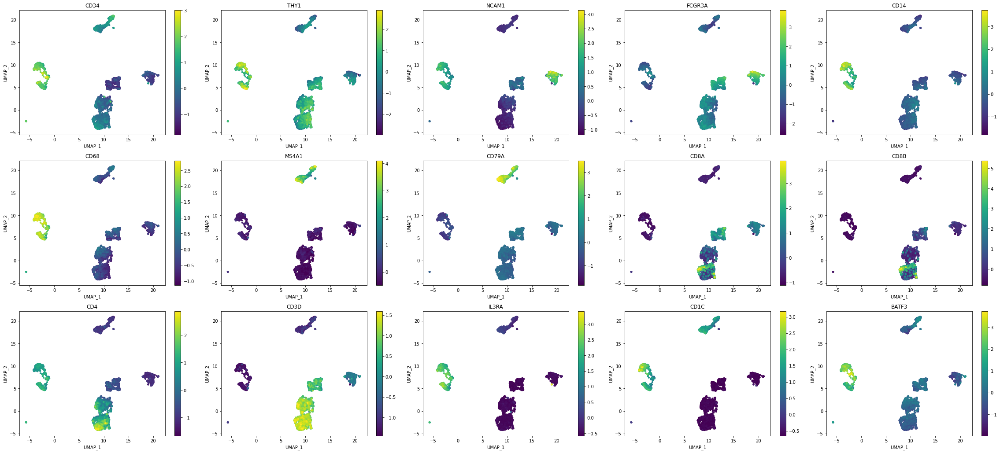

Broad_2


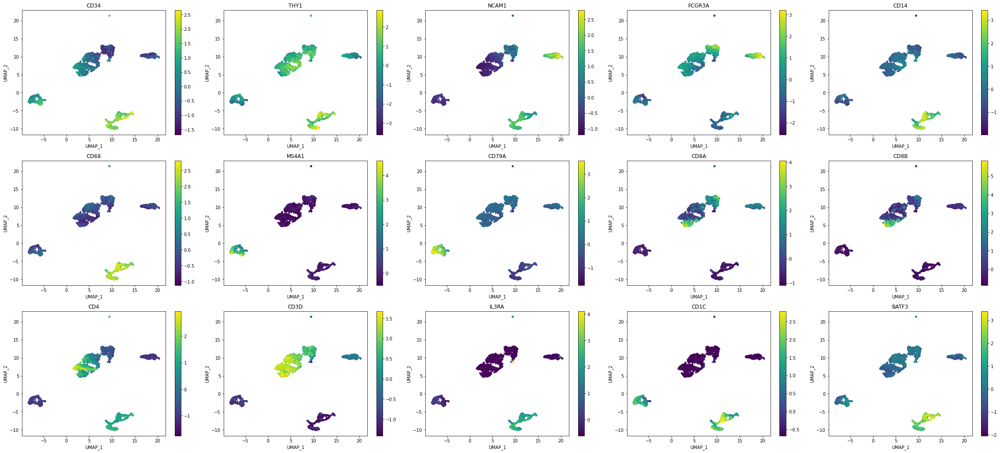

Broad_mito_1


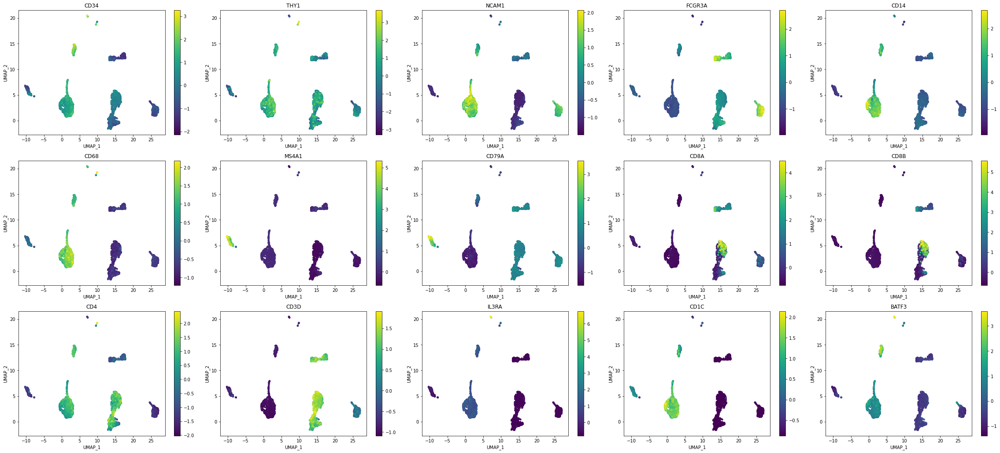

Broad_mito_2


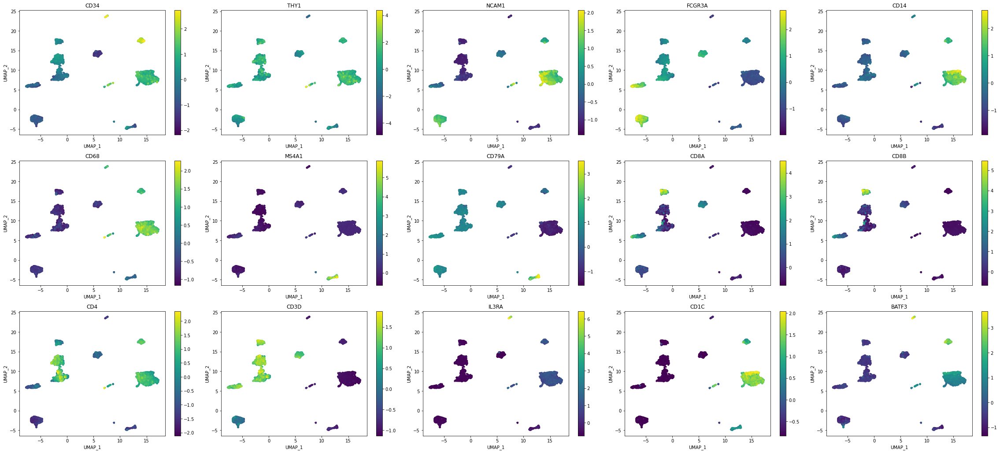

CNAG_1


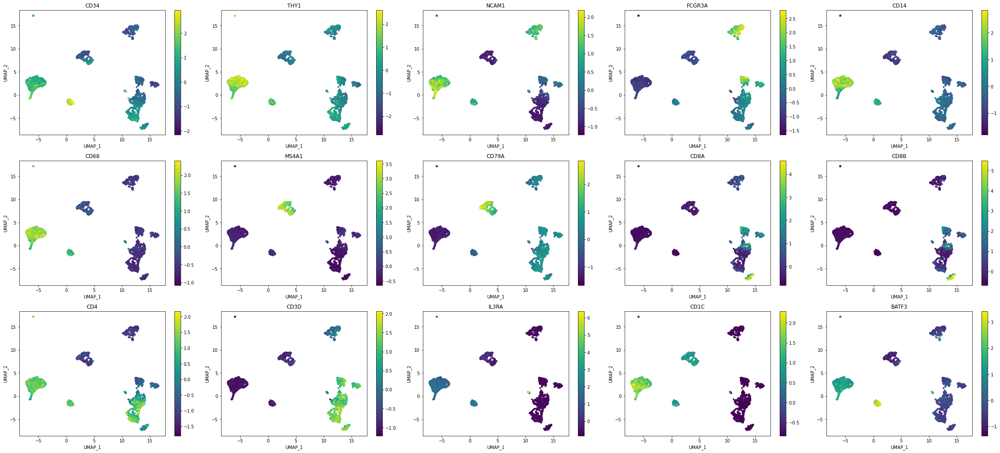

CNAG_2


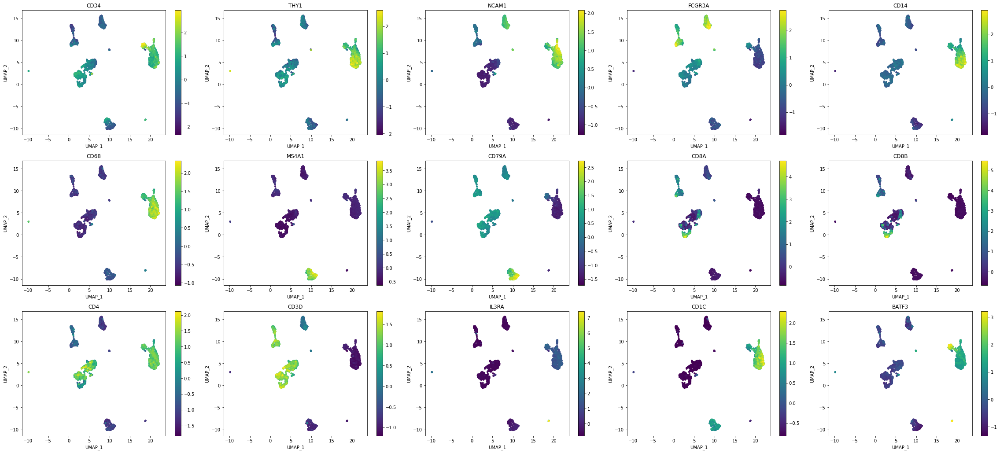

s3atac


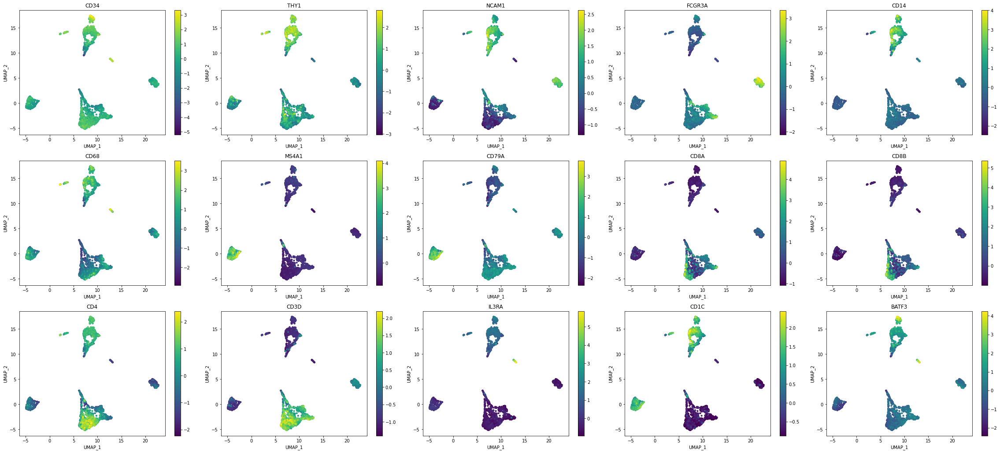

Sanger_1


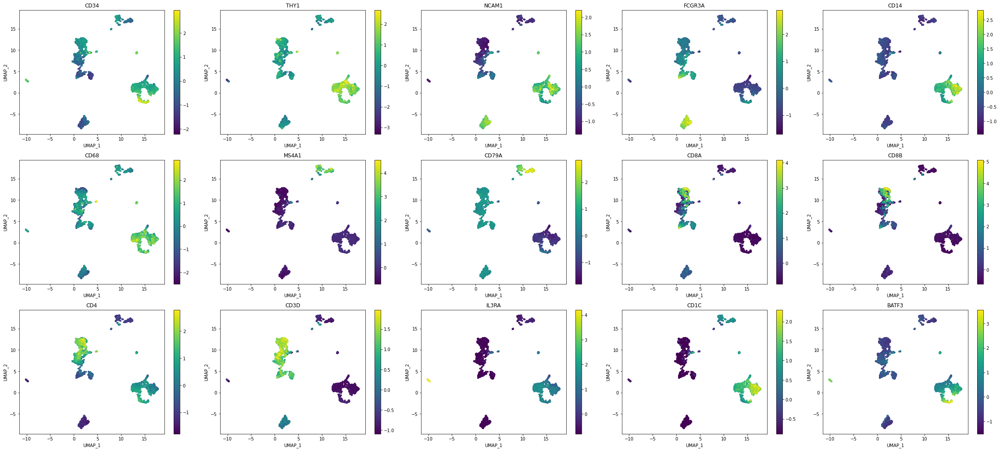

Sanger_2


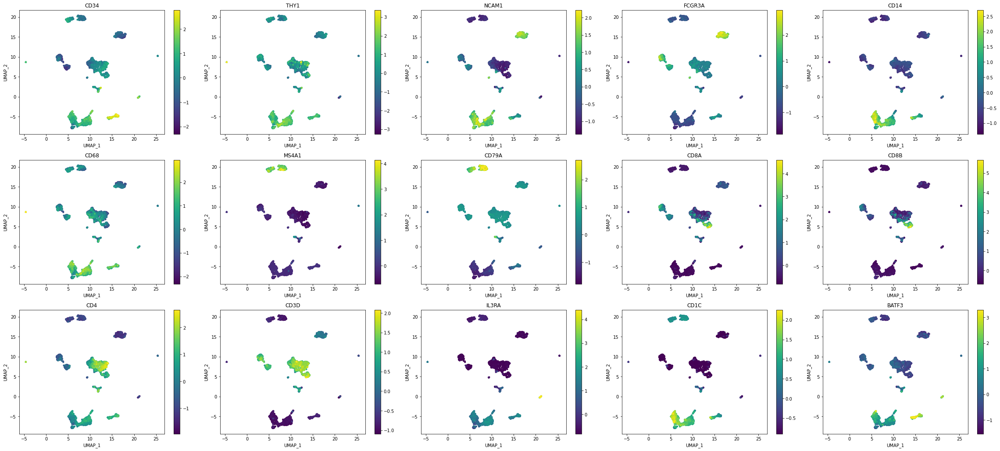

Stanford_1


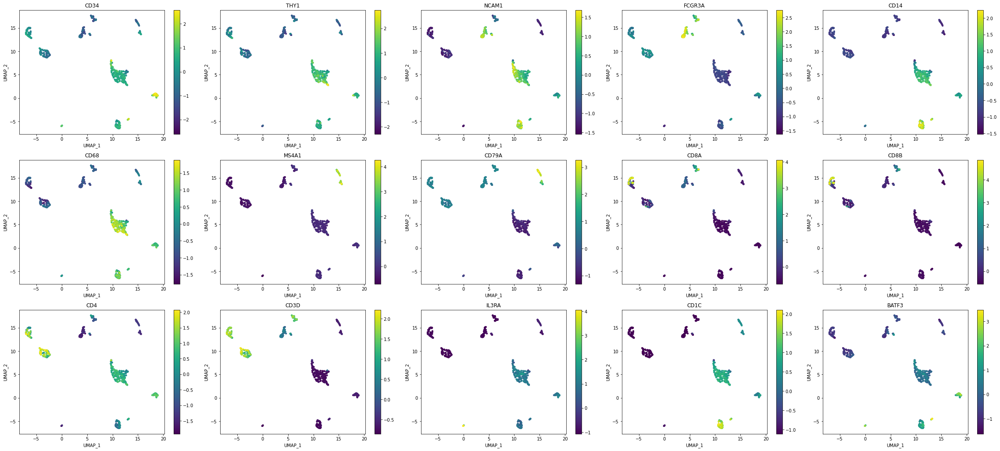

Stanford_2


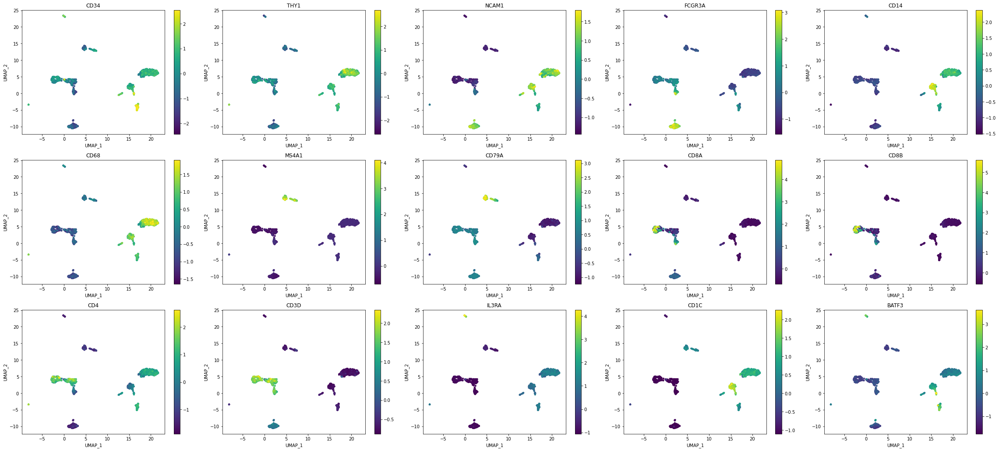

VIB_1


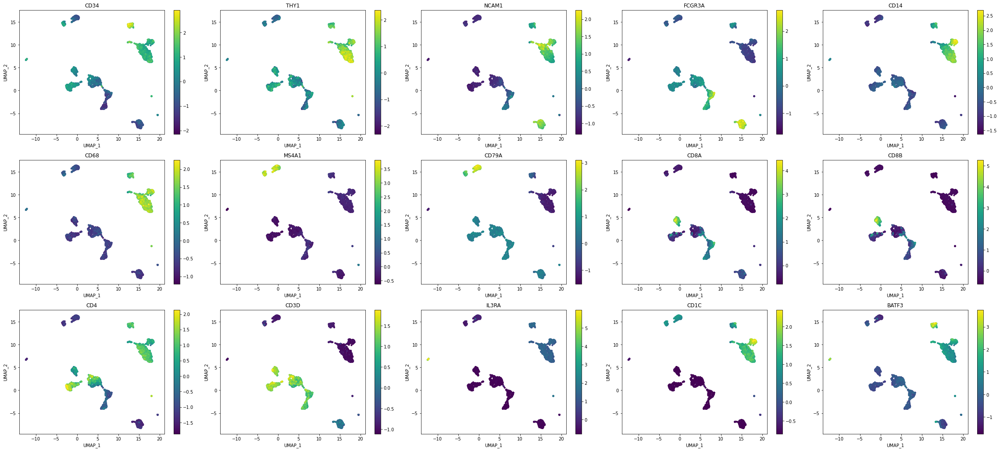

VIB_2


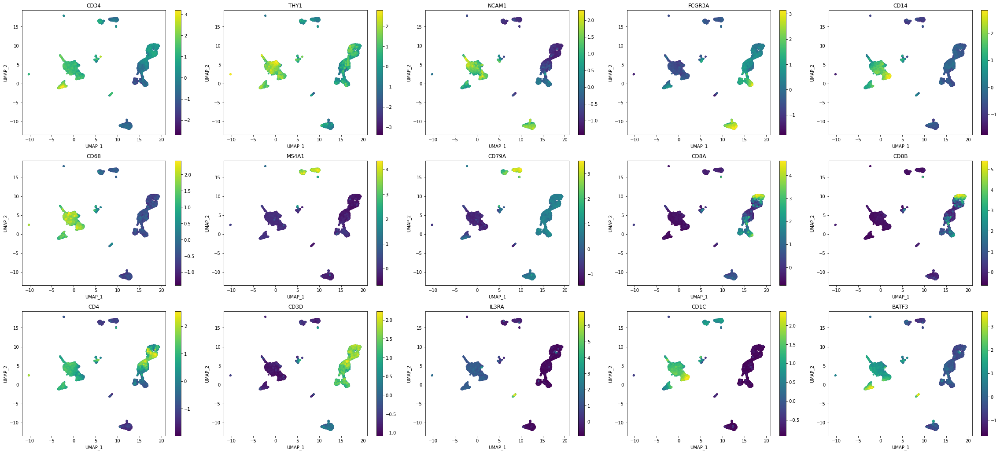

merged


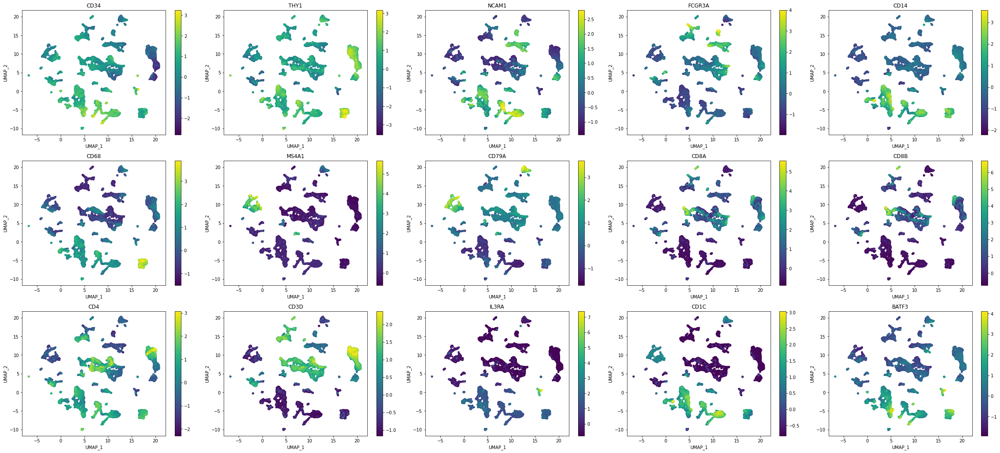

In [60]:
for key in cistopic_obj_dict.keys():
    print(key)
    plot_imputed_features(cistopic_obj_dict[key],
                    reduction_name='UMAP',
                    imputed_data=gene_act,
                    features=['CD34', 'THY1', # CD34+
                              'NCAM1', 'FCGR3A', # NK
                              'CD14', 'CD68', # Monocytes
                              'MS4A1', 'CD79A', # B cells
                              'CD8A', 'CD8B', # Cytotoxic CD8 cells
                              'CD4', # CD4 T
                              'CD3D', # T
                              'IL3RA', 'CD1C', 'BATF3', # Dendritic
                             ],
                    scale=True,
                    num_columns=5,
                    )

## Export to loom

In [61]:
# cistopic_obj_dict # ok
# imputed_acc_obj_dict # ok
# region_bin_topics #(region_bin_topics_dict) ok
# binarized_cell_topic # ok
# DARs_dict #(markers_dict_dict) ok

In [62]:
f_region_loom_dir = os.path.join(f_final_dir, 'region_acc_loom')
if not os.path.exists(f_region_loom_dir):
    os.makedirs(f_region_loom_dir)
    
f_gene_loom_dir = os.path.join(f_final_dir, 'gene_act_loom')
if not os.path.exists(f_gene_loom_dir):
    os.makedirs(f_gene_loom_dir)

### Region accessibility

In [63]:
from pycisTopic.loom import (
    export_region_accessibility_to_loom,
    export_gene_activity_to_loom
)

In [64]:
for key in cistopic_obj_dict.keys():
    print(key)
    s = 'merged' if key=='merged' else sample_annot.loc[key,'Sample']
    f_out = os.path.join(f_region_loom_dir, s + '__fulldata_region_accessibility.loom')
    if os.path.exists(f_out):
        print(f"Skipping {f_out}: already exists.")
        continue
    # Subset regions, we will use only regions in topics and DARs here to make it faster
    regions_in_topics = list(set(sum([region_bin_topics_dict[key][i].index.tolist() for i in region_bin_topics_dict[key].keys()],[])))
    regions_in_DARs = list(set(sum([markers_dict_dict[key][i].index.tolist() for i in markers_dict_dict[key].keys()],[])))
    # make sure we only take regions that actually exist in the accessibility matrix:
    selected_regions = list(set(regions_in_topics + regions_in_DARs).intersection(set(imputed_acc_obj_dict[key].feature_names)))

    # Export to loom
    export_region_accessibility_to_loom(
        accessibility_matrix = imputed_acc_obj_dict[key],
        cistopic_obj = cistopic_obj_dict[key], 
        binarized_topic_region = region_bin_topics_dict[key],
        binarized_cell_topic = binarized_cell_topic_dict[key],
        out_fname = f_out,
        selected_regions = selected_regions ,
        selected_cells = cistopic_obj_dict[key].projections['cell']['UMAP'].index.tolist(),
        cluster_annotation = ['consensus_cell_type'],
        cluster_markers = {'consensus_cell_type': markers_dict_dict[key]},
        tree_structure = ('scATAC-seq_Benchmark', 'ATAC_full_data', 'Region_accessibility'),
        title = s + ' - Region accessibility all',
        nomenclature = "hg38"
    )

Broad_1
2021-09-25 02:12:25,062 cisTopic     INFO     Creating minimal loom
Regulon name does not seem to be compatible with SCOPE. It should include a space to allow selection of the TF. 
Please run: 
 regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons] 
or:
 regulons = [r.rename(r.name.replace('(',' (')) for r in regulons]
2021-09-25 02:27:03,384 cisTopic     INFO     Adding annotations
2021-09-25 02:27:18,401 cisTopic     INFO     Adding clusterings
2021-09-25 02:27:18,441 cisTopic     INFO     Adding markers
2021-09-25 02:27:20,081 cisTopic     INFO     Exporting
Broad_2
2021-09-25 02:28:31,235 cisTopic     INFO     Creating minimal loom
Regulon name does not seem to be compatible with SCOPE. It should include a space to allow selection of the TF. 
Please run: 
 regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons] 
or:
 regulons = [r.rename(r.name.replace('(',' (')) for r in regulons]
2021-09-25 02:37:23,014 cisTopic 

### Gene activity

In [65]:
from ctxcore.genesig import Regulon

# generate a dummy regulon (required for export_gene_activity_to_loom):
phreg = Regulon(
        name='placeholder regulon',
        gene2weight={'phreg': 1.0},
        transcription_factor="phreg",
        gene2occurrence={"phreg": 1},
    )

In [66]:
for key in cistopic_obj_dict.keys():
    print(key)
    s = 'merged' if key=='merged' else sample_annot.loc[key,'Sample']
    f_out = os.path.join(f_gene_loom_dir, s + '__fulldata_gene_activity.loom')
    if os.path.exists(f_out):
        print(f"Skipping {key}: already exists.")
        continue
    export_gene_activity_to_loom(
        gene_activity_matrix = gene_act_dict[key],
        cistopic_obj = cistopic_obj_dict[key], 
        regulons = [phreg],
        selected_cells = cistopic_obj_dict[key].projections['cell']['UMAP'].index.tolist(),
        out_fname = f_out,
        cluster_annotation = ['consensus_cell_type'],
        cluster_markers = {'consensus_cell_type': markers_dict_dict[key]},
        tree_structure = ('scATAC-seq_Benchmark', 'ATAC_full_data', 'Gene_activity'),
        title = s + ' - Gene activity',
        nomenclature = "hg38"
    )

Broad_1
2021-09-26 17:45:37,540 cisTopic     INFO     Creating minimal loom
2021-09-26 17:45:48,594 ctxcore.recovery WARNING  Less than 80% of the genes in placeholder regulon are present in the expression matrix.
2021-09-26 17:46:08,770 cisTopic     INFO     Adding annotations
2021-09-26 17:46:12,136 cisTopic     INFO     Adding clusterings
2021-09-26 17:46:12,168 cisTopic     INFO     Adding markers
2021-09-26 17:46:12,403 cisTopic     INFO     Exporting
Broad_2
2021-09-26 17:46:29,507 cisTopic     INFO     Creating minimal loom
2021-09-26 17:46:42,154 ctxcore.recovery WARNING  Less than 80% of the genes in placeholder regulon are present in the expression matrix.
2021-09-26 17:47:01,622 cisTopic     INFO     Adding annotations
2021-09-26 17:47:04,932 cisTopic     INFO     Adding clusterings
2021-09-26 17:47:04,957 cisTopic     INFO     Adding markers
2021-09-26 17:47:05,143 cisTopic     INFO     Exporting
Broad_mito_1
2021-09-26 17:47:21,719 cisTopic     INFO     Creating minimal lo

## Signature enrichment